<a href="https://colab.research.google.com/github/pavi-rajes/BiogearsSRC/blob/master/LinearDecoder.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Written by Pavithra Rajeswaran for Jeev Data Analysis in Oct 2020 

Location of the dataset: /Volumes/GoogleDrive/Shared drives/aoLab/Data/bmiLearning_jeev

#Background

## Research Questions:
**Main Purpose**: To identify whether a simple linear decoder can distinguish between the weightage given to direct and indirect neurons to decide the outcome of a trial. 

**Motivation:**
This fits into the overall research theme of studying the neural mechanisms of BCI learning by identifying whether direct neurons are identified as a part of neural learning. 

**Expected Outcome:** From the neural data, the prediction power of the model should increase with direct neurons alone. Prediction power of the model even though initially might depend on indirect neurons, should eventually decrease with the inclusion of indirect neurons. 


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
import os
os.getcwd()

'/content'

In [4]:
# @title Import Functions

import os
import sys
import pandas as pd
from IPython.display import display, HTML

import matplotlib as m
%matplotlib inline
from IPython.display import set_matplotlib_formats

from scipy import io
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import h5py

# Versions used
print('Python: {}.{}.{}'.format(*sys.version_info[:3]))
print('Numpy: {}'.format(np.__version__))
print('Matplotlib: {}'.format(m.__version__))
print('Seaborn: {}'.format(sns.__version__))
print('Pandas: {}' .format(pd.__version__))
#


Python: 3.6.9
Numpy: 1.18.5
Matplotlib: 3.2.2
Seaborn: 0.11.0
Pandas: 1.1.5


In [5]:
# @title Figure settings
set_matplotlib_formats('png', 'pdf') # image rendering formats - generates high resolution images 

pd.set_option('display.max_rows',500) # Pandas DataFrame max rows to be displayed and max columns to be displayed
pd.set_option('display.max_columns',500)
font = {'family' : 'sans-serif',
        'weight' : 'normal',
        'size'   : 14}

m.rc('font', **font) #Specify the font parameters to use in matplotlib 

sns.set(color_codes=True) # Seaborn settings and choosing a colorblind friendly format
sns.set_style("whitegrid")
sns.set_context('paper')
sns.set_palette("colorblind")

%config InlineBackend.figure_format = 'retina'
plt.style.use("https://raw.githubusercontent.com/NeuromatchAcademy/course-content/master/nma.mplstyle")

# Data Loading

Data we need:


1.   Neural activity: (Neurons x time x trial) 
      - direct and indirect neuron activity
2.   Trial outcome
     - whether the trial ended in a reward or not 
     - decoding reach direction from the neural activity just after go cue


   

In [6]:
# @title Functions - Data Loading (RUN ME!!)

def load_HDF(filename,print_keys= True):
    with h5py.File(filename,"r") as f:
        if print_keys:
            print("Keys: %s" %f.keys())
        data = {}

        for key_id in range(len(f.keys())):
            var_suffix = list(f.keys())[key_id]
            data[var_suffix] = list(f[var_suffix])
    return data

In [7]:
# Load Neural Data 

# local_path = '/Volumes/GoogleDrive/Shared drives/aoLab/Data/bmiLearning_jeev'
# f_neural = '/content/drive/Shared drives/aoLab/Data/bmiLearning_jeev/jeev070412_072012/catNeuralDat_jeev070412_072012_trE7_B100.mat'
f_neural = '/content/drive/Shared drives/aoLab/Data/bmiLearning_jeev/jeev070412_072012/catNeuralDat_jeev070412_072012_trE5_B100.mat'
#f_neural = '/content/drive/Shared drives/aoLab/Data/bmiLearning_jeev/jeev072312_080412/catNeuralDat_jeev072312_080412_trE5_B100.mat'
data_neural = load_HDF(f_neural,True)

Keys: <KeysViewHDF5 ['#refs#', 'N_bmi', 'N_mc', 'N_norm_bmi', 'N_vfb', 'binvector', 'bmiDay', 'bmiDecoderInd', 'bmiDecoders', 'bmiSessions', 'bmiUnitInds', 'bmiUnitInds_all', 'bmiUnits', 'bmiUnits_all', 'day', 'days', 'mFRs', 'mcDay', 'mcSessions', 'params', 'sdFRs', 'sessID_bmi', 'sessID_mc', 'sessID_vfb', 'sessions', 'trEs_bmi', 'trEs_mc', 'trEs_vfb', 'trTs_bmi', 'trTs_mc', 'trTs_vfb', 'vfbDay', 'vfbSessions']>


In [8]:
tr_T = np.squeeze(data_neural['trTs_bmi'])
print(tr_T.shape)


(8, 13403)


In [9]:
# Trial outcome 
tr_E = np.squeeze(data_neural['trEs_bmi'])

tr_outcome = tr_E[6,:].squeeze() ### Change based on the input file  5 for tr_E7 ; 6 fot tr_E5
print(tr_E.shape)
print(tr_E[:,187])
print(tr_T[:,187])
print(tr_outcome)

(8, 13403)
[ 2. 66. 15.  5.  6.  7.  9. 11.]
[261.833975 261.835    263.175925 263.4261   263.47215  272.1292
 272.37935  273.480125]
[2. 2. 2. ... 9. 9. 9.]


In [10]:
target_direction = tr_E[1,:].squeeze() - 63
print(target_direction.shape)

(13403,)


Center-out task event codes:

    2 = center target appears
    15 = cursor/hand enters the center target
    5  = go-cue, telling the subject to start reaching
    6 = cursor/hand leaves the center target
    7 = cursor/hand enters the peripheral target
    9 = reward turns on
    11 = trial is over
    64-71 = code to note which target is being presented
 
 (64 = target 1; 71 = target 8. Targets are numbered  counter-clockwise  starting with 3 o'clock).
 
    4 = error holding at the center (i.e. cursor/hand left before the go-cue)
    8 = error holding at the peripheral target (i.e. cursor/hand left before designated hold-time elapsed)
    12 = reach time-out error (didn't reach peripheral target in time)
    4101 = task was stopped or paused (will always be one of these at the end. Occasionally some occur mid-file because the animal had difficulty with a particular trial, and pausing skips a trial.)
 
The typical sequence for a successful trial is:   
    2    targCode     15    5    6    7    9    11 

In [11]:
np.unique(tr_outcome)

# Let us remove the trails that are incomplete or doesnot belong to this current trial 

filter_trial_idx = np.where((tr_outcome==8.0) | (tr_outcome == 9.0))

new_tr_E = tr_E[:,filter_trial_idx].squeeze()
new_tr_T = tr_T[:,filter_trial_idx].squeeze()
new_tr_outcome = tr_outcome[filter_trial_idx]
target_direction = target_direction[filter_trial_idx]
print(new_tr_E.shape, new_tr_T.shape, new_tr_outcome.shape, target_direction.shape)

(8, 12757) (8, 12757) (12757,) (12757,)


## Segregating Direct and indirect neurons from the raw data

In [12]:
# Segregating Direct and Indirect neuron

neuron_idx = np.squeeze(data_neural['bmiUnitInds'])
#neuron_idx = np.reshape(neuron_idx,20)
print(np.shape(neuron_idx))

bmi_day = np.squeeze(data_neural['bmiDay'])
print(np.shape(bmi_day))

bmi_decoder_idx = np.squeeze(data_neural['bmiDecoderInd'])
print(np.shape(bmi_decoder_idx))


(20,)
(43,)
(43,)


In [13]:
# import decoder params

#f_decParams = '/Volumes/GoogleDrive/Shared drives/aoLab/Data/bmiLearning_jeev/jeev070412_072012/decoderParams_jeev070412_072012.mat'
f_decParams = '/content/drive/Shared drives/aoLab/Data/bmiLearning_jeev/jeev070412_072012/decoderParams_jeev070412_072012.mat'
decoder_params = load_HDF(f_decParams,False)
print(decoder_params.keys())

bmi_units_decoder = np.squeeze(decoder_params['usedUnit_decoder'])
print(bmi_units_decoder.shape)

del decoder_params

dict_keys(['#refs#', 'H_MDp', 'H_MDv', 'H_PDp', 'H_PDv', 'Hs', 'K_MDp', 'K_MDv', 'K_PDp', 'K_PDv', 'Ks', 'Qs', 'bmiDay', 'bmiDecoderInd', 'bmiUnitInds', 'bmiUnitInds_all', 'bmiUnits', 'bmiUnits_all', 'sb', 'usedUnit_day', 'usedUnit_day_clean', 'usedUnit_decoder'])
(20, 6)


In [14]:
bmi_n_data = np.array(data_neural['N_bmi'])
print(len(bmi_n_data))

# bmi_data = np.array(data_neural['N_bmi'])
# print(len(bmi_data))

sess_ID = np.squeeze(data_neural['sessID_bmi'])
#sess_ID = np.reshape(sess_ID,13403)
print(np.shape(sess_ID))

13403
(13403,)


In [15]:
del data_neural

In [16]:
# Adjusting for Matlab- Python variation 
print(neuron_idx)

neuron_idx = neuron_idx-1
print(neuron_idx)

[ 51.  52.  86. 106. 141. 181. 186. 216. 226. 266. 301. 356. 396. 441.
 521. 546. 591. 596. 611. 636.]
[ 50.  51.  85. 105. 140. 180. 185. 215. 225. 265. 300. 355. 395. 440.
 520. 545. 590. 595. 610. 635.]


In the data acquisition, there were 128 channels. The spike sorting software could sort spike into 5 sub channels in which the first 4 sub channels have sorted spikes and the 5th channels is a dump of unsorted data which crossed threshold. This can be assumed to be noise and we are not interested in that. Hence, we will filter it out.

- Only Direct Neurons used across all decoders: bmi_units_allD 
- Direct Neurons including all units that are used at least in one decoder - neuron_idx
- Only indirect neurons - indirect_neuron_idx
- Direct + Indirect neurons - all_neuron_idx_not5

## Reach time analysis 

[0.653475 2.875    7.423175 ... 0.749525 7.0299   2.90805 ]


Text(0, 0.5, 'Trial distribution')

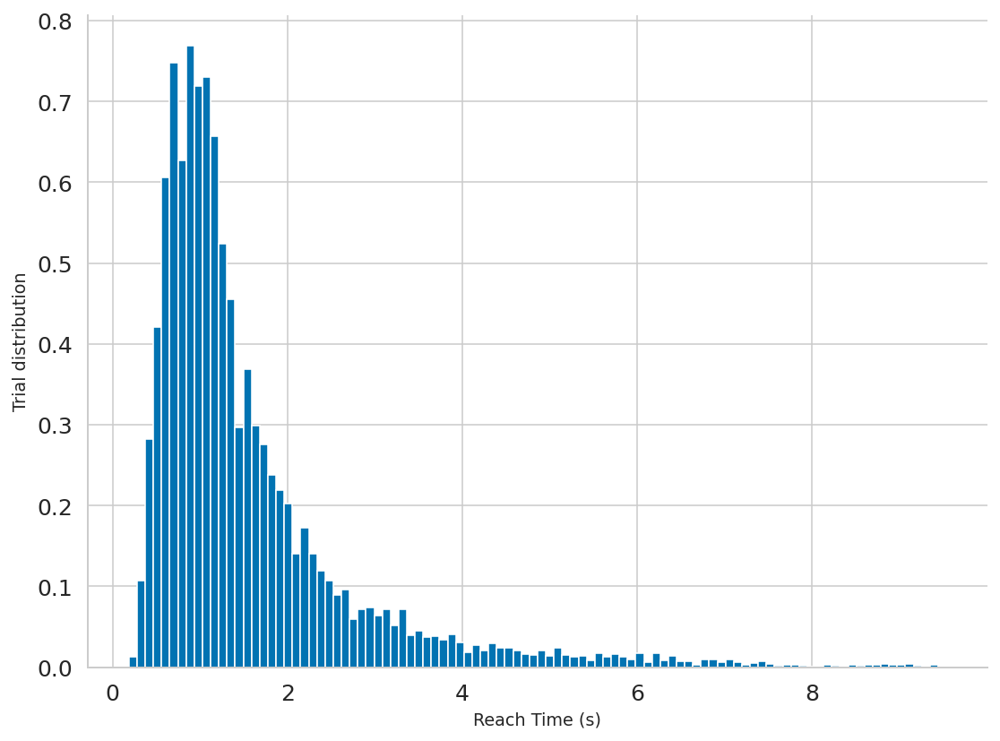

In [17]:
# Compute reach time
reach_time = new_tr_T[5,:]- new_tr_T[3,:]
print(reach_time)

plt.figure()
plt.hist(reach_time, 100, density = True)
plt.xlabel('Reach Time (s)')
plt.ylabel('Trial distribution')

In [ ]:
import plotly.express as px

fig = px.line(x=np.arange(reach_time.shape[0]),y=reach_time,  labels={'x':'Trials', 'y':'Reach Time (s)'})
fig.show()

In [ ]:
rt = pd.DataFrame({'Reach_time': reach_time})

rt['SMA'] = rt.iloc[:,0].rolling(window=10).mean()



Text(0, 0.5, 'Reach Time (s)')

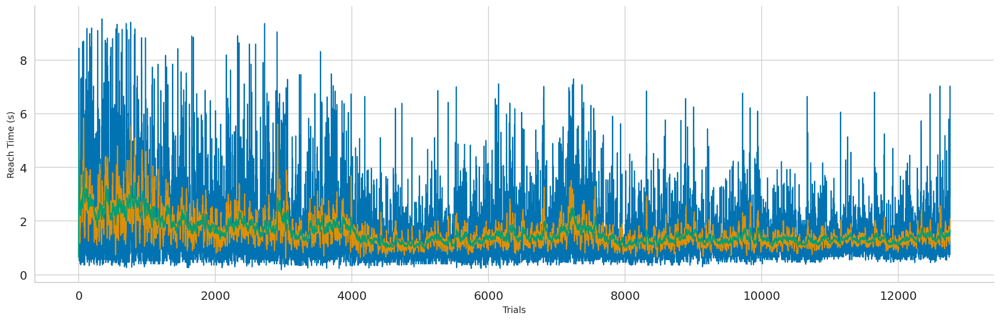

In [ ]:
rt['EWM']= rt.iloc[:,0].ewm(span = 60, adjust = True).mean()

plt.figure(figsize= (15,5))
plt.plot(rt['Reach_time'])
plt.plot(rt['SMA'])
plt.plot(rt['EWM'])
plt.xlabel('Trials')
plt.ylabel('Reach Time (s)')

In [ ]:
print(rt)
rt.to_csv('reach_times.csv')

       Reach_time       SMA       EWM
0        0.653475       NaN  0.653475
1        2.875000       NaN  1.782750
2        7.423175       NaN  3.725906
3        0.766550       NaN  2.948671
4        8.438900       NaN  4.121119
...           ...       ...       ...
12752    2.096425  1.449010  1.488654
12753    0.984700  1.420790  1.472131
12754    0.749525  1.388267  1.448439
12755    7.029900  1.981885  1.631437
12756    2.908050  2.080455  1.673294

[12757 rows x 3 columns]


In [ ]:
del rt

## Direct Indirect n_bmi data

In [18]:
## Direct neurons - Category 1 
def get_direct_indirect_idx(bmi_n_data, neuron_idx, bmi_units_decoder):
  bmi_units_allD_idx = np.all((bmi_units_decoder == 1), axis=1)
  # print(bmi_units_allD_idx)
  bmi_units_allD = neuron_idx[bmi_units_allD_idx]
  # print(bmi_units_allD)

  ## Filter the data in neuron dimension to remove 5th channel which contains all unsorted units from each electrode. Resulting neurons would be 640 - 128 = 512 
  # print(bmi_n_data.shape[1])
  not5 = np.ones(bmi_n_data.shape[1])
  # print(not5.shape)
  for i in range(128):
    not5[(i*5)-1] = 0
  indirect_inds_not5 = np.squeeze(np.nonzero(not5))
  # print(indirect_inds_not5.shape)

  ## Filter the neural data to get only the channels with neural recordings in the neuron dimension 
  filtered_recording = np.squeeze(np.where(bmi_n_data != 0))
  # print(filtered_recording[1].shape)
  # print(filtered_recording)
  all_neuron_idx = np.unique(filtered_recording[1])
  # print(all_neuron_idx)
  # print(all_neuron_idx.shape)

  all_neuron_not5 = np.in1d(all_neuron_idx,indirect_inds_not5)
  # print(all_neuron_not5)
  all_neuron_idx_not5 = all_neuron_idx[all_neuron_not5]
  # print(all_neuron_idx_not5.shape)

  ## Getting index of just the indirect neurons 
  # print(neuron_idx)
  # print(neuron_idx.shape)
  # print(all_neuron_idx_not5.shape)
  temp = ~np.in1d(all_neuron_idx_not5,neuron_idx)
  # print(temp)
  indirect_neuron_idx = np.squeeze(all_neuron_idx_not5[temp]).astype(int)
  # print(indirect_neuron_idx)
  # print(indirect_neuron_idx.shape)

  direct_neuron_allD_idx = bmi_units_allD.astype(int)
  direct_neuron_bmiunit_idx = neuron_idx.astype(int)
  direct_indirect_neuron_idx = all_neuron_idx_not5.astype(int)

  return direct_neuron_allD_idx, direct_neuron_bmiunit_idx, indirect_neuron_idx, direct_indirect_neuron_idx

In [19]:
direct_idx_1, direct_idx_2, indirect_idx, direct_indirect_idx = get_direct_indirect_idx(bmi_n_data, neuron_idx, bmi_units_decoder)

print(direct_idx_1)
print(direct_idx_2)
print(indirect_idx)
print(direct_indirect_idx)

[ 85 105 225 265 300 395 440 520 545 590 595 635]
[ 50  51  85 105 140 180 185 215 225 265 300 355 395 440 520 545 590 595
 610 635]
[  5   6  10  15  20  21  45  55  75  95 100 106 120 145 175 176 181 195
 196 210 220 221 230 235 236 240 260 270 271 275 276 305 310 311 315 320
 325 335 336 340 345 356 360 365 370 480 530 531 535 536 540 546 550 560
 605 615 625 630]
[  5   6  10  15  20  21  45  50  51  55  75  85  95 100 105 106 120 140
 145 175 176 180 181 185 195 196 210 215 220 221 225 230 235 236 240 260
 265 270 271 275 276 300 305 310 311 315 320 325 335 336 340 345 355 356
 360 365 370 395 440 480 520 530 531 535 536 540 545 546 550 560 590 595
 605 610 615 625 630 635]


In [20]:
# filter_trial_idx = np.squeeze(filter_trial_idx)

# bmi_direct1 = bmi_n_data[:,direct_idx_1,:][filter_trial_idx,:,:]
# print(bmi_direct1.shape)

# bmi_direct2 = bmi_n_data[:,direct_idx_2,:][filter_trial_idx,:,:]
# print(bmi_direct2.shape)

# bmi_indirect = bmi_n_data[:,indirect_idx,:][filter_trial_idx,:,:]
# print(bmi_indirect.shape)

# bmi_direct_indirect = bmi_n_data[:,direct_indirect_idx,:][filter_trial_idx,:,:]
# print(bmi_direct_indirect.shape)

filter_trial_idx = np.squeeze(filter_trial_idx)

bmi_direct1 = bmi_n_data[:,direct_idx_1,:]
print(bmi_direct1.shape)

bmi_direct2 = bmi_n_data[:,direct_idx_2,:]
print(bmi_direct2.shape)

bmi_indirect = bmi_n_data[:,indirect_idx,:]
print(bmi_indirect.shape)

bmi_direct_indirect = bmi_n_data[:,direct_indirect_idx,:]
print(bmi_direct_indirect.shape)

bmi_direct_indirect_stacked = np.hstack((bmi_direct2, bmi_indirect))
print(bmi_direct_indirect_stacked.shape)

(13403, 12, 40)
(13403, 20, 40)
(13403, 58, 40)
(13403, 78, 40)
(13403, 78, 40)


## Segregate by Day  - Normalize with daily mean and variance 


In [21]:
len(sess_ID)
sess_ID[0]

1.0

In [22]:
#@title Functions - Data preprocessing (RUN ME!!!)

## Functions for Renormalizing every day Mean 
def get_trial_by_day(sess_ID,day):
  data_day = {}
  for i in range(len(sess_ID)):

    data_day[day[sess_ID[i].astype(int)-1].astype(int)] = i

  print(data_day)
  return data_day

def getdata_day(data,id,data_day):
  if id == 1:
    var_name = data[0:data_day[id]+1,:,:]
  else:
    var_name = data[data_day[id-1]:data_day[id],:,:]
  return var_name

def zero_mean_daily(data):
  #print(d1.shape)
  data_m=[]
  d_mean = np.squeeze(data.mean((0,2,)))
  #print(d_mean)
  data1 = np.moveaxis(data,1,0)
  #print(data1.shape)
  
  for i in range(len(d_mean)):
    data_m.append([data1[i] - d_mean[i]])

  data_m = np.squeeze(np.array(data_m))
  #print(data_m.shape)
  data_m = np.moveaxis(np.array(data_m),1,0)
  #print(data_m.shape)
  return data_m

def z_score_day(data):
  data_z = []
  data_m = zero_mean_daily(data)
  d_std = np.squeeze(data.std((0,2,)))

  data1 = np.moveaxis(data_m,1,0)
  #print(data1.shape)
  
  for i in range(len(d_std)):
    data_z.append([data1[i] / d_std[i]])

  data_z = np.squeeze(np.array(data_z))

  data_z = np.moveaxis(np.array(data_z),1,0)

  return data_z

In [23]:
data_day = get_trial_by_day(sess_ID, bmi_day )

{1: 66, 2: 1015, 3: 1706, 4: 2736, 5: 3484, 6: 3804, 7: 4898, 8: 5954, 9: 7270, 10: 8086, 11: 9202, 12: 9963, 13: 10991, 14: 11430, 15: 12293, 16: 12690, 17: 13402}


In [24]:
def renormalize_daily(bmi_n_data,data_day):
  # seperate data by day
  d1 = getdata_day(bmi_n_data,1,data_day)
  # print(d1.shape)

  d2 = getdata_day(bmi_n_data,2,data_day)
  # print(d2.shape)

  d3 = getdata_day(bmi_n_data,3, data_day)
  d4 = getdata_day(bmi_n_data,4, data_day)
  d5 = getdata_day(bmi_n_data,5, data_day)
  d6 = getdata_day(bmi_n_data,6, data_day)
  d7 = getdata_day(bmi_n_data,7, data_day)
  d8 = getdata_day(bmi_n_data,8, data_day)
  d9 = getdata_day(bmi_n_data,9, data_day)
  d10 = getdata_day(bmi_n_data,10, data_day)
  d11 = getdata_day(bmi_n_data,11, data_day)
  d12 = getdata_day(bmi_n_data,12, data_day)
  d13 = getdata_day(bmi_n_data,13, data_day)
  d14 = getdata_day(bmi_n_data,14, data_day)
  d15 = getdata_day(bmi_n_data,15, data_day)
  d16 = getdata_day(bmi_n_data,16, data_day)
  d17 = getdata_day(bmi_n_data,17, data_day)

  # find daily mean 
  d1_m = zero_mean_daily(d1)
  #print(d1_m)
  d2_m = zero_mean_daily(d2)
  d3_m = zero_mean_daily(d3)
  d4_m = zero_mean_daily(d4)
  d5_m = zero_mean_daily(d5)
  d6_m = zero_mean_daily(d6)
  d7_m = zero_mean_daily(d7)
  d8_m = zero_mean_daily(d8)
  d9_m = zero_mean_daily(d9)
  d10_m = zero_mean_daily(d10)
  d11_m = zero_mean_daily(d11)
  d12_m = zero_mean_daily(d12)
  d13_m = zero_mean_daily(d13)
  d14_m = zero_mean_daily(d14)
  d15_m = zero_mean_daily(d15)
  d16_m = zero_mean_daily(d16)
  d17_m = zero_mean_daily(d17)

  # Z score with daily mean and daily variance 

  d1_z = z_score_day(d1)
  #print(d1_z)
  d2_z = z_score_day(d2)
  d3_z = z_score_day(d3)
  d4_z = z_score_day(d4)
  d5_z = z_score_day(d5)
  d6_z = z_score_day(d6)
  d7_z = z_score_day(d7)
  d8_z = z_score_day(d8)
  d9_z = z_score_day(d9)
  d10_z = z_score_day(d10)
  d11_z = z_score_day(d11)
  d12_z = z_score_day(d12)
  d13_z = z_score_day(d13)
  d14_z = z_score_day(d14)
  d15_z = z_score_day(d15)
  d16_z = z_score_day(d16)
  d17_z = z_score_day(d17)

  # Combine the individual day matrices to form the tensor 
  data_T_m = np.vstack([d1_m, d2_m,d3_m, d4_m,d5_m,d6_m,d7_m,d8_m,d9_m,d10_m,d11_m,d12_m,d13_m,d14_m,d15_m,d16_m,d17_m])
  print(data_T_m.shape)

  data_T_z = np.vstack([d1_z, d2_z,d3_z, d4_z,d5_z,d6_z,d7_z,d8_z,d9_z,d10_z,d11_z,d12_z,d13_z,d14_z,d15_z,d16_z,d17_z])

  data_T = np.moveaxis(data_T_z,2,0)
  print(np.shape(data_T)) # time X trials X neurons 

  return data_T_m, data_T_z, data_T

In [ ]:
dir1_m, dir1_z, dir1 = renormalize_daily(bmi_direct1,data_day)

print(dir1_m.shape, dir1.shape)
dir1_m = dir1_m[filter_trial_idx,:,:]
dir1_z = dir1_z[filter_trial_idx,:,:]

print(dir1_m.shape, dir1_z.shape)

(13403, 12, 40)
(40, 13403, 12)
(13403, 12, 40) (40, 13403, 12)
(12757, 12, 40) (12757, 12, 40)


In [ ]:
dir2_m, dir2_z, dir2 = renormalize_daily(bmi_direct2,data_day)

dir2_m = dir2_m[filter_trial_idx,:,:]
dir2_z = dir2_z[filter_trial_idx,:,:]

(67, 20, 40)
(949, 20, 40)


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:46: RuntimeWarning: invalid value encountered in true_divide


(13403, 20, 40)
(40, 13403, 20)


In [ ]:
indir_m, indir_z, indir = renormalize_daily(bmi_indirect,data_day)

indir_m = indir_m[filter_trial_idx,:,:]
indir_z = indir_z[filter_trial_idx,:,:]

(67, 58, 40)
(949, 58, 40)


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:46: RuntimeWarning: invalid value encountered in true_divide


(13403, 58, 40)
(40, 13403, 58)


In [ ]:
dir_indir_m, dir_indir_z, dir_indir = renormalize_daily(bmi_direct_indirect,data_day)

dir_indir_m = dir_indir_m[filter_trial_idx,:,:]
dir_indir_z = dir_indir_z[filter_trial_idx,:,:]

(67, 78, 40)
(949, 78, 40)


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:46: RuntimeWarning: invalid value encountered in true_divide


(13403, 78, 40)
(40, 13403, 78)


## Firing rate of neurons - PSTH 

In [ ]:
os.chdir('/content/drive/My Drive/Research/Jeev Data Analysis/Plots/TCA/DirectVsIndirect')
os.getcwd()

'/content/drive/My Drive/Research/Jeev Data Analysis/Plots/TCA/DirectVsIndirect'

In [ ]:
bin_vector = np.arange(-2.0, 1.9, 0.1)

In [64]:
# data = dir1_m[:,:,:38]
# label = 'direct_neurons'

def get_psth(data, label):
  n_neurons = np.shape(data)[1]
  n_trial = np.shape(data)[0]
  n_bins = np.shape(data)[2]

  psth = np.sum(data,axis = 0)

  fig = plt.figure(111, dpi = 300)
  plt.plot(psth.T)
  plt.axvline(x=20,linewidth=2.5, color='r')
  plt.xlabel('Time Bin')
  plt.ylabel('Count')
  plt.text(1,np.min(psth)-5,'No. of neurons: '+str(n_neurons))
  plt.title('PSTH '+ label)
  f_psth = 'PSTH_'+ label+ '.png'
  plt.savefig(f_psth)

  # fig = plt.figure(111, dpi = 300)
  # plt.hist(psth.T)

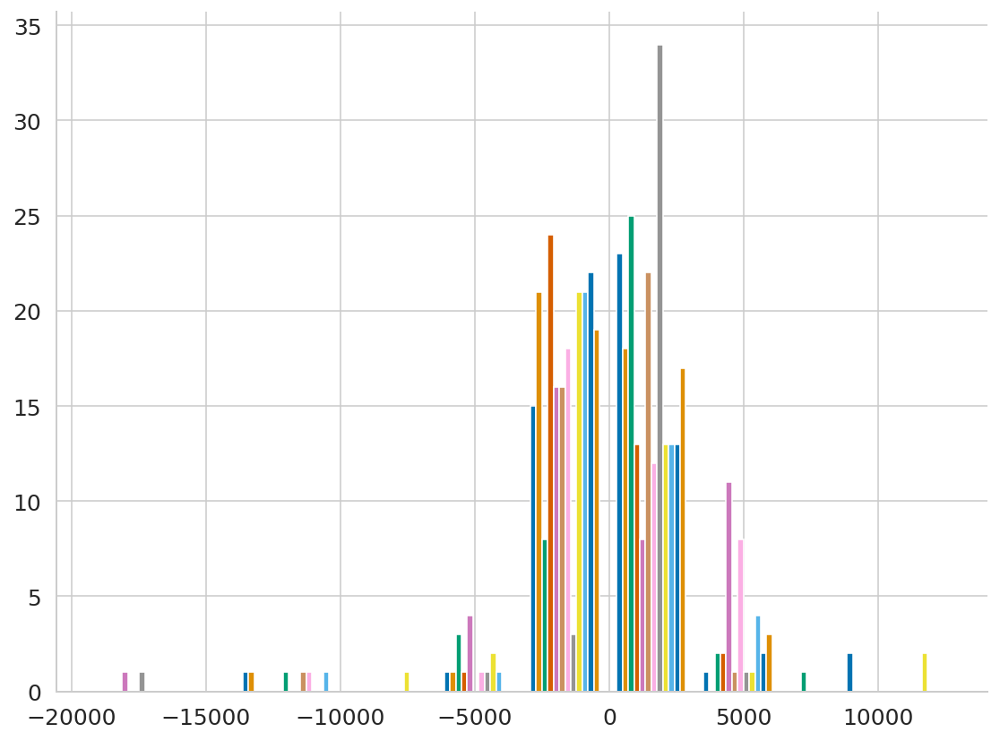

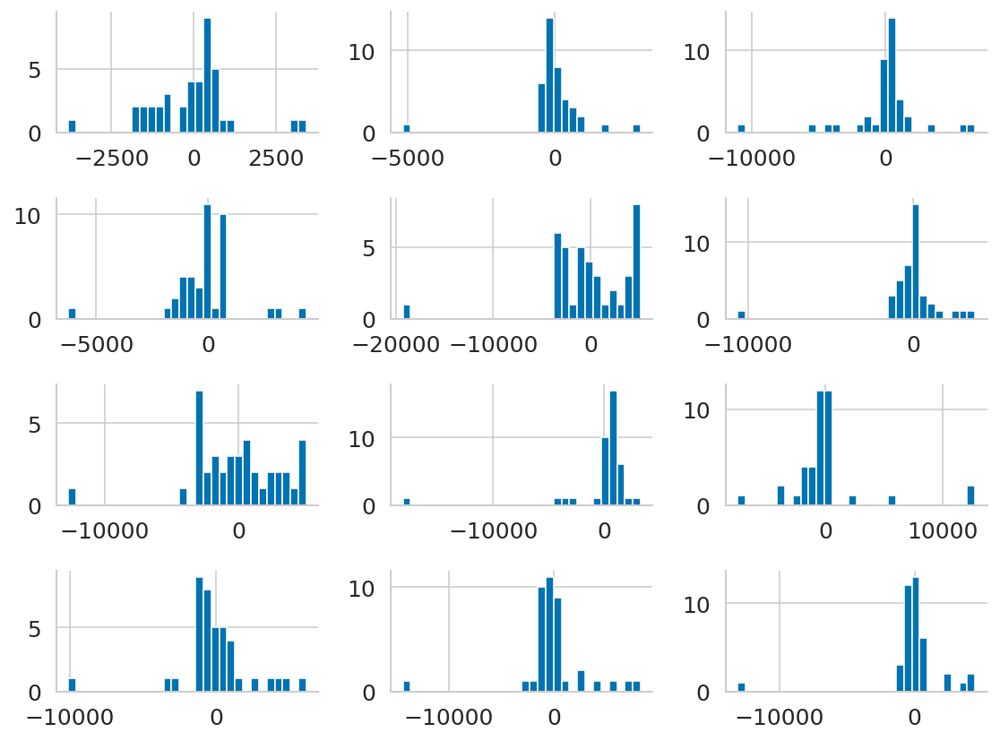

In [ ]:
# np.histogram(np.sum(bmi_direct1,axis = 0).T)

plt.figure()
plt.hist(np.sum(dir1_z,axis = 0).T, bins = 10, density = False)

plt.figure()
for i in range(12):
  plt.subplot(4,3,i+1)
  plt.hist(np.sum(dir1_z[:,i,:],axis = 0).T, bins = 30, density = False)

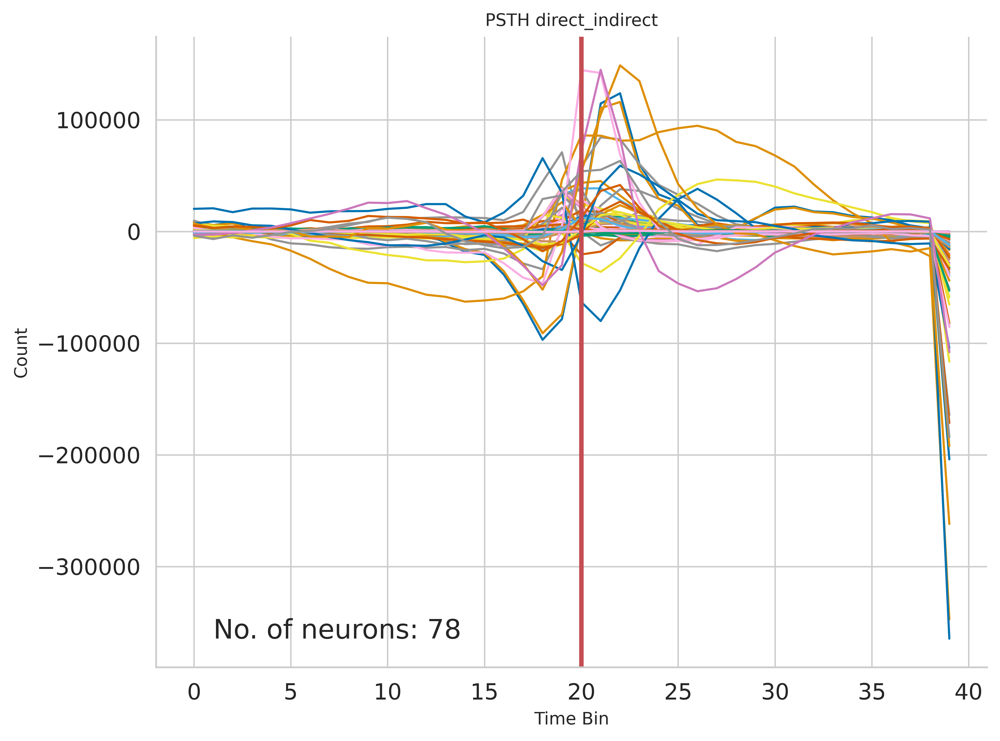

In [ ]:
get_psth(dir_indir_m, 'direct_indirect')



In [ ]:
print(data.shape)

data = np.moveaxis(np.array(data),2,0)
print(data.shape)

(12757, 12, 38)
(38, 12757, 12)


In [ ]:
def _plot_range_band(data,a):
  upper = data.max(axis=a)
  lower = data.min(axis=a)
  m = np.mean(data,a)
  return  m, lower, upper 

def plot_firing_profile(data,label_name):
  """
  input data should be of shape time x trials x neurons
  """
  t_bins = np.arange(0,np.shape(data)[0],1)
  m,l,u = _plot_range_band(data,1)
  print(np.shape(m),np.shape(l),np.shape(u))

  colors = sns.color_palette('colorblind',np.shape(m)[1])

  # plt.figure(figsize=(13,9))
  # for id in range(np.shape(m)[1]):
  #   ax = plt.subplot(4,3,id+1)
  #   plt.plot(t_bins,m[:,id],color = colors[id])
  #   plt.plot(t_bins,m[:,id], '*',color = colors[id])
  #   plt.xlabel('Time Bins | 1 bin = 100 ms')
  #   plt.ylabel('Firing Rate Hz')
  #   #plt.legend(np.arange(1, np.shape(m)[1]+1),loc='center left', bbox_to_anchor=(1.05, 0.5), ncol=1)
  #   plt.show
  #   plt.plot(t_bins,l[:,id],color = colors[id],alpha = 0.6)
  #   plt.plot(t_bins,u[:,id],color = colors[id], alpha = 0.6)
  #   ax.fill_between(t_bins,l[:,id],u[:,id],color = colors[id],alpha = 0.2)
  #   plt.title('BMI unit '+ str(bmi_units_allD[id]))
  # # sns.lineplot(t_bins,l)
  # # sns.lineplot(t_bins,u)
  # plt.tight_layout()
  # plt.savefig('FiringRate_subplots_'+ label_name+'.png')

  plt.figure(figsize=(13,9), dpi = 300)
  plt.plot(t_bins,m,linestyle='solid', marker='o')
  #plt.plot(t_bins,m, 'o')
  plt.xlabel('Time Bins | 1 bin = 100 ms')
  plt.ylabel('Firing Rate (Normalized) Hz')
  # plt.legend(bmi_units_allD.astype(int),loc='center left', bbox_to_anchor=(1.05, 0.5), ncol=1)
  plt.savefig('FiringRate_Mean_trial'+ label_name+'.png')

  x_tr = np.arange(0,np.shape(data)[1],1)
  m,l,u = _plot_range_band(data,0)
  print(np.shape(m),np.shape(l),np.shape(u))

  plt.figure(figsize=(15,7), dpi = 300)
  plt.plot(x_tr+1,m, marker='o')
  #plt.plot(t_bins,m, 'o')
  plt.xlabel('Trials')
  plt.ylabel('Firing Rate (Normalized) Hz')
  # plt.legend(bmi_units_allD.astype(int),loc='center left', bbox_to_anchor=(1.05, 0.5), ncol=1)
  plt.savefig('FiringRate_Mean_time'+ label_name+'.png')

In [ ]:
plot_firing_profile(data,'direct_neurons_1')

(38, 58) (38, 58) (38, 58)
(12757, 58) (12757, 58) (12757, 58)


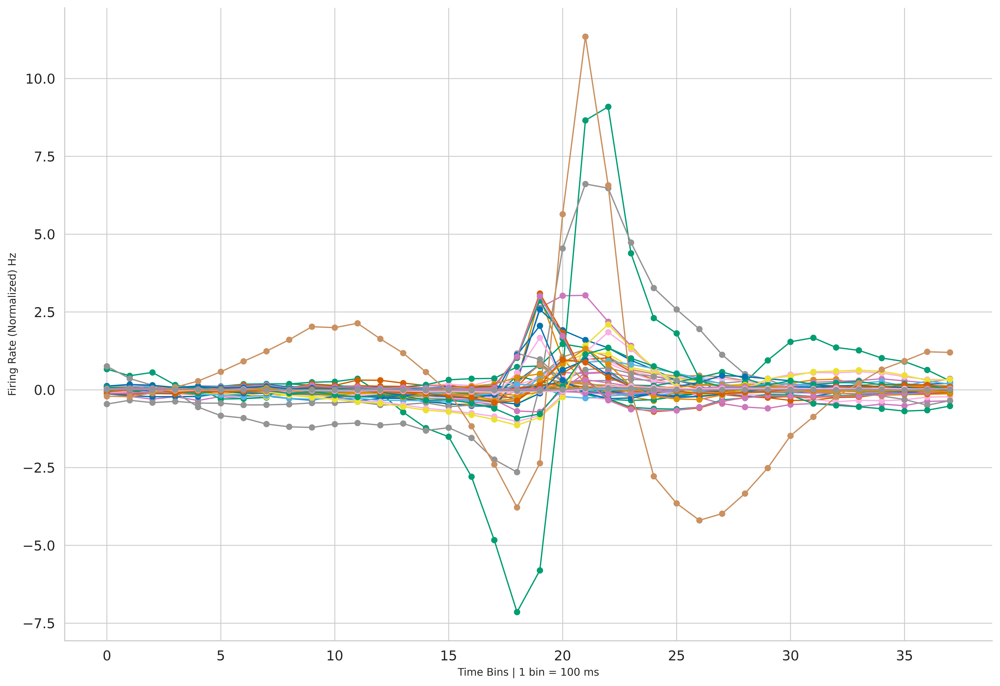

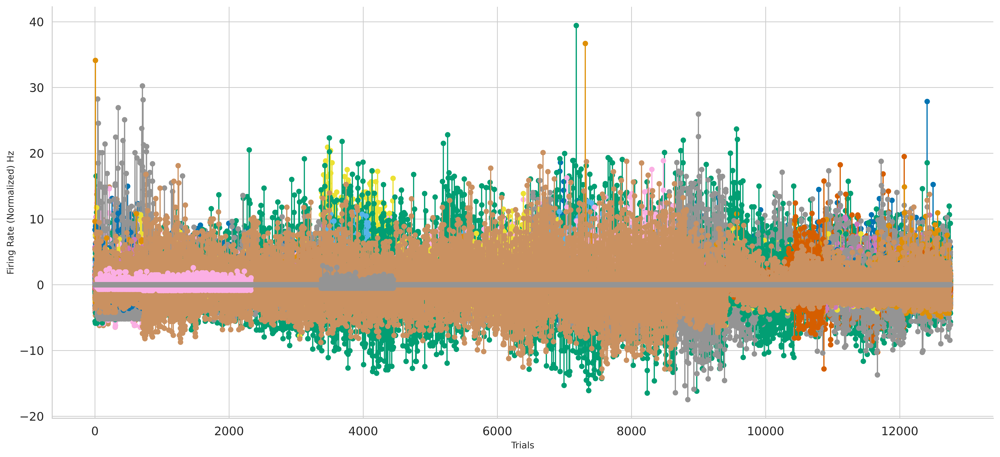

In [ ]:
data = np.moveaxis(np.array(indir_m[:,:,:38]),2,0)
plot_firing_profile(data,'indirect')

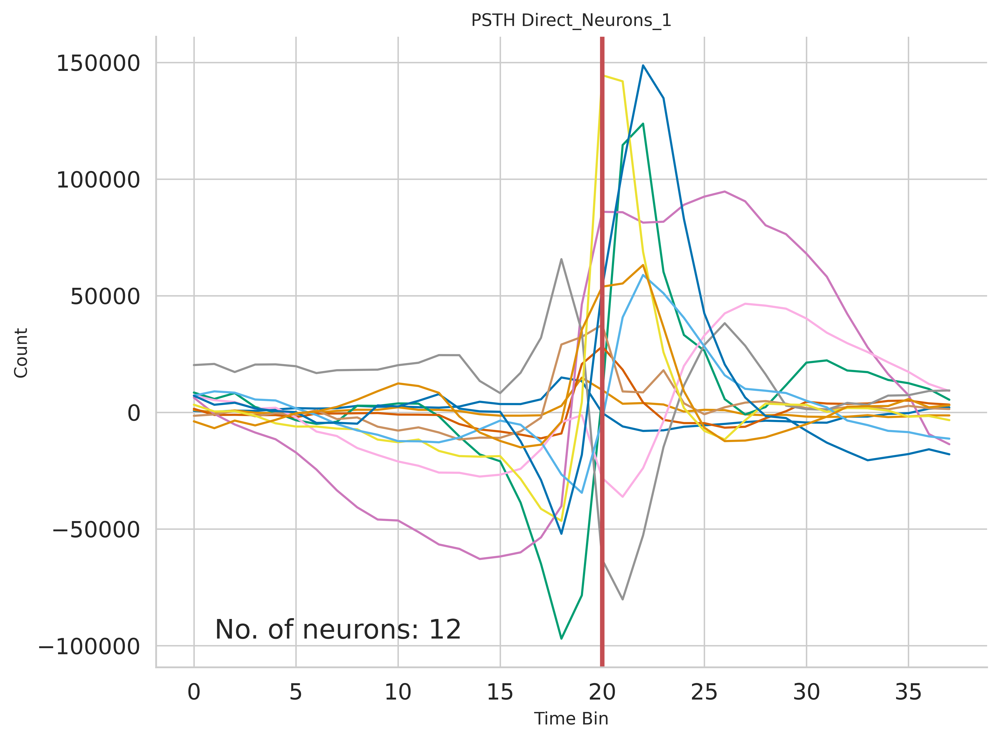

In [ ]:
get_psth(dir1_m[:,:,:38],'Direct_Neurons_1')

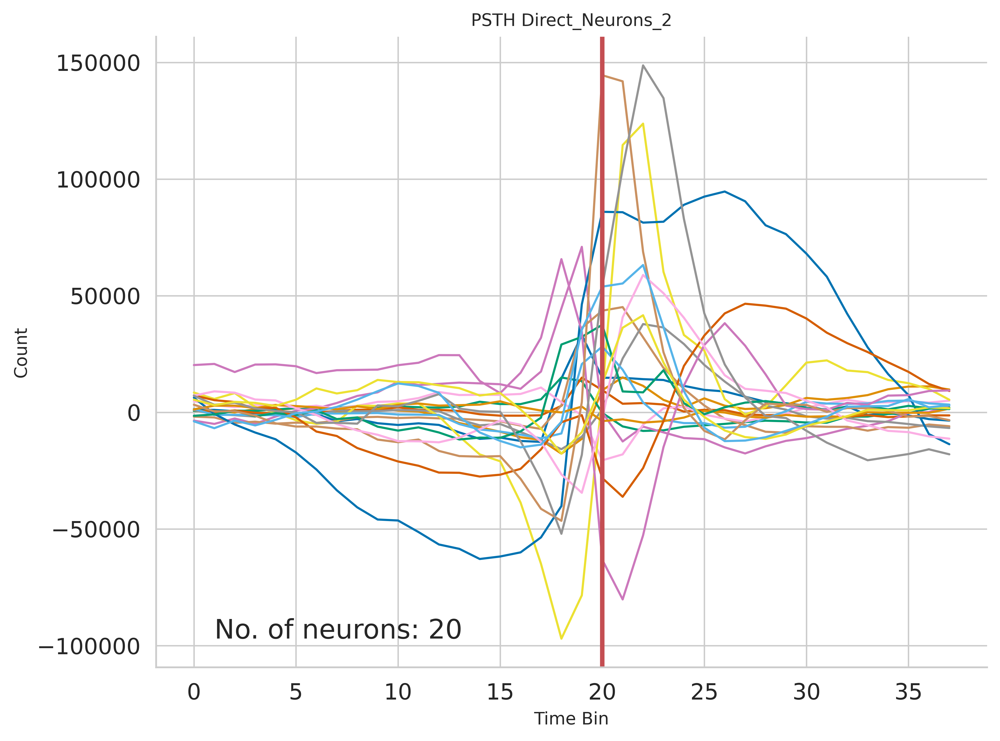

In [ ]:
get_psth(dir2_m[:,:,:38],'Direct_Neurons_2')

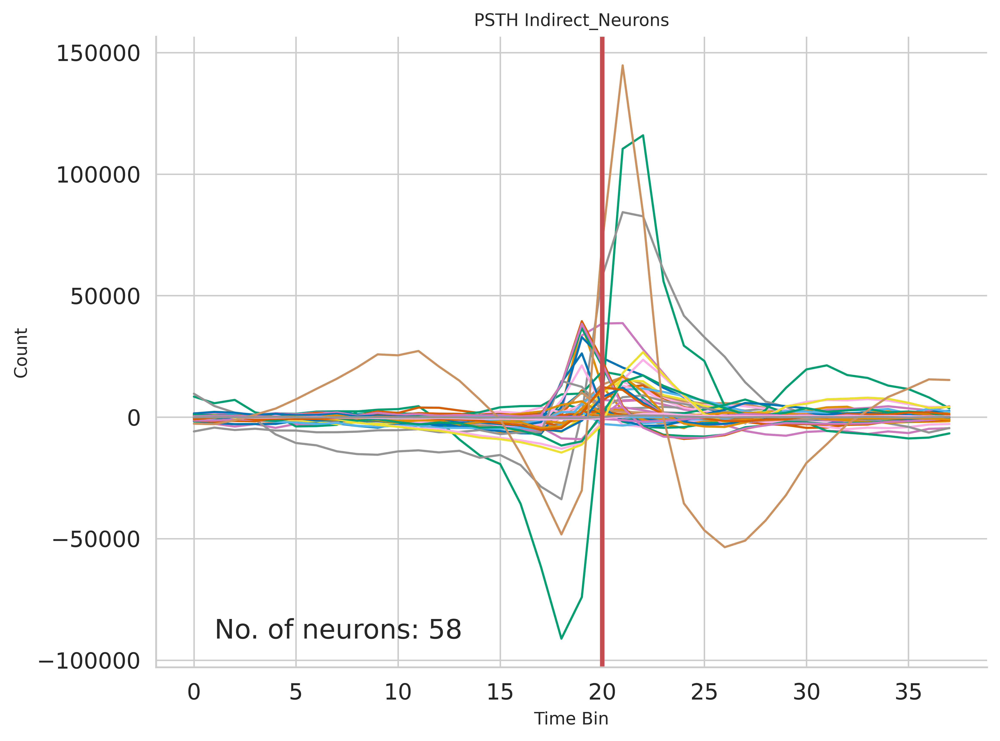

In [ ]:
get_psth(indir_m[:,:,:38],'Indirect_Neurons')

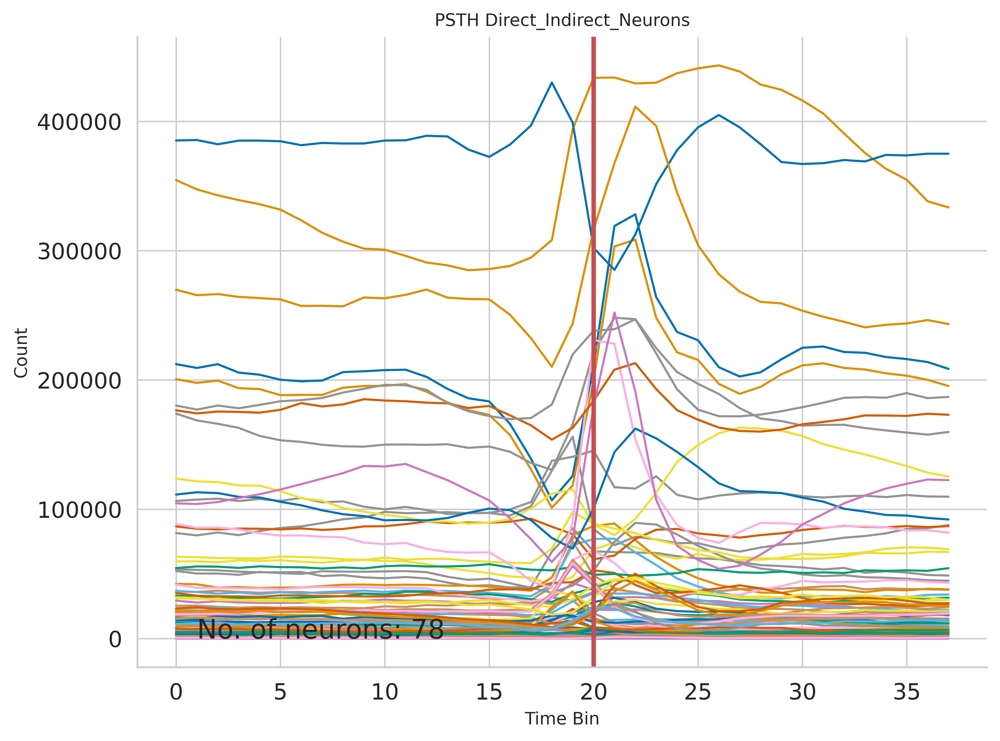

In [ ]:
get_psth(bmi_direct_indirect[:,:,:38],'Direct_Indirect_Neurons')

# Modelling and Neural Decoding

**Background** What model to use? What are the assumptions and limitations of this model?

**Practical Implementation** Hyperparameter optimization 

**Results Interpretation**

In [25]:
print(new_tr_outcome)

[8. 9. 9. ... 9. 9. 9.]


In [26]:
# clean up the trial outcome variable and set the rewarded trials to 1 and others to 0
new_tr_outcome[new_tr_outcome == 9] = 1
new_tr_outcome[new_tr_outcome == 8] = 0
#tr_outcome[tr_outcome != 1] = 0

np.count_nonzero(new_tr_outcome)

6824

In [27]:
bmi_direct2

array([[[  0.,   0.,  10., ...,  10.,  20.,   0.],
        [  0.,   0.,   0., ...,   0.,   0.,   0.],
        [  0.,   0.,   0., ...,   0.,   0.,   0.],
        ...,
        [  0.,  20.,  20., ...,  20.,   0.,   0.],
        [  0.,   0.,   0., ...,   0.,   0.,   0.],
        [ 60.,  50.,  20., ...,  20.,   0.,   0.]],

       [[ 10.,   0.,   0., ...,   0.,  10.,   0.],
        [  0.,   0.,   0., ...,   0.,   0.,   0.],
        [ 10.,   0.,   0., ...,   0.,   0.,   0.],
        ...,
        [110.,  70.,  30., ...,   0.,   0.,   0.],
        [  0.,   0.,   0., ...,   0.,   0.,   0.],
        [ 10.,  10.,  20., ...,  10.,  30.,   0.]],

       [[ 30.,  20.,  10., ...,   0.,  10.,   0.],
        [  0.,   0.,   0., ...,   0.,   0.,   0.],
        [ 10.,  20.,   0., ...,   0.,   0.,   0.],
        ...,
        [  0.,  10.,  10., ...,   0.,   0.,   0.],
        [  0.,  10.,   0., ...,   0.,   0.,   0.],
        [ 20.,  40.,  50., ...,  10.,   0.,   0.]],

       ...,

       [[ 10.,  10.,   0

(12757, 12, 18)


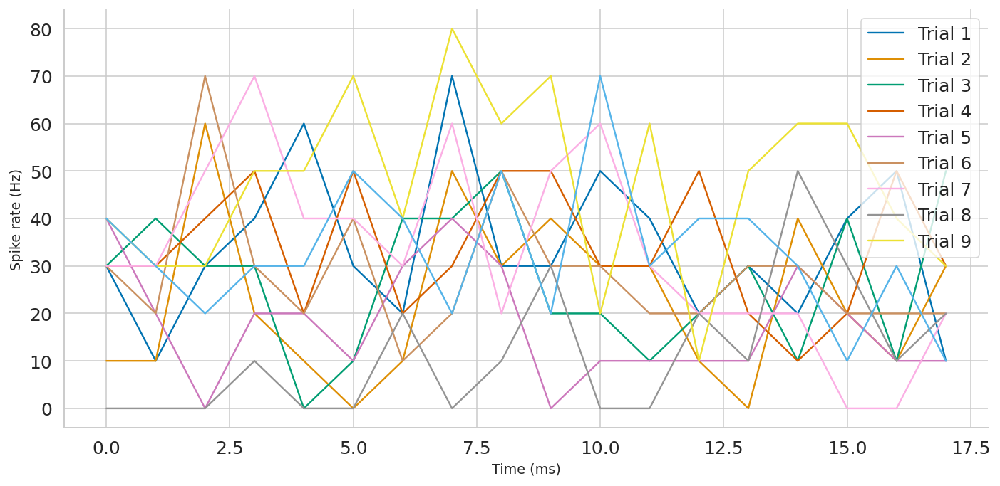

In [28]:
# plot out some trials for one neuron
neural_recordings = bmi_direct1[:,:,20:38][filter_trial_idx,:,:]
print(neural_recordings.shape)
neuron_id = 4

n_neurons = neural_recordings.shape[1]
n_bins_per_trial = neural_recordings.shape[2]

plt.figure(figsize=(10,5))
plt.plot(np.arange(0,np.shape(neural_recordings)[2],1),neural_recordings[:10,neuron_id,:].T)
plt.xlabel("Time (ms)")
plt.ylabel("Spike rate (Hz)")
plt.legend(["Trial {}".format(i) for i in range(1,10)])

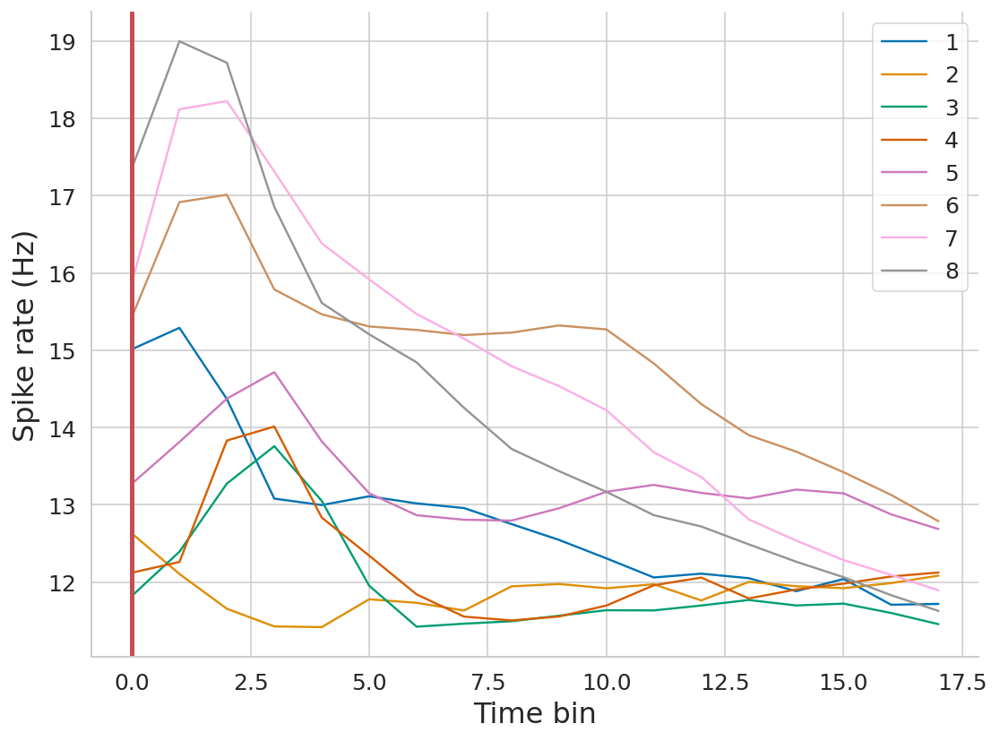

In [29]:
# Mean of firing activity across trials and neurons 
means_d = []
stds_d = []

plt.figure()
for i in range(1,9):
  means_d.append(np.mean(neural_recordings[target_direction==i], axis=(0,1)))
  stds_d.append(np.std(neural_recordings[target_direction==i], axis=(0,1)))
  # plt.subplot(4,2,i)
  plt.plot(means_d[i-1], label = i)
  plt.axvline(x=0,linewidth=2.5, color='r')
  # plt.fill_between(range(n_bins_per_trial),means_d[i-1]-stds_d[i-1], means_d[i-1]+stds_d[i-1], alpha=.2)
  plt.legend()
plt.xlabel("Time bin", fontsize = 16)
plt.ylabel("Spike rate (Hz)", fontsize = 16)
plt.tight_layout()

Text(0, 0.5, 'Spike rate (Hz)')

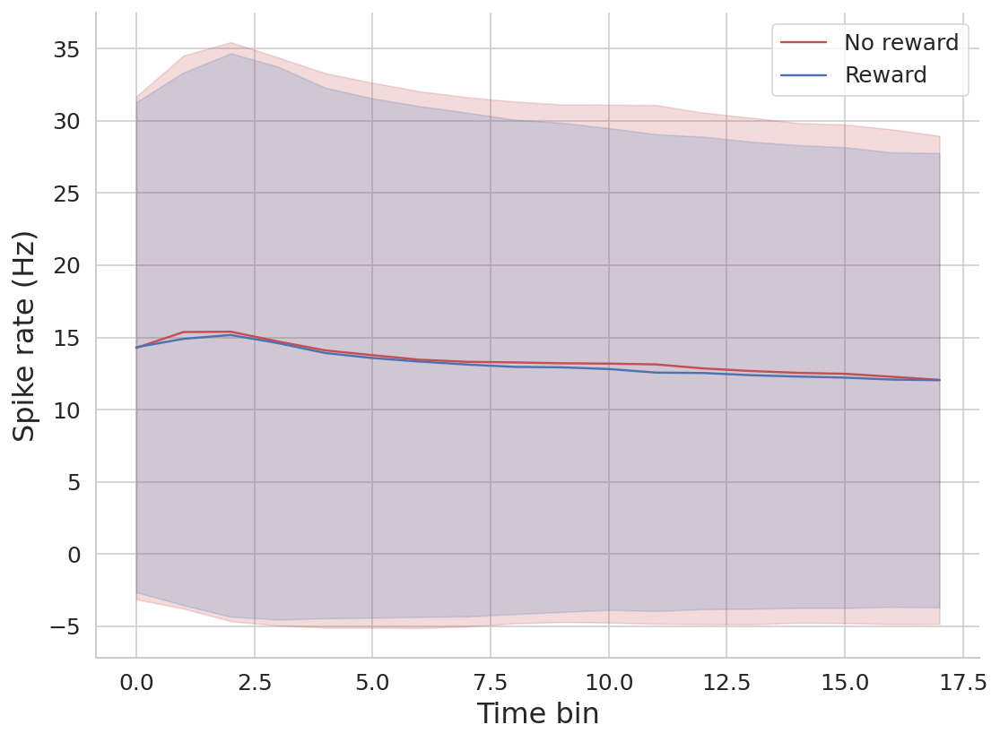

In [ ]:
# Just to gain intuition for Reward/ no reward scenario

# Mean of firing activity across trials and neurons 
means_0 = np.mean(neural_recordings[new_tr_outcome==0], axis=(0,1))
means_1 = np.mean(neural_recordings[new_tr_outcome==1], axis=(0,1))

stds_0 = np.std(neural_recordings[new_tr_outcome==0], axis=(0,1))
stds_1 = np.std(neural_recordings[new_tr_outcome==1], axis=(0,1))

plt.figure()
plt.plot(means_0, c='r', label = "No reward")
plt.fill_between(range(n_bins_per_trial),means_0-stds_0, means_0+stds_0, color='r', alpha=.2)
plt.plot(means_1, c='b', label = "Reward")
plt.fill_between(range(n_bins_per_trial),means_1-stds_1, means_1+stds_1, color='b', alpha=.2)
plt.legend()
plt.xlabel("Time bin", fontsize = 16)
plt.ylabel("Spike rate (Hz)", fontsize = 16)


# plt.figure(121)
# plt.plot(means_0, c='r', label = "No reward")
# plt.fill_between(range(n_bins_per_trial),means_0-stds_0, means_0+stds_0, color='r', alpha=.2)
# plt.legend()
# plt.xlabel("Time bin", fontsize = 16)
# plt.ylabel("Spike rate (Hz)", fontsize = 16)

# plt.figure(122)
# plt.plot(means_1, c='b', label = "Reward")
# plt.fill_between(range(n_bins_per_trial),means_1-stds_1, means_1+stds_1, color='b', alpha=.2)
# plt.legend()
# plt.xlabel("Time bin", fontsize = 16)
# plt.ylabel("Spike rate (Hz)", fontsize = 16)

In [ ]:
!pip install Neural-Decoding --upgrade

## Linear Model 

In [ ]:
def plot_coefs(fit_model,n_neurons,n_bins_per_trial, i): # add ax to input
  """Makes a nice plot of the coefficients. Also can generate a plot of how weights of each neuron and timebin change over days"""

  # get the coefficients of your fit
  coefficients = fit_model.coef_[1].reshape(n_neurons, n_bins_per_trial)

  # show them
  plt.figure(dpi = 300)
  # plt.sca(ax)
  plt.imshow(coefficients, cmap = 'coolwarm', vmin = -np.max(coefficients), 
                                              vmax = np.max(coefficients))

  #make it pretty
  plt.ylabel("Neuron #", fontsize = 14)
  plt.xlabel("Time (ms)", fontsize = 14)
  # plt.colorbar(orientation = 'horizontal', shrink = .3, label="Contribution of bin to decision;'Vote' towards a positive decision.")
  plt.tight_layout()
  plt.title('Day :'+str(i))
  plt.show()
  

# n_neurons = data_train.shape[1]
# n_bins_per_trial = data_train.shape[2]
# plot_coefs(my_linear_model,n_neurons, n_bins_per_trial)

In [31]:
def plot_coefs(fit_model,n_neurons,n_bins_per_trial, i,ax):
  """Makes a nice plot of the coefficients. Also can generate a plot of how weights of each neuron and timebin change over days"""

  # get the coefficients of your fit
  coefficients = fit_model.coef_[1].reshape(n_neurons, n_bins_per_trial)

  # show them
  plt.sca(ax)
  plt.imshow(coefficients, cmap = 'coolwarm', vmin = -np.max(coefficients), 
                                              vmax = np.max(coefficients))

  #make it pretty
  # plt.ylabel("Neuron #", fontsize = 14)
  # plt.xlabel("Time (ms)", fontsize = 14)
  # plt.colorbar(orientation = 'horizontal', shrink = .3, label="Contribution of bin to decision;'Vote' towards a positive decision.")
  plt.tight_layout()
  plt.title('Day :'+str(i))
  # plt.show()

def model_fit(my_linear_model, x_train, X_test, n_neurons, n_bins_per_trial, i, plot_true, ax=None):
  my_linear_model.fit(X_train, outcome_train)
  # R2 model fitting score
  r2_train = my_linear_model.score(X_train,outcome_train)
  # print("R2 was",r2_train)

  r2_test =my_linear_model.score(X_test,outcome_test)
  # print("Test accuracy was",r2_test)

  # print(my_linear_model.coef_[0].shape, my_linear_model.coef_[1].shape)
  if plot_true:
    plot_coefs(my_linear_model,n_neurons, n_bins_per_trial,i,ax)

  coefficients = my_linear_model.coef_[1].reshape(n_neurons, n_bins_per_trial)
  mean_weight = np.mean(np.abs(coefficients), axis = 1)

  return my_linear_model, r2_train, r2_test, coefficients, mean_weight

In [32]:
# neural_recordings = indir_m[:,:,20:38]
neural_recordings = bmi_direct2[:,:,20:38][filter_trial_idx,:,:]
day = get_trial_by_day(sess_ID[filter_trial_idx], bmi_day )

{1: 31, 2: 707, 3: 1306, 4: 2326, 5: 3051, 6: 3371, 7: 4449, 8: 5503, 9: 6809, 10: 7557, 11: 8652, 12: 9404, 13: 10429, 14: 10867, 15: 11668, 16: 12064, 17: 12756}


In [33]:
print(np.array(day))

{1: 31, 2: 707, 3: 1306, 4: 2326, 5: 3051, 6: 3371, 7: 4449, 8: 5503, 9: 6809, 10: 7557, 11: 8652, 12: 9404, 13: 10429, 14: 10867, 15: 11668, 16: 12064, 17: 12756}


### All Days

1 1
(21, 78, 18)
(21,)
(21, 1404)
R2 was 1.0
Test accuracy was 0.36363636363636365
(21, 78, 18)
(21,)
(21, 1404)
R2 was 1.0
Test accuracy was 0.36363636363636365
(21, 78, 18)
(21,)
(21, 1404)
R2 was 1.0
Test accuracy was 0.45454545454545453
(21, 78, 18)
(21,)
(21, 1404)
R2 was 1.0
Test accuracy was 0.2727272727272727
(21, 78, 18)
(21,)
(21, 1404)
R2 was 1.0
Test accuracy was 0.36363636363636365
(1404,) (1404,)


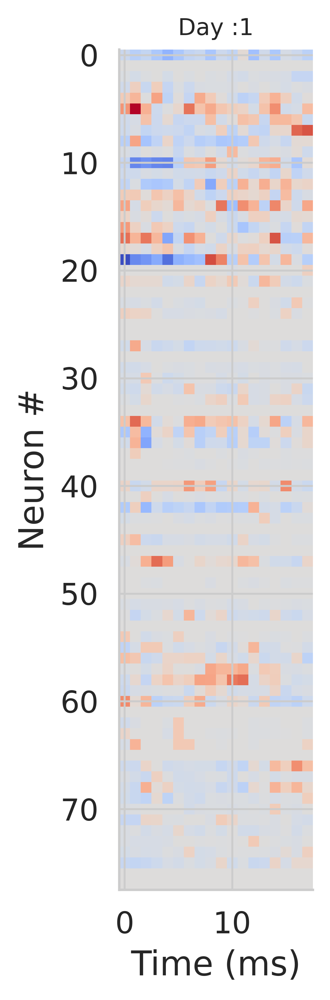

(78,)
2
(452, 78, 18)
(452,)
(452, 1404)
R2 was 1.0
Test accuracy was 0.7053571428571429
(452, 78, 18)
(452,)
(452, 1404)
R2 was 1.0
Test accuracy was 0.75
(452, 78, 18)
(452,)
(452, 1404)
R2 was 1.0
Test accuracy was 0.7767857142857143
(452, 78, 18)
(452,)
(452, 1404)
R2 was 1.0
Test accuracy was 0.7723214285714286
(452, 78, 18)
(452,)
(452, 1404)
R2 was 1.0
Test accuracy was 0.7544642857142857
(1404,) (1404,)


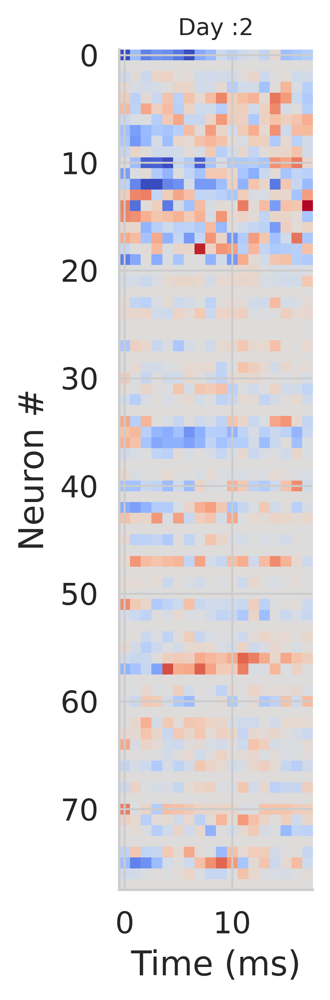

(78,)
3
(401, 78, 18)
(401,)
(401, 1404)
R2 was 1.0
Test accuracy was 0.7626262626262627
(401, 78, 18)
(401,)
(401, 1404)
R2 was 1.0
Test accuracy was 0.7727272727272727
(401, 78, 18)
(401,)
(401, 1404)
R2 was 1.0
Test accuracy was 0.7424242424242424
(401, 78, 18)
(401,)
(401, 1404)
R2 was 1.0
Test accuracy was 0.7727272727272727
(401, 78, 18)
(401,)
(401, 1404)
R2 was 1.0
Test accuracy was 0.7272727272727273
(1404,) (1404,)


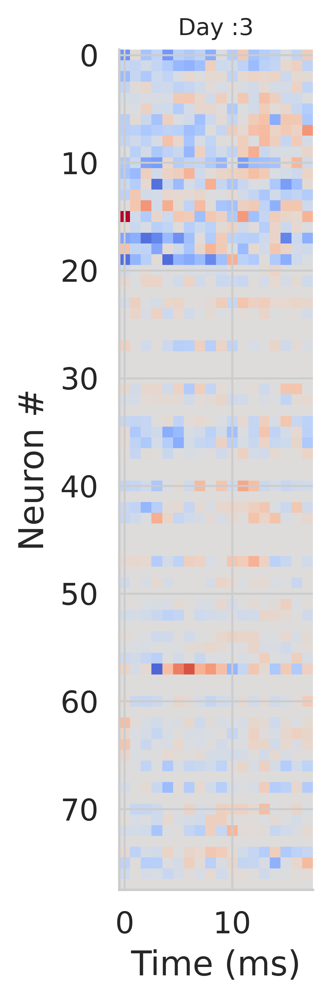

(78,)
4
(683, 78, 18)
(683,)
(683, 1404)
R2 was 1.0
Test accuracy was 0.8456973293768546
(683, 78, 18)
(683,)
(683, 1404)
R2 was 1.0
Test accuracy was 0.798219584569733
(683, 78, 18)
(683,)
(683, 1404)
R2 was 1.0
Test accuracy was 0.8100890207715133
(683, 78, 18)
(683,)
(683, 1404)
R2 was 1.0
Test accuracy was 0.8100890207715133
(683, 78, 18)
(683,)
(683, 1404)
R2 was 1.0
Test accuracy was 0.8427299703264095
(1404,) (1404,)


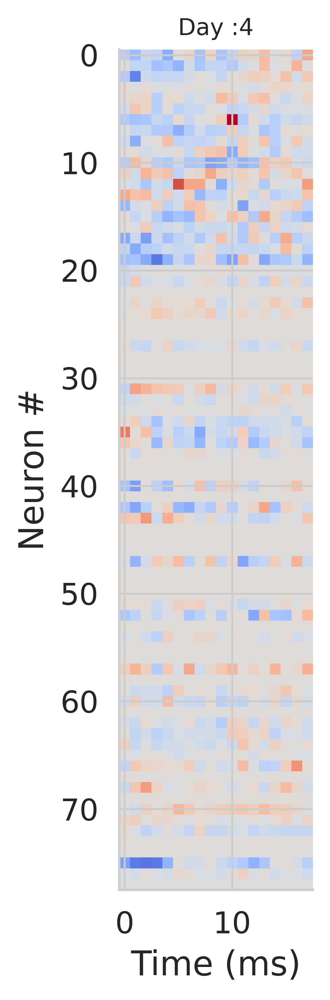

(78,)
5
(485, 78, 18)
(485,)
(485, 1404)
R2 was 1.0
Test accuracy was 0.7708333333333334
(485, 78, 18)
(485,)
(485, 1404)
R2 was 1.0
Test accuracy was 0.8166666666666667
(485, 78, 18)
(485,)
(485, 1404)
R2 was 1.0
Test accuracy was 0.8291666666666667
(485, 78, 18)
(485,)
(485, 1404)
R2 was 1.0
Test accuracy was 0.7791666666666667
(485, 78, 18)
(485,)
(485, 1404)
R2 was 1.0
Test accuracy was 0.8625
(1404,) (1404,)


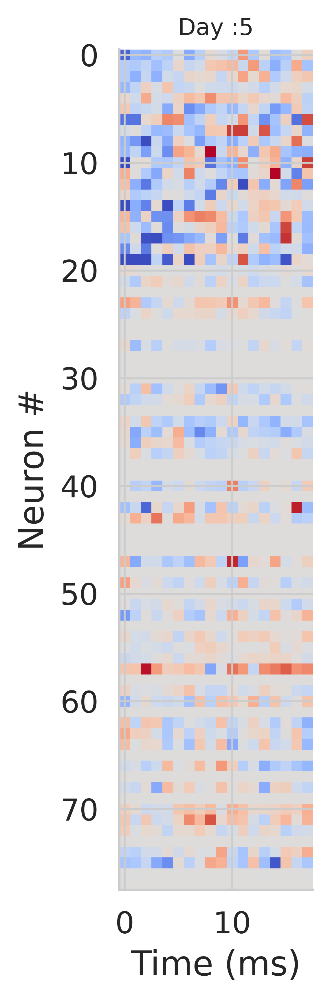

(78,)
6
(214, 78, 18)
(214,)
(214, 1404)
R2 was 1.0
Test accuracy was 0.7452830188679245
(214, 78, 18)
(214,)
(214, 1404)
R2 was 1.0
Test accuracy was 0.7641509433962265
(214, 78, 18)
(214,)
(214, 1404)
R2 was 1.0
Test accuracy was 0.7169811320754716
(214, 78, 18)
(214,)
(214, 1404)
R2 was 1.0
Test accuracy was 0.7075471698113207
(214, 78, 18)
(214,)
(214, 1404)
R2 was 1.0
Test accuracy was 0.6981132075471698
(1404,) (1404,)


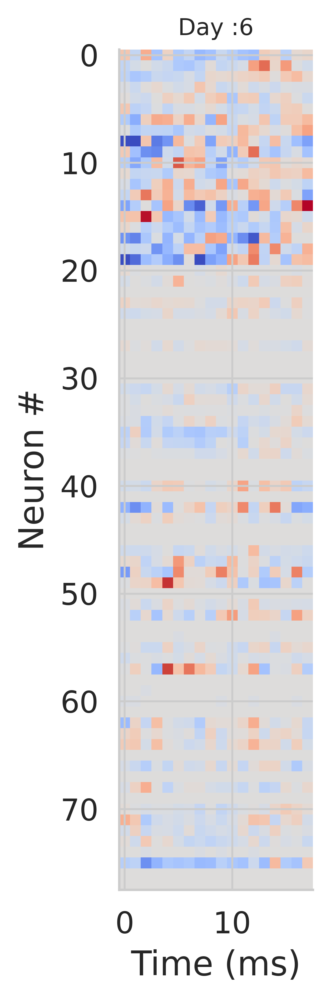

(78,)
7
(722, 78, 18)
(722,)
(722, 1404)
R2 was 1.0
Test accuracy was 0.8398876404494382
(722, 78, 18)
(722,)
(722, 1404)
R2 was 1.0
Test accuracy was 0.8089887640449438
(722, 78, 18)
(722,)
(722, 1404)
R2 was 1.0
Test accuracy was 0.8567415730337079
(722, 78, 18)
(722,)
(722, 1404)
R2 was 1.0
Test accuracy was 0.8370786516853933
(722, 78, 18)
(722,)
(722, 1404)
R2 was 1.0
Test accuracy was 0.8426966292134831
(1404,) (1404,)


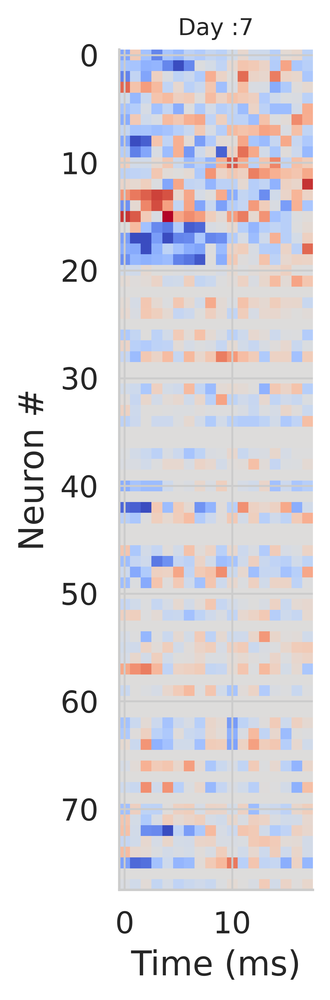

(78,)
8
(706, 78, 18)
(706,)
(706, 1404)
R2 was 1.0
Test accuracy was 0.9022988505747126
(706, 78, 18)
(706,)
(706, 1404)
R2 was 1.0
Test accuracy was 0.8850574712643678
(706, 78, 18)
(706,)
(706, 1404)
R2 was 1.0
Test accuracy was 0.8908045977011494
(706, 78, 18)
(706,)
(706, 1404)
R2 was 1.0
Test accuracy was 0.9252873563218391
(706, 78, 18)
(706,)
(706, 1404)
R2 was 1.0
Test accuracy was 0.8936781609195402
(1404,) (1404,)


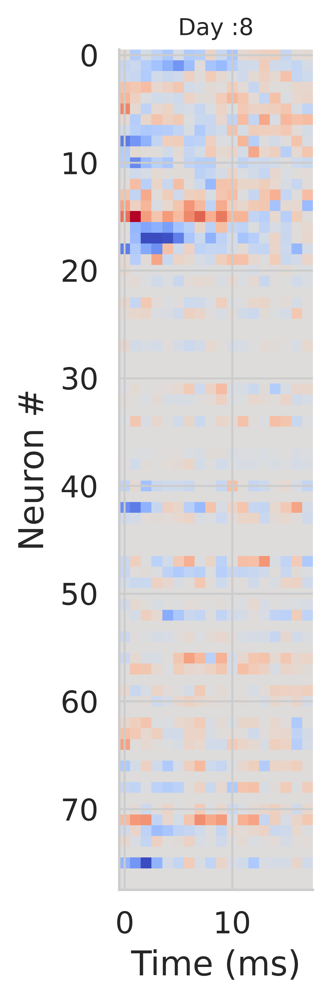

(78,)
9
(875, 78, 18)
(875,)
(875, 1404)
R2 was 1.0
Test accuracy was 0.8747099767981439
(875, 78, 18)
(875,)
(875, 1404)
R2 was 1.0
Test accuracy was 0.8654292343387471
(875, 78, 18)
(875,)
(875, 1404)
R2 was 1.0
Test accuracy was 0.9071925754060325
(875, 78, 18)
(875,)
(875, 1404)
R2 was 1.0
Test accuracy was 0.8932714617169374
(875, 78, 18)
(875,)
(875, 1404)
R2 was 1.0
Test accuracy was 0.9095127610208816
(1404,) (1404,)


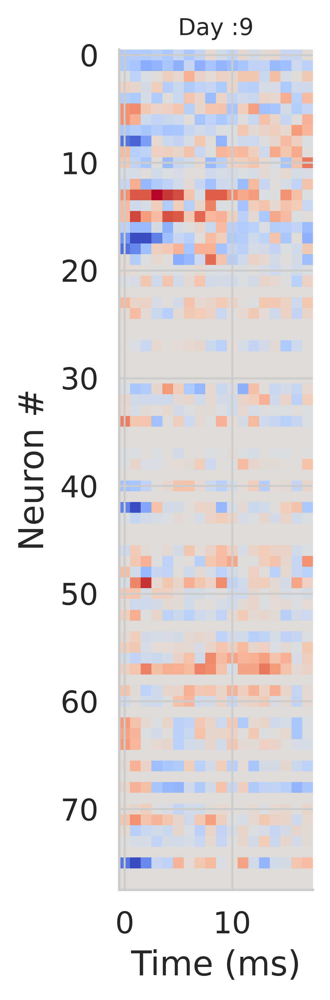

(78,)
10
(501, 78, 18)
(501,)
(501, 1404)
R2 was 1.0
Test accuracy was 0.8663967611336032
(501, 78, 18)
(501,)
(501, 1404)
R2 was 1.0
Test accuracy was 0.8137651821862348
(501, 78, 18)
(501,)
(501, 1404)
R2 was 1.0
Test accuracy was 0.8218623481781376
(501, 78, 18)
(501,)
(501, 1404)
R2 was 1.0
Test accuracy was 0.8502024291497976
(501, 78, 18)
(501,)
(501, 1404)
R2 was 1.0
Test accuracy was 0.8421052631578947
(1404,) (1404,)


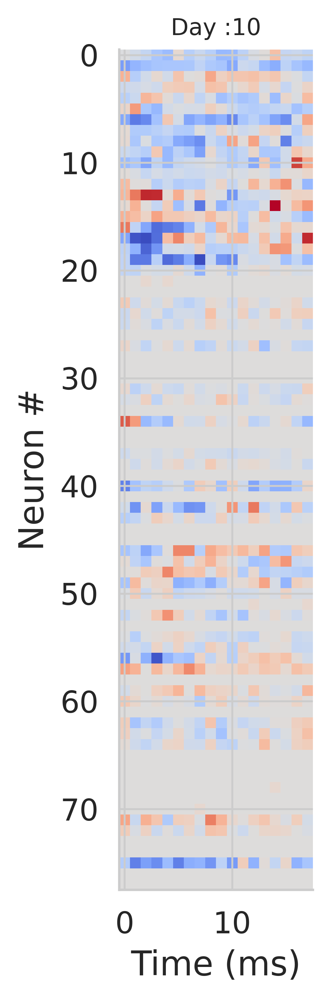

(78,)
11
(733, 78, 18)
(733,)
(733, 1404)
R2 was 1.0
Test accuracy was 0.8756906077348067
(733, 78, 18)
(733,)
(733, 1404)
R2 was 1.0
Test accuracy was 0.9088397790055248
(733, 78, 18)
(733,)
(733, 1404)
R2 was 1.0
Test accuracy was 0.8812154696132597
(733, 78, 18)
(733,)
(733, 1404)
R2 was 1.0
Test accuracy was 0.8922651933701657
(733, 78, 18)
(733,)
(733, 1404)
R2 was 1.0
Test accuracy was 0.8756906077348067
(1404,) (1404,)


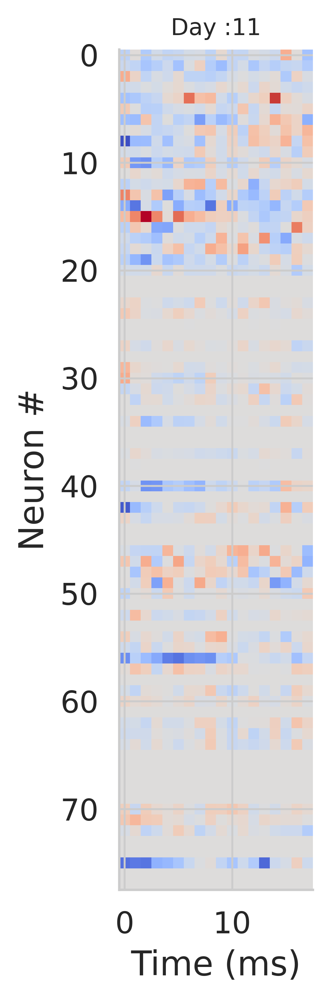

(78,)
12
(503, 78, 18)
(503,)
(503, 1404)
R2 was 1.0
Test accuracy was 0.8674698795180723
(503, 78, 18)
(503,)
(503, 1404)
R2 was 1.0
Test accuracy was 0.8634538152610441
(503, 78, 18)
(503,)
(503, 1404)
R2 was 1.0
Test accuracy was 0.8875502008032129
(503, 78, 18)
(503,)
(503, 1404)
R2 was 1.0
Test accuracy was 0.891566265060241
(503, 78, 18)
(503,)
(503, 1404)
R2 was 1.0
Test accuracy was 0.8795180722891566
(1404,) (1404,)


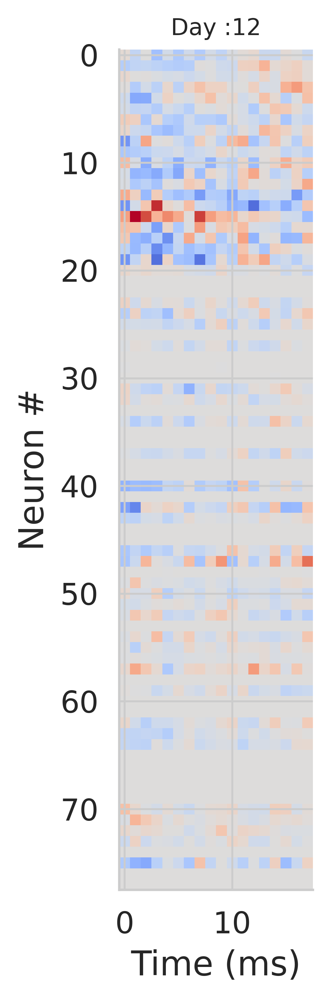

(78,)
13
(686, 78, 18)
(686,)
(686, 1404)
R2 was 1.0
Test accuracy was 0.9262536873156342
(686, 78, 18)
(686,)
(686, 1404)
R2 was 1.0
Test accuracy was 0.9174041297935103
(686, 78, 18)
(686,)
(686, 1404)
R2 was 1.0
Test accuracy was 0.9233038348082596
(686, 78, 18)
(686,)
(686, 1404)
R2 was 1.0
Test accuracy was 0.9351032448377581
(686, 78, 18)
(686,)
(686, 1404)
R2 was 1.0
Test accuracy was 0.8938053097345132
(1404,) (1404,)


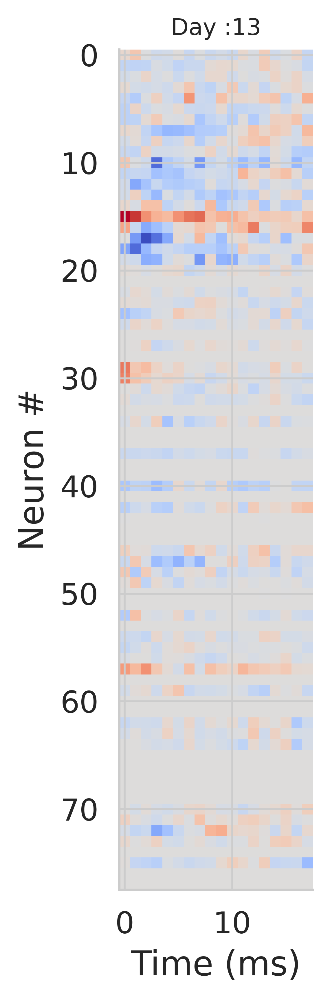

(78,)
14
(293, 78, 18)
(293,)
(293, 1404)
R2 was 1.0
Test accuracy was 0.903448275862069
(293, 78, 18)
(293,)
(293, 1404)
R2 was 1.0
Test accuracy was 0.9103448275862069
(293, 78, 18)
(293,)
(293, 1404)
R2 was 1.0
Test accuracy was 0.9241379310344827
(293, 78, 18)
(293,)
(293, 1404)
R2 was 1.0
Test accuracy was 0.9172413793103448
(293, 78, 18)
(293,)
(293, 1404)
R2 was 1.0
Test accuracy was 0.8758620689655172
(1404,) (1404,)


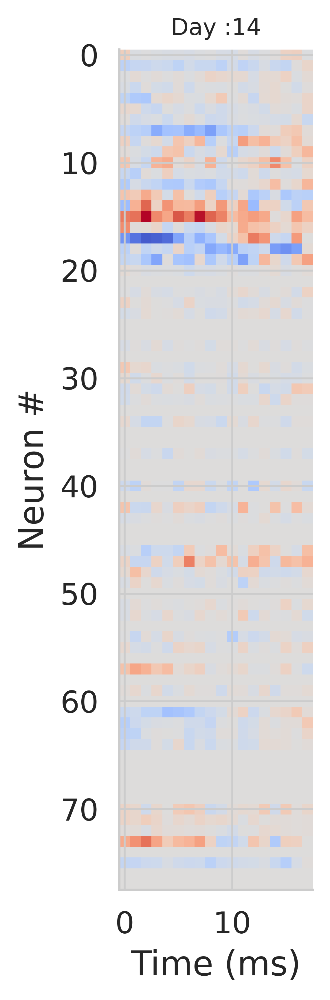

(78,)
15
(536, 78, 18)
(536,)
(536, 1404)
R2 was 1.0
Test accuracy was 0.9584905660377359
(536, 78, 18)
(536,)
(536, 1404)
R2 was 1.0
Test accuracy was 0.9509433962264151
(536, 78, 18)
(536,)
(536, 1404)
R2 was 1.0
Test accuracy was 0.969811320754717
(536, 78, 18)
(536,)
(536, 1404)
R2 was 1.0
Test accuracy was 0.9660377358490566
(536, 78, 18)
(536,)
(536, 1404)
R2 was 1.0
Test accuracy was 0.9509433962264151
(1404,) (1404,)


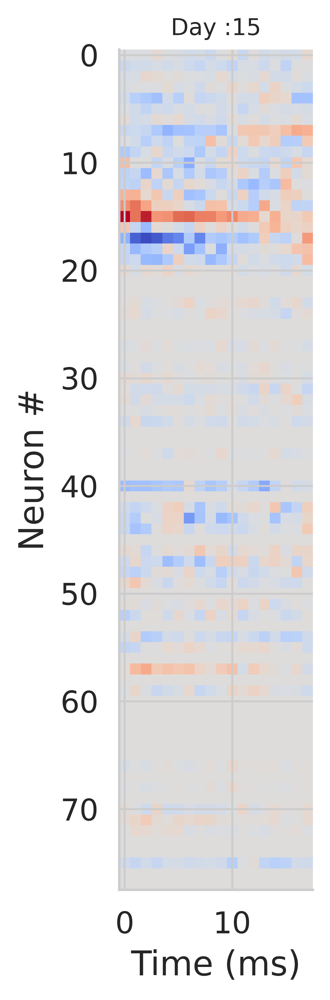

(78,)
16
(265, 78, 18)
(265,)
(265, 1404)
R2 was 1.0
Test accuracy was 0.9236641221374046
(265, 78, 18)
(265,)
(265, 1404)
R2 was 1.0
Test accuracy was 0.9007633587786259
(265, 78, 18)
(265,)
(265, 1404)
R2 was 1.0
Test accuracy was 0.9618320610687023
(265, 78, 18)
(265,)
(265, 1404)
R2 was 1.0
Test accuracy was 0.8854961832061069
(265, 78, 18)
(265,)
(265, 1404)
R2 was 1.0
Test accuracy was 0.9694656488549618
(1404,) (1404,)


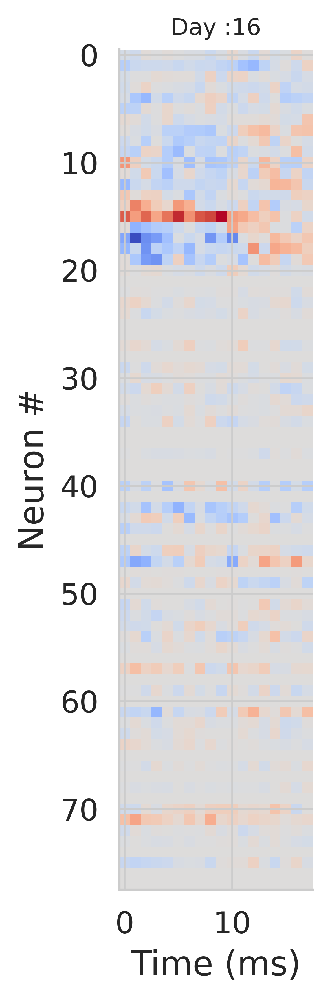

(78,)
17
(463, 78, 18)
(463,)
(463, 1404)
R2 was 1.0
Test accuracy was 0.9126637554585153
(463, 78, 18)
(463,)
(463, 1404)
R2 was 1.0
Test accuracy was 0.9344978165938864
(463, 78, 18)
(463,)
(463, 1404)
R2 was 1.0
Test accuracy was 0.9563318777292577
(463, 78, 18)
(463,)
(463, 1404)
R2 was 1.0
Test accuracy was 0.9301310043668122
(463, 78, 18)
(463,)
(463, 1404)
R2 was 1.0
Test accuracy was 0.925764192139738
(1404,) (1404,)


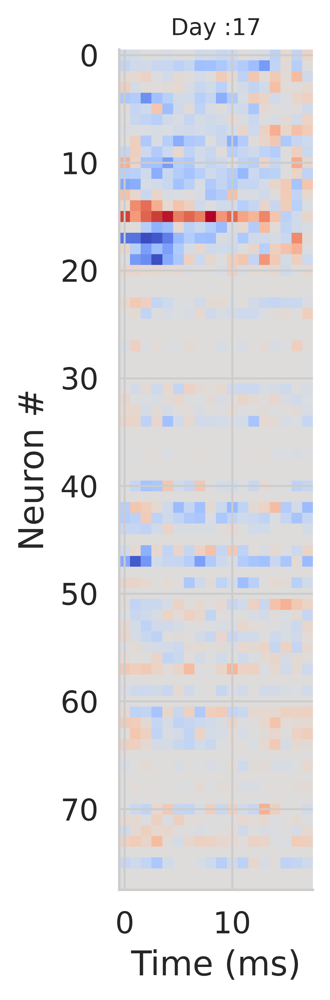

(78,)


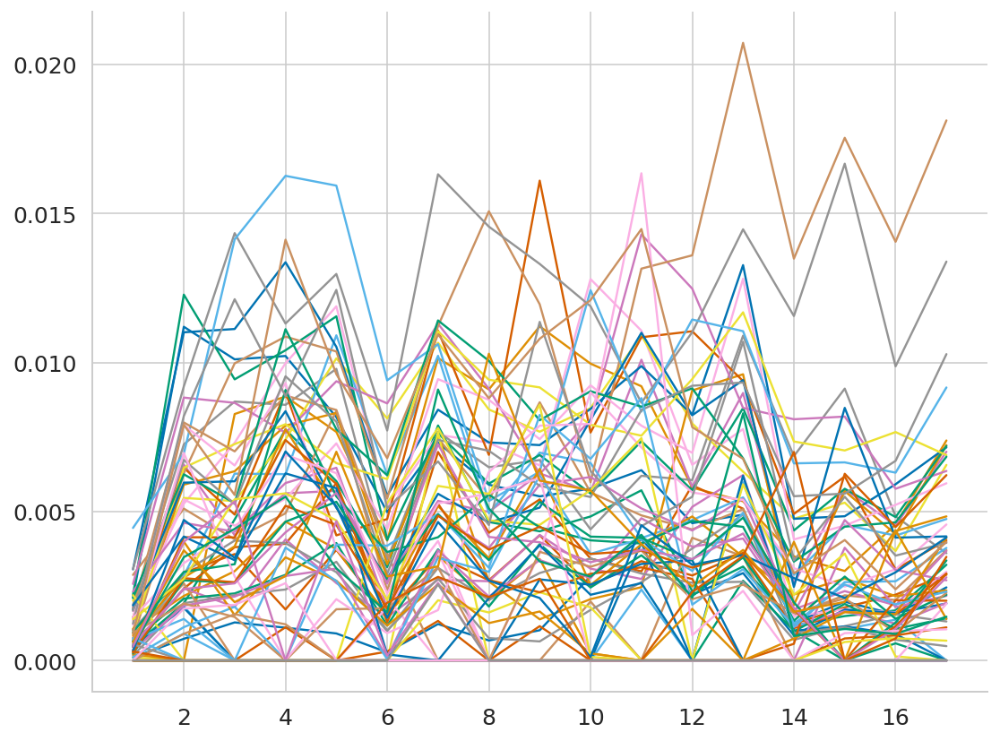

In [ ]:
# Code for training and testing all days 
from sklearn.model_selection import train_test_split
from sklearn import linear_model

# Initializing a linear model 
my_linear_model = linear_model.LogisticRegression(penalty='l2', solver = 'lbfgs', max_iter = 10000,C = 1.0)
r2_train = np.zeros((18,5))
r2_test = np.zeros((18,5))
weights_day = []

for i in range(1,18):
  data = getdata_day(neural_recordings,i, day )
  if i == 1:
    print(i,i)
    target = target_direction[0:day[1]+1]
  else:
    print(i)
    target = target_direction[day[i-1]:day[i]]

  for j in range(5):
    data_train, data_test, outcome_train, outcome_test = train_test_split(data, target , test_size=0.33, random_state=np.random.randint(4000))

    print(data_train.shape)
    print(outcome_train.shape)

    # Concatenating the third dimension 
    X_train = np.reshape(data_train, (np.shape(data_train)[0],-1))
    print(X_train.shape)
    X_test = np.reshape(data_test, (np.shape(data_test)[0],-1))

    ## Z score data 
    ## For Z scoring, we will calculate the mean and std. deviation for the training dataset each day and apply the same z score parameters for test data 
    ## Z-score inputs 
    # train_mean=np.nanmean(X_train,axis=0)
    # train_std=np.nanstd(X_train,axis=0)
    # X_train=(X_train-train_mean)/train_std
    # X_test=(X_test-train_mean)/train_std

    # Model fitting
    my_linear_model.fit(X_train, outcome_train)

    # R2 model fitting score
    r2_train[i,j] = my_linear_model.score(X_train,outcome_train)
    print("R2 was",r2_train[i,j])

    r2_test[i,j]=my_linear_model.score(X_test,outcome_test)
    print("Test accuracy was",r2_test[i,j])

  print(my_linear_model.coef_[0].shape, my_linear_model.coef_[1].shape)
  n_neurons = data_train.shape[1]
  n_bins_per_trial = data_train.shape[2]
  plot_coefs(my_linear_model,n_neurons, n_bins_per_trial,i)

  coefficients = my_linear_model.coef_[1].reshape(n_neurons, n_bins_per_trial)
  mean_weight = np.mean(np.abs(coefficients), axis = 1)
  weights_day.append(mean_weight)
  print(mean_weight.shape)

plt.figure()
plt.plot(np.arange(1,18), weights_day)

In [ ]:
 ## Testing 
  # np.random.seed(123)
  # idx = np.arange(0,len(data),1)
  # random_idx = np.random.choice(idx, 300)
  # # sample_data = data[random_idx] 
  # # sample_target = target[random_idx]
  # print(idx.shape)
  # print(random_idx)

(692,)
[510 365 382 322  98  17 595 106 123 569 214  96 113 638  47  73 544 224
 111 409 339 253 420 608 208  68 451   2 340  39 322 596 559 504 176 135
  99 380 180 358 213 630 411 290 588 680 106 576 418 394 146 484 271 411
 158 180 582 365 371 154 390 255 244 359 129 555 186 357 537 434 305 530
 465 513  51 304  56 342 515  67 139 661 473 615 489 354   3 259 222 262
 265  87  14 467 198 140 438 539 401 628  99 193 493  16 645 360 109  86
  46 271 315 296 409 301 433 419 385 486  60 321 323 647  88 141 412 364
 319 340 631 496 480 377 424 472  58 493  77   8 206 390  65 222 198 552
  76 460 665 490 635 497 135 428 257 681 206 440 471 575 481 515  17  88
 215 197 609 562 357 130 658 557 530 475 686 503  73 574 651 410  92 459
 557 634 442 187 407 281 441 622 507 259 611 341 502 432 312 612 325 112
 312 572 649 194 673  69 636 393 207 251 540 322  10 290 293 305 665 401
 186 194 301  10 136 281 355 579 627 321 519 454 225 679 220 422 137 168
 489 324 506 215 405 601  44 604 339 337 383

### Day 2 to 16


{1: 31, 2: 707, 3: 1306, 4: 2326, 5: 3051, 6: 3371, 7: 4449, 8: 5503, 9: 6809, 10: 7557, 11: 8652, 12: 9404, 13: 10429, 14: 10867, 15: 11668, 16: 12064, 17: 12756}
2 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.797979797979798
2 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.8080808080808081
2 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.7575757575757576
2 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.7777777777777778
2 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.7777777777777778
(1404,) (1404,)


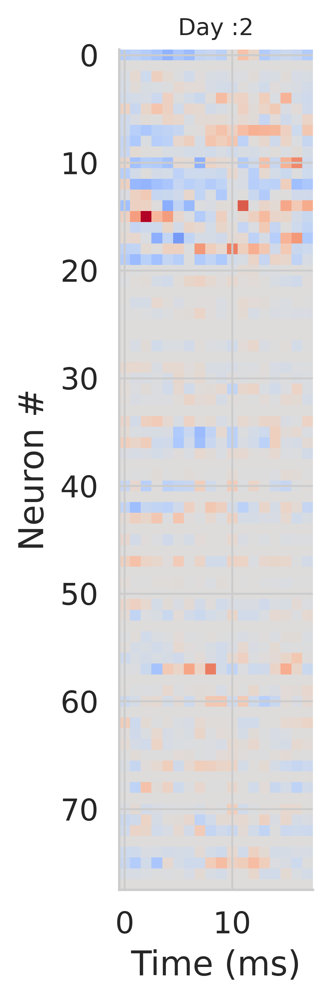

(78,)
3 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.7676767676767676
3 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.7070707070707071
3 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.7777777777777778
3 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.696969696969697
3 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.8282828282828283
(1404,) (1404,)


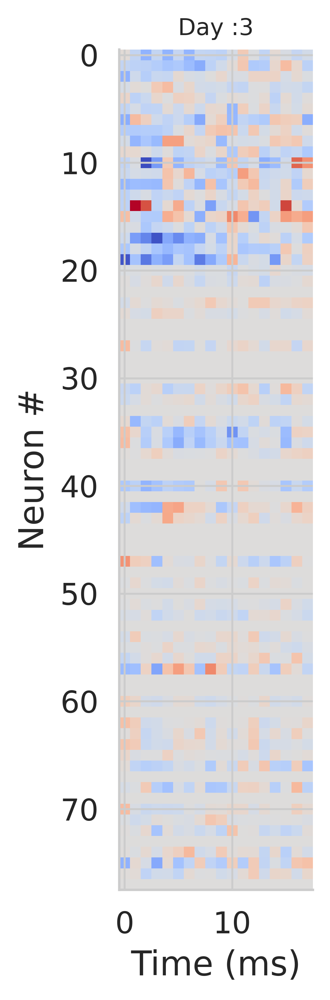

(78,)
4 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.8282828282828283
4 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.7777777777777778
4 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.8686868686868687
4 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.7272727272727273
4 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.7878787878787878
(1404,) (1404,)


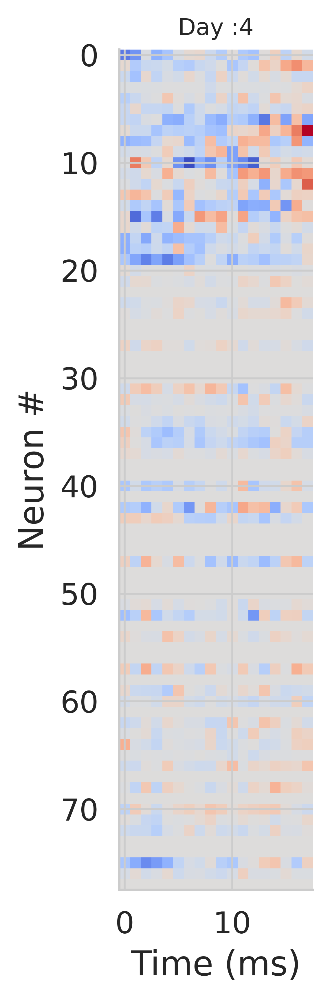

(78,)
5 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.7878787878787878
5 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.797979797979798
5 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.8484848484848485
5 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.7575757575757576
5 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.7575757575757576
(1404,) (1404,)


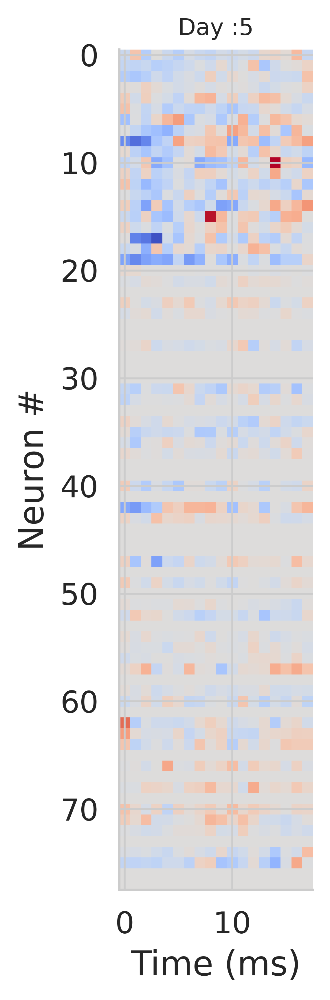

(78,)
6 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.7777777777777778
6 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.7878787878787878
6 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.8484848484848485
6 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.7373737373737373
6 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.7676767676767676
(1404,) (1404,)


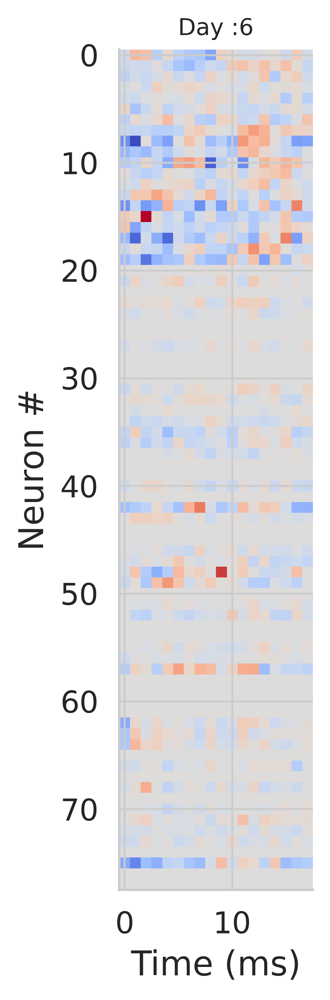

(78,)
7 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.797979797979798
7 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.7474747474747475
7 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.7575757575757576
7 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.8686868686868687
7 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.7777777777777778
(1404,) (1404,)


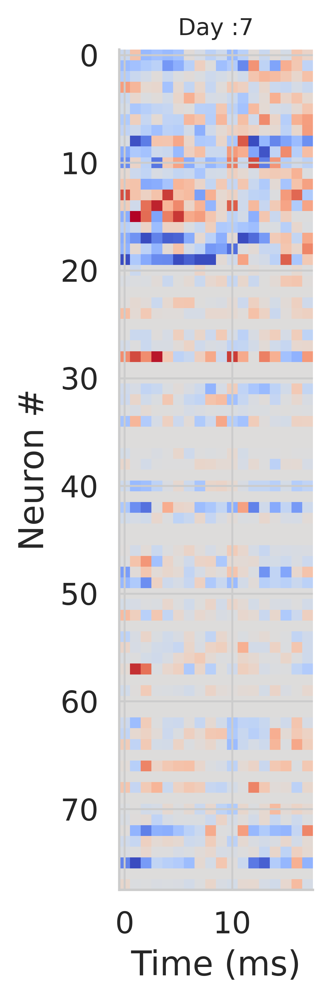

(78,)
8 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.8383838383838383
8 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.7676767676767676
8 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.7878787878787878
8 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.9191919191919192
8 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.8282828282828283
(1404,) (1404,)


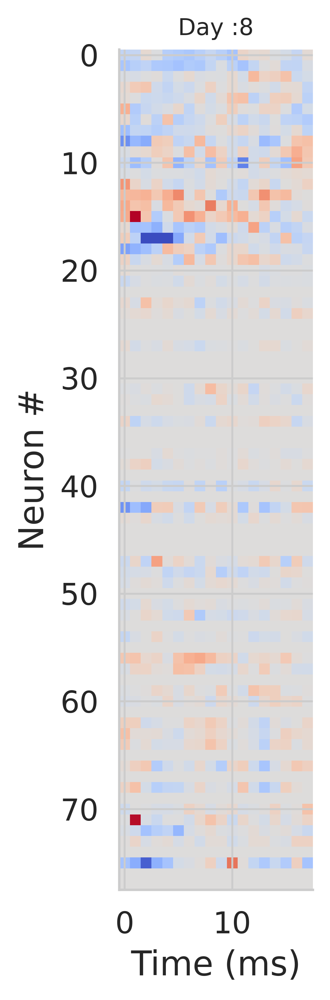

(78,)
9 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.7777777777777778
9 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.8686868686868687
9 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.7777777777777778
9 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.7171717171717171
9 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.8484848484848485
(1404,) (1404,)


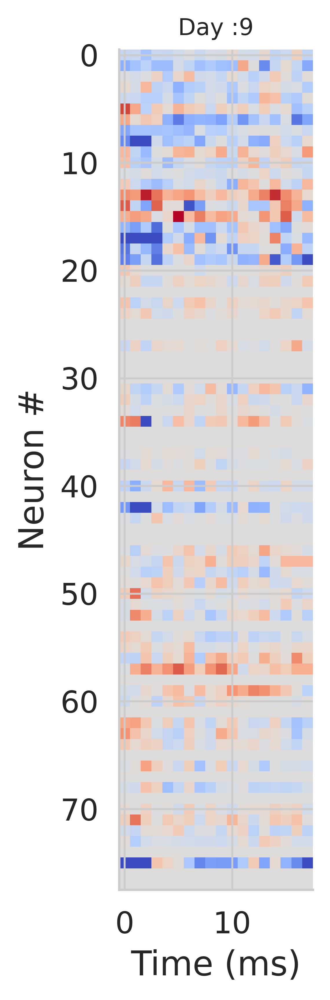

(78,)
10 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.7777777777777778
10 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.7878787878787878
10 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.8383838383838383
10 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.8383838383838383
10 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.7474747474747475
(1404,) (1404,)


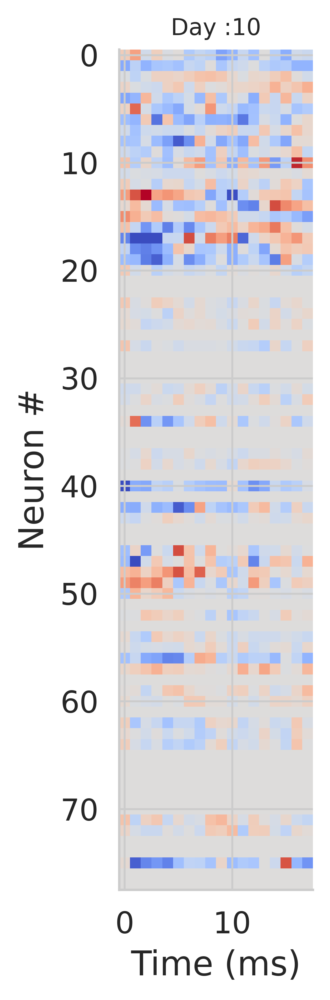

(78,)
11 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.8282828282828283
11 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.8282828282828283
11 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.8282828282828283
11 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.7575757575757576
11 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.8080808080808081
(1404,) (1404,)


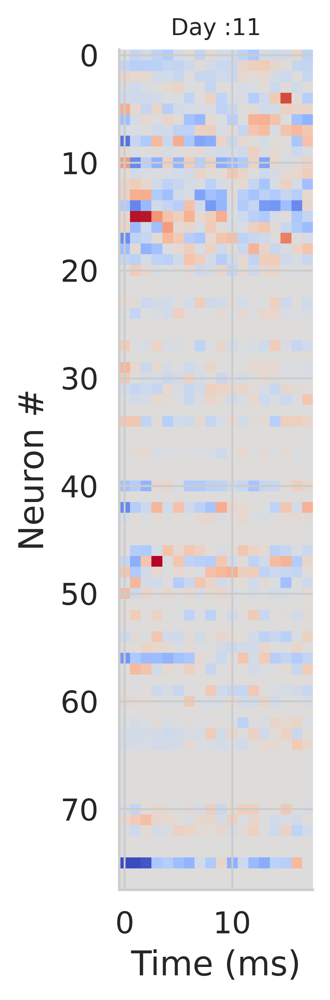

(78,)
12 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.8686868686868687
12 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.8484848484848485
12 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.8282828282828283
12 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.7474747474747475
12 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.8080808080808081
(1404,) (1404,)


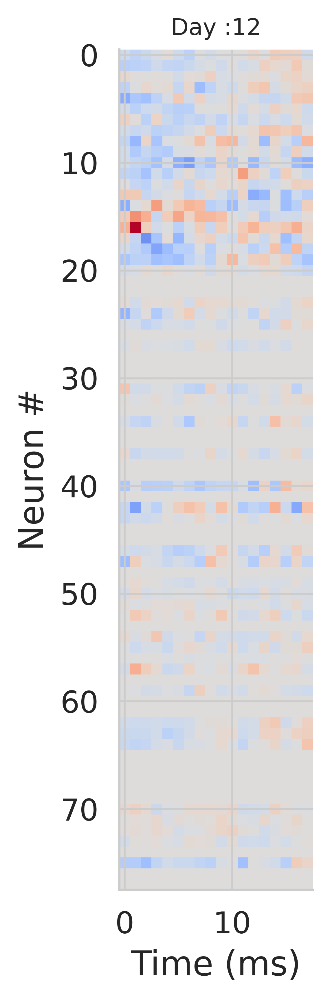

(78,)
13 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.8383838383838383
13 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.898989898989899
13 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.8888888888888888
13 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.7272727272727273
13 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.8686868686868687
(1404,) (1404,)


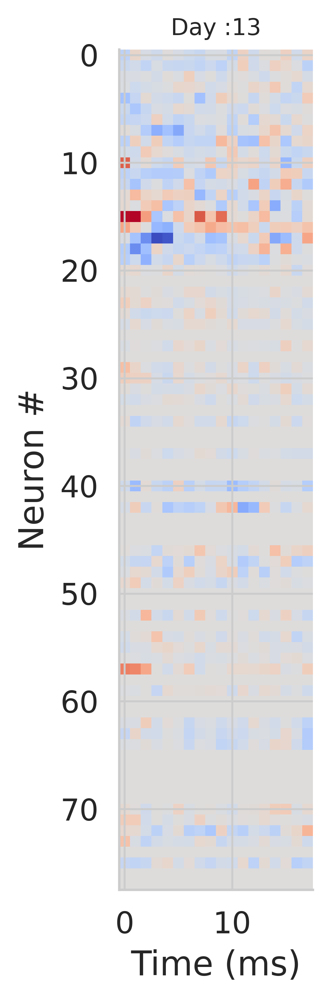

(78,)
14 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.898989898989899
14 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.797979797979798
14 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.9393939393939394
14 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.898989898989899
14 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.9595959595959596
(1404,) (1404,)


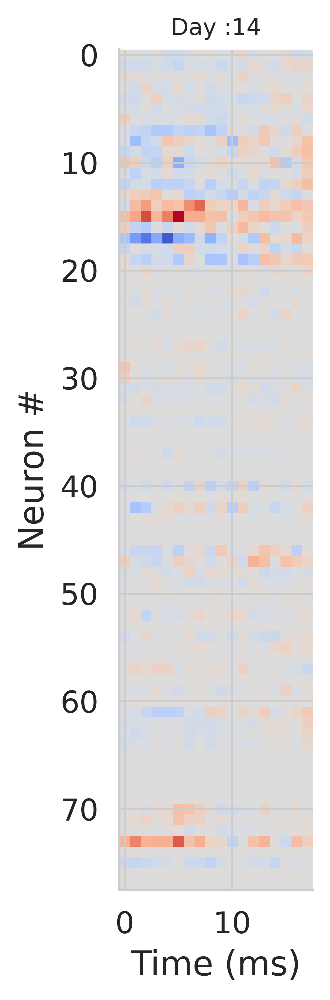

(78,)
15 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.9393939393939394
15 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.98989898989899
15 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.9292929292929293
15 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.9292929292929293
15 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.9191919191919192
(1404,) (1404,)


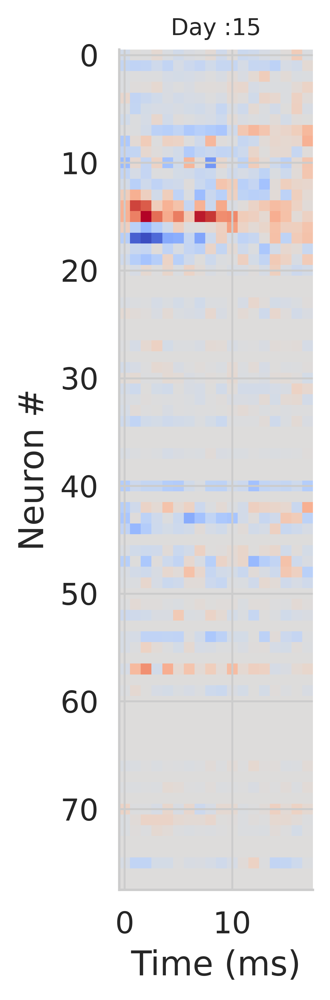

(78,)
16 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.8888888888888888
16 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.9393939393939394
16 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.9292929292929293
16 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.9191919191919192
16 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.9090909090909091
(1404,) (1404,)


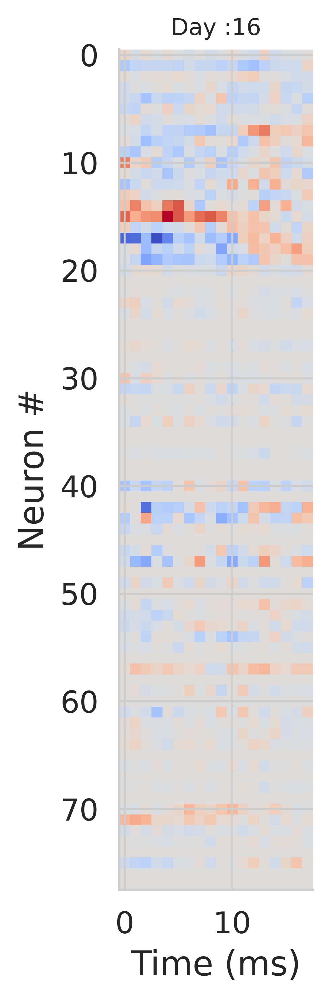

(78,)
17 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.9191919191919192
17 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.9191919191919192
17 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.9191919191919192
17 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.8888888888888888
17 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
R2 was 1.0
Test accuracy was 0.9595959595959596
(1404,) (1404,)


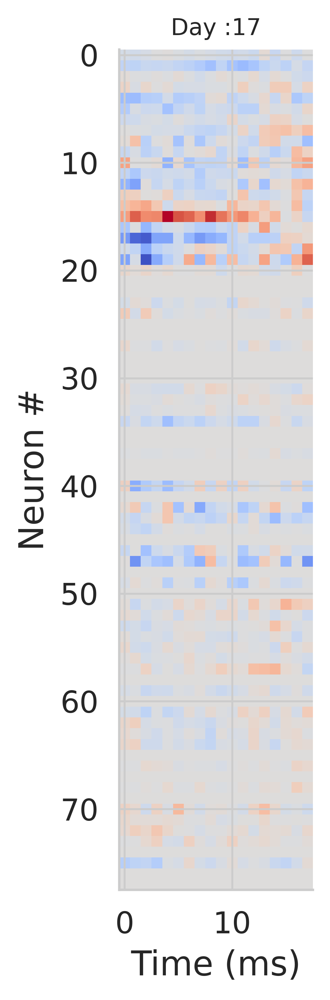

(78,)


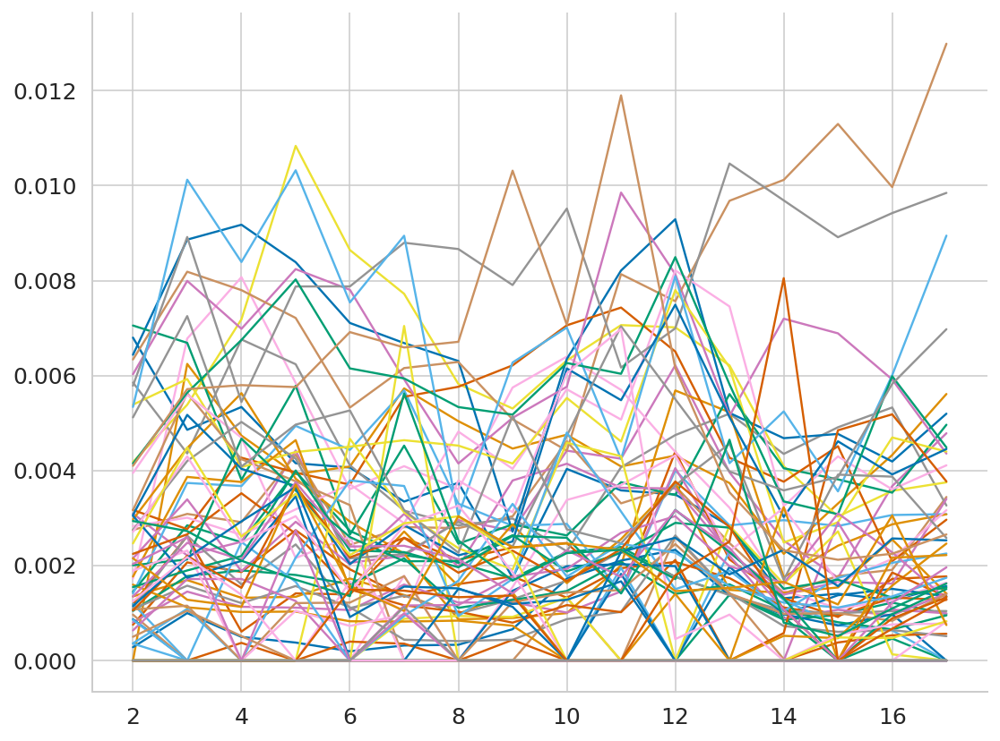

In [ ]:
## Considering only day 2 to day 17 and bootstrapping 300 trials from each day 
## USE OLD plot_coefs function
neural_recordings = bmi_direct_indirect_stacked[:,:,20:38][filter_trial_idx,:,:]
day = get_trial_by_day(sess_ID[filter_trial_idx], bmi_day )

from sklearn.model_selection import train_test_split
from sklearn import linear_model

# Initializing a linear model 
my_linear_model = linear_model.LogisticRegression(penalty='l2', solver = 'lbfgs', max_iter = 10000,C = 1.0)
r2_train = np.zeros((18,5))
r2_test = np.zeros((18,5))
weights_day = []

for i in range(2,18):
  data = getdata_day(neural_recordings,i, day )
  # if i == 1:
  #   print(i,i)
  #   target = target_direction[0:day[1]+1]
  # else:
  #   print(i)
  target = target_direction[day[i-1]:day[i]]

  for j in range(5):

    np.random.seed(123+j)
    idx = np.arange(0,len(data),1)
    random_idx = np.random.choice(idx, 300)
    sample_data = data[random_idx] 
    sample_target = target[random_idx]
    print(i, sample_data.shape)

    data_train, data_test, outcome_train, outcome_test = train_test_split(sample_data, sample_target , test_size=0.33, random_state=np.random.randint(4000))

    print(data_train.shape)
    print(outcome_train.shape)

    # Concatenating the third dimension 
    X_train = np.reshape(data_train, (np.shape(data_train)[0],-1))
    print(X_train.shape)
    X_test = np.reshape(data_test, (np.shape(data_test)[0],-1))

    ## Z score data 
    ## For Z scoring, we will calculate the mean and std. deviation for the training dataset each day and apply the same z score parameters for test data 
    ## Z-score inputs 
    # train_mean=np.nanmean(X_train,axis=0)
    # train_std=np.nanstd(X_train,axis=0)
    # X_train=(X_train-train_mean)/train_std
    # X_test=(X_test-train_mean)/train_std

    # Model fitting
    my_linear_model.fit(X_train, outcome_train)

    # R2 model fitting score
    r2_train[i,j] = my_linear_model.score(X_train,outcome_train)
    print("R2 was",r2_train[i,j])

    r2_test[i,j]=my_linear_model.score(X_test,outcome_test)
    print("Test accuracy was",r2_test[i,j])

  print(my_linear_model.coef_[0].shape, my_linear_model.coef_[1].shape)
  n_neurons = data_train.shape[1]
  n_bins_per_trial = data_train.shape[2]
  plot_coefs(my_linear_model,n_neurons, n_bins_per_trial,i)

  coefficients = my_linear_model.coef_[1].reshape(n_neurons, n_bins_per_trial)
  mean_weight = np.mean(np.abs(coefficients), axis = 1)
  weights_day.append(mean_weight)
  print(mean_weight.shape)

  if i == 2:
    coef_2 = coefficients
  if i == 5:
    coef_5 = coefficients
  if i == 10:
    coef_10 = coefficients
  if i == 13:
    coef_13 = coefficients
  if i == 16:
    coef_16 = coefficients
  

plt.figure()
plt.plot(np.arange(2,18), weights_day)

{1: 31, 2: 707, 3: 1306, 4: 2326, 5: 3051, 6: 3371, 7: 4449, 8: 5503, 9: 6809, 10: 7557, 11: 8652, 12: 9404, 13: 10429, 14: 10867, 15: 11668, 16: 12064, 17: 12756}
2 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
2 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
2 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
2 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
2 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
(78,)
3 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
3 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
3 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
3 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
3 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
(78,)
4 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
4 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
4 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
4 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
4 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
(78,)
5 (300, 78, 18)
(201, 78, 18)
(201,)
(201, 1404)
5 (300, 78, 18)
(201, 78, 18)
(201

<Figure size 1728x360 with 0 Axes>

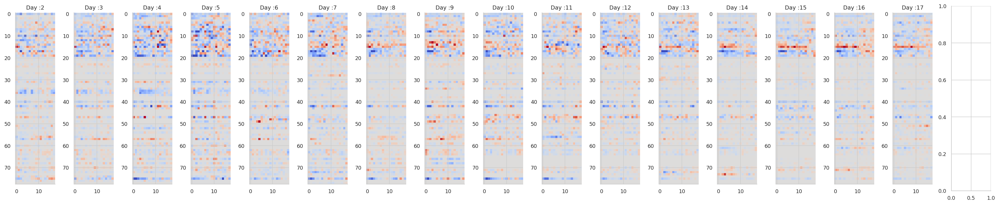

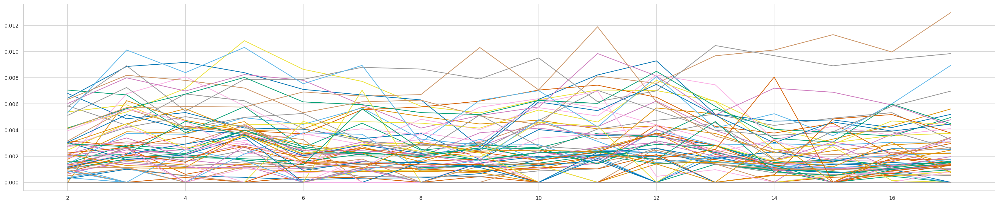

In [34]:
## Bootstrapping and running the linear regression model based on daily trials  

from sklearn.model_selection import train_test_split
from sklearn import linear_model

sns.set_context('paper')

neural_recordings = bmi_direct_indirect_stacked[:,:,20:38][filter_trial_idx,:,:]
day = get_trial_by_day(sess_ID[filter_trial_idx], bmi_day )

# Initializing a linear model 
my_linear_model_1 = linear_model.LogisticRegression(penalty='l2', solver = 'lbfgs', max_iter = 10000,C = 1.0)
my_linear_model_2 = linear_model.LogisticRegression(penalty='l2', solver = 'lbfgs', max_iter = 10000,C = 1.0)
my_linear_model_3 = linear_model.LogisticRegression(penalty='l2', solver = 'lbfgs', max_iter = 10000,C = 1.0)
my_linear_model_4 = linear_model.LogisticRegression(penalty='l2', solver = 'lbfgs', max_iter = 10000,C = 1.0)
my_linear_model_5 = linear_model.LogisticRegression(penalty='l2', solver = 'lbfgs', max_iter = 10000,C = 1.0)


# r2_neuron_drop_train = np.zeros((neural_recordings.shape[1],5))
# r2_neuron_drop_test = np.zeros_like(r2_neuron_drop_train)
days_to_check = [2, 10, 16]
r2_train = np.zeros((18,5))
r2_test = np.zeros_like(r2_train)
weights_day = []

plt.rcParams['figure.figsize']=(24,5)
plt.figure(figsize =(24,5))
fig, ax = plt.subplots(1,17)

for i in range(2,18):
  data = getdata_day(neural_recordings,i, day )
  # if i == 1:
  #   print(i,i)
  #   target = target_direction[0:day[1]+1]
  # else:
  #   print(i)
  target = target_direction[day[i-1]:day[i]]

  for j in range(5):

    np.random.seed(123+j)
    idx = np.arange(0,len(data),1)
    random_idx = np.random.choice(idx, 300)
    sample_data = data[random_idx] 
    sample_target = target[random_idx]
    print(i, sample_data.shape)

    # if i in days_to_check:
    #   neuron_drop_curve(sample_data, sample_target, r2_neuron_drop_train, r2_neuron_drop_test, True)
    data_train, data_test, outcome_train, outcome_test = train_test_split(sample_data, sample_target , test_size=0.33, random_state=np.random.randint(4000))
    
    print(data_train.shape)
    print(outcome_train.shape)
    n_neurons = data_train.shape[1]
    n_bins_per_trial = data_train.shape[2]

    # Concatenating the third dimension 
    X_train = np.reshape(data_train, (np.shape(data_train)[0],-1))
    print(X_train.shape)
    X_test = np.reshape(data_test, (np.shape(data_test)[0],-1))

    # Model fitting
    # We have 5 models for 5 iterations.
    if j+1 == 1:
      my_linear_model, r2_train[i,j], r2_test[i,j], coefficients, mean_weight= model_fit(my_linear_model_1, X_train, X_test, n_neurons, n_bins_per_trial, i, True, ax[i-2])
    if j+1 == 2:
      my_linear_model, r2_train[i,j], r2_test[i,j], coefficients, mean_weight= model_fit(my_linear_model_2, X_train, X_test, n_neurons, n_bins_per_trial, i, False)
    if j+1 == 3:
      my_linear_model, r2_train[i,j], r2_test[i,j], coefficients, mean_weight= model_fit(my_linear_model_3, X_train, X_test, n_neurons, n_bins_per_trial, i, False)
    if j+1 == 4:
      my_linear_model, r2_train[i,j], r2_test[i,j], coefficients, mean_weight= model_fit(my_linear_model_4, X_train, X_test, n_neurons, n_bins_per_trial, i, False)
    if j+1 == 5:
      my_linear_model, r2_train[i,j], r2_test[i,j], coefficients, mean_weight= model_fit(my_linear_model_5, X_train, X_test, n_neurons, n_bins_per_trial, i, False)

  # print(my_linear_model.coef_[0].shape, my_linear_model.coef_[1].shape)
  # n_neurons = data_train.shape[1]
  # n_bins_per_trial = data_train.shape[2]
  # plot_coefs(my_linear_model,n_neurons, n_bins_per_trial,i)

  # coefficients = my_linear_model.coef_[1].reshape(n_neurons, n_bins_per_trial)
  # mean_weight = np.mean(np.abs(coefficients), axis = 1)
  weights_day.append(mean_weight)
  print(mean_weight.shape)

  if i == 2:
    coef_2 = coefficients
  if i == 3:
    coef_3 = coefficients
  if i == 4:
    coef_4 = coefficients
  if i == 5:
    coef_5 = coefficients
  if i == 6:
    coef_6 = coefficients
  if i == 7:
    coef_7 = coefficients
  if i == 8:
    coef_8 = coefficients
  if i == 9:
    coef_9 = coefficients
  if i == 10:
    coef_10 = coefficients
  if i == 13:
    coef_13 = coefficients
  if i == 16:
    coef_16 = coefficients

plt.figure()
plt.plot(np.arange(2,18), weights_day)

## Sparsification in Neuron weights 

In [35]:
def get_contribution(coef, neuron_idx):
  mean_weight = np.mean(np.abs(coef), axis = 1)
  
  sorted_idx = list(zip( *sorted( zip(mean_weight, neuron_idx), reverse=True ) ))
  print(sorted_idx[1])
  print(neuron_idx)
 
  neuron_contribution_idx = np.zeros(len(sorted_idx[1]))
  for i in range(len(sorted_idx[1])):
    neuron_contribution_idx[i] = np.argwhere((sorted_idx[1][i]==neuron_idx))
  print(neuron_contribution_idx)

  return neuron_contribution_idx.astype(int)

(78,)
(78,)
(78,)


Text(0.5, 1.0, 'Day 16')

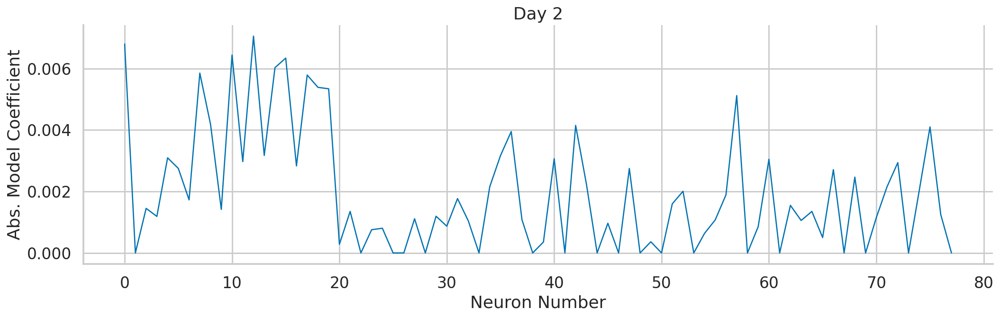

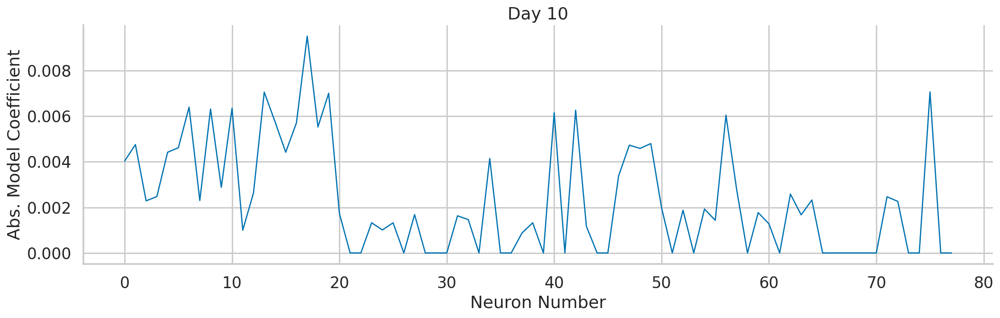

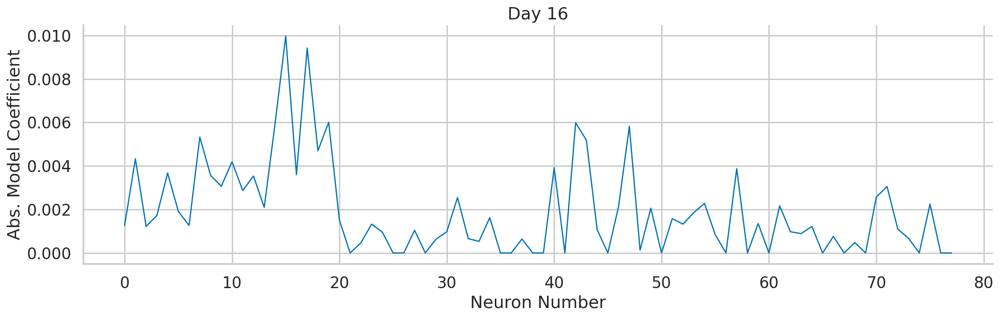

In [36]:
my_linear_model.coef_
# Plot weights over trial for each neuron - average over time bins 
sns.set_context('talk',rc={'lines.linewidth':1.3})
plt.figure(311, figsize = (15,5))
# coefficients = my_linear_model.coef_[1].reshape(n_neurons, n_bins_per_trial)
mean_weight = np.mean(np.abs(coef_2), axis = 1)
print(mean_weight.shape)
plt.plot(mean_weight)
plt.xlabel('Neuron Number')
plt.ylabel('Abs. Model Coefficient')
plt.title('Day 2')

plt.figure(312, figsize = (15,5))
# coefficients = my_linear_model.coef_[1].reshape(n_neurons, n_bins_per_trial)
mean_weight = np.mean(np.abs(coef_10), axis = 1)
print(mean_weight.shape)
plt.plot(mean_weight)
plt.xlabel('Neuron Number')
plt.ylabel('Abs. Model Coefficient')
plt.title('Day 10')

plt.figure(313, figsize = (15,5))
# coefficients = my_linear_model.coef_[1].reshape(n_neurons, n_bins_per_trial)
mean_weight = np.mean(np.abs(coef_16), axis = 1)
print(mean_weight.shape)
plt.plot(mean_weight)
plt.xlabel('Neuron Number')
plt.ylabel('Abs. Model Coefficient')
plt.title('Day 16')

In [37]:
direct_indirect_idx_stacked = np.hstack((direct_idx_2, indirect_idx))
n_cont_idx_direct = get_contribution(coef_16, direct_indirect_idx_stacked)

(545, 595, 635, 230, 520, 270, 215, 235, 610, 51, 300, 220, 335, 140, 590, 225, 395, 265, 546, 355, 540, 106, 315, 615, 356, 260, 440, 275, 180, 311, 105, 175, 305, 5, 340, 15, 310, 50, 185, 85, 370, 550, 236, 55, 360, 100, 20, 365, 320, 530, 560, 120, 195, 95, 145, 535, 10, 271, 630, 625, 605, 536, 531, 480, 345, 336, 325, 276, 240, 221, 210, 196, 181, 176, 75, 45, 21, 6)
[ 50  51  85 105 140 180 185 215 225 265 300 355 395 440 520 545 590 595
 610 635   5   6  10  15  20  21  45  55  75  95 100 106 120 145 175 176
 181 195 196 210 220 221 230 235 236 240 260 270 271 275 276 305 310 311
 315 320 325 335 336 340 345 356 360 365 370 480 530 531 535 536 540 546
 550 560 605 615 625 630]
[15. 17. 19. 42. 14. 47.  7. 43. 18.  1. 10. 40. 57.  4. 16.  8. 12.  9.
 71. 11. 70. 31. 54. 75. 61. 46. 13. 49.  5. 53.  3. 34. 51. 20. 59. 23.
 52.  0.  6.  2. 64. 72. 44. 27. 62. 30. 24. 63. 55. 66. 73. 32. 37. 29.
 33. 68. 22. 48. 77. 76. 74. 69. 67. 65. 60. 58. 56. 50. 45. 41. 39. 38.
 36. 35. 28. 2

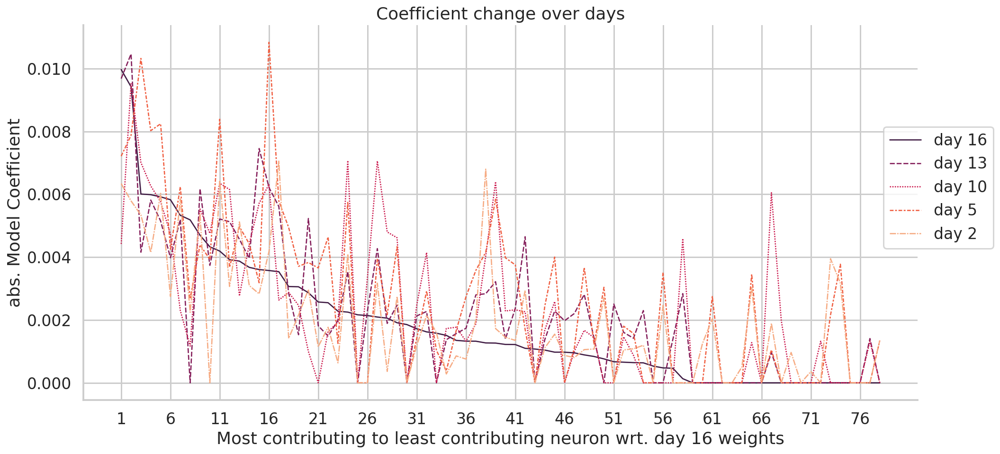

In [39]:
## Generating a plot to show how the contribution of each neuron changes 

mean_weight_day2 = np.mean(np.abs(coef_2), axis = 1)
# print(mean_weight_day2)
day2_w = mean_weight_day2[n_cont_idx_direct]

n = (len(mean_weight_day2))+1

mean_weight_day5 = np.mean(np.abs(coef_5), axis = 1)
day5_w = mean_weight_day5[n_cont_idx_direct]

mean_weight_day10 = np.mean(np.abs(coef_10), axis = 1)
day10_w = mean_weight_day10[n_cont_idx_direct]

mean_weight_day13 = np.mean(np.abs(coef_13), axis = 1)
day13_w = mean_weight_day13[n_cont_idx_direct]

mean_weight_day16 = np.mean(np.abs(coef_16), axis = 1)
day16_w = mean_weight_day16[n_cont_idx_direct]

y_data = np.vstack((day16_w,day13_w,day10_w, day5_w, day2_w))

sns.set_context('talk',rc={'lines.linewidth':1.3})
# sns.dark_palette("#69d", reverse=True, as_cmap=True)

plt.figure(figsize = (15,7))
sns.lineplot(data = y_data.T, palette = 'rocket')
plt.title('Coefficient change over days')
plt.xticks(np.arange(0,n-1,5),np.arange(1,n,5))
plt.xlabel('Most contributing to least contributing neuron wrt. day 16 weights')
plt.ylabel('abs. Model Coefficient')
plt.legend(['day 16','day 13','day 10','day 5','day 2'],bbox_to_anchor = (1.10,0.75))
plt.savefig('coeff_change_vs_days_bmi.png')
# plt.plot(day16_w)
# plt.plot(day10_w)
# plt.plot(day5_w)
# plt.plot(day_w)

(395, 50, 300, 545, 520, 215, 595, 610, 635, 335, 225, 230, 615, 181, 440, 176, 140, 220, 345, 355, 550, 590, 270, 180, 530, 535, 235, 546, 175, 605, 310, 325, 106, 185, 305, 360, 85, 265, 6, 370, 625, 95, 105, 540, 55, 195, 320, 365, 120, 240, 100, 340, 20, 15, 315, 480, 275, 210, 5, 630, 560, 536, 531, 356, 336, 311, 276, 271, 260, 236, 221, 196, 145, 75, 51, 45, 21, 10)
[ 50  51  85 105 140 180 185 215 225 265 300 355 395 440 520 545 590 595
 610 635   5   6  10  15  20  21  45  55  75  95 100 106 120 145 175 176
 181 195 196 210 220 221 230 235 236 240 260 270 271 275 276 305 310 311
 315 320 325 335 336 340 345 356 360 365 370 480 530 531 535 536 540 546
 550 560 605 615 625 630]
[12.  0. 10. 15. 14.  7. 17. 18. 19. 57.  8. 42. 75. 36. 13. 35.  4. 40.
 60. 11. 72. 16. 47.  5. 66. 68. 43. 71. 34. 74. 52. 56. 31.  6. 51. 62.
  2.  9. 21. 64. 76. 29.  3. 70. 27. 37. 55. 63. 32. 45. 30. 59. 24. 23.
 54. 65. 49. 39. 20. 77. 73. 69. 67. 61. 58. 53. 50. 48. 46. 44. 41. 38.
 33. 28.  1. 2

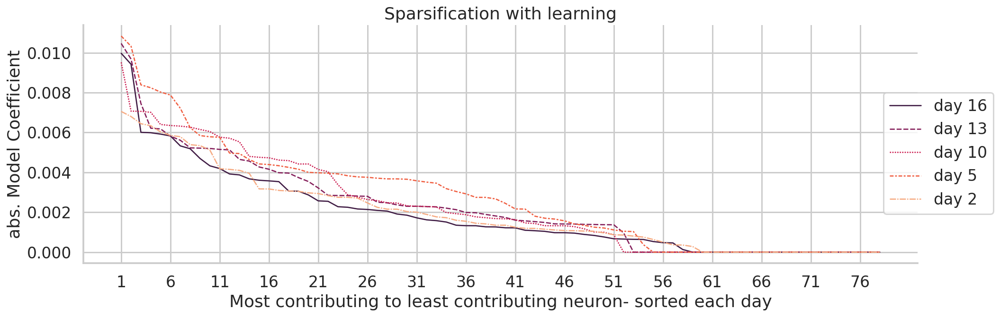

In [40]:
## Generating a plot to show sparsification across days  

direct_indirect_idx_stacked = np.hstack((direct_idx_2, indirect_idx))

n_cont_idx_2 = get_contribution(coef_2, direct_indirect_idx_stacked)
n_cont_idx_5 = get_contribution(coef_5, direct_indirect_idx_stacked)
n_cont_idx_10 = get_contribution(coef_10, direct_indirect_idx_stacked)
n_cont_idx_13 = get_contribution(coef_13, direct_indirect_idx_stacked)
n_cont_idx_16 = get_contribution(coef_16, direct_indirect_idx_stacked)

mean_weight_day2 = np.mean(np.abs(coef_2), axis = 1)
# print(mean_weight_day2)
day2_w = mean_weight_day2[n_cont_idx_2]

n = (len(mean_weight_day2))+1

mean_weight_day5 = np.mean(np.abs(coef_5), axis = 1)
day5_w = mean_weight_day5[n_cont_idx_5]

mean_weight_day10 = np.mean(np.abs(coef_10), axis = 1)
day10_w = mean_weight_day10[n_cont_idx_10]

mean_weight_day13 = np.mean(np.abs(coef_13), axis = 1)
day13_w = mean_weight_day13[n_cont_idx_13]

mean_weight_day16 = np.mean(np.abs(coef_16), axis = 1)
day16_w = mean_weight_day16[n_cont_idx_16]

y_data = np.vstack((day16_w,day13_w,day10_w, day5_w, day2_w))

sns.set_context('talk',rc={'lines.linewidth':1.3})
# sns.dark_palette("#69d", reverse=True, as_cmap=True)

plt.figure(figsize = (15,5))
sns.lineplot(data = y_data.T, palette = 'rocket')
plt.title('Sparsification with learning')
plt.xticks(np.arange(0,n-1,5),np.arange(1,n,5))
plt.xlabel('Most contributing to least contributing neuron- sorted each day')
plt.ylabel('abs. Model Coefficient')
plt.legend(['day 16','day 13','day 10','day 5','day 2'],bbox_to_anchor = (1.10,0.75))
plt.savefig('coeff_change_vs_days_bmi.png')
# plt.plot(day16_w)
# plt.plot(day10_w)
# plt.plot(day5_w)
# plt.plot(day_w)

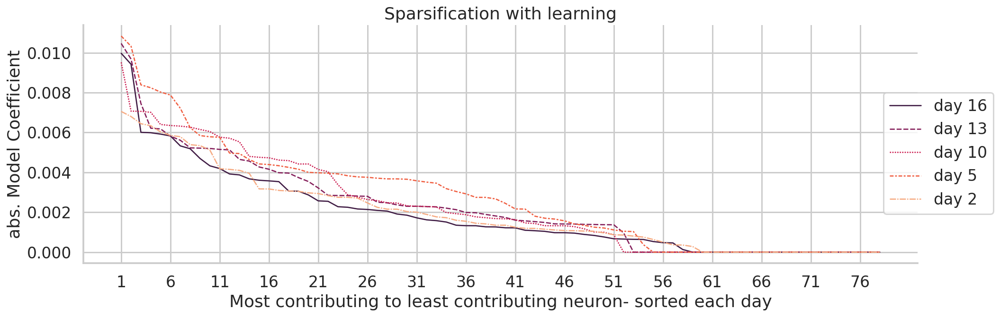

In [ ]:
sns.set_context('talk',rc={'lines.linewidth':1.3})
# sns.dark_palette("#69d", reverse=True, as_cmap=True)

plt.figure(figsize = (15,5))
sns.lineplot(data = y_data.T, palette = 'rocket')
plt.title('Sparsification with learning')
plt.xticks(np.arange(0,n-1,5),np.arange(1,n,5))
plt.xlabel('Most contributing to least contributing neuron- sorted each day')
plt.ylabel('abs. Model Coefficient')
plt.legend(['day 16','day 13','day 10','day 5','day 2'],bbox_to_anchor = (1.10,0.75))
plt.savefig('coeff_change_vs_days_bmi.png')

(395, 50, 300, 545, 520, 215, 595, 610, 635, 335, 225, 230, 615, 181, 440, 176, 140, 220, 345, 355, 550, 590, 270, 180, 530, 535, 235, 546, 175, 605, 310, 325, 106, 185, 305, 360, 85, 265, 6, 370, 625, 95, 105, 540, 55, 195, 320, 365, 120, 240, 100, 340, 20, 15, 315, 480, 275, 210, 5, 630, 560, 536, 531, 356, 336, 311, 276, 271, 260, 236, 221, 196, 145, 75, 51, 45, 21, 10)
[ 50  51  85 105 140 180 185 215 225 265 300 355 395 440 520 545 590 595
 610 635   5   6  10  15  20  21  45  55  75  95 100 106 120 145 175 176
 181 195 196 210 220 221 230 235 236 240 260 270 271 275 276 305 310 311
 315 320 325 335 336 340 345 356 360 365 370 480 530 531 535 536 540 546
 550 560 605 615 625 630]
[12.  0. 10. 15. 14.  7. 17. 18. 19. 57.  8. 42. 75. 36. 13. 35.  4. 40.
 60. 11. 72. 16. 47.  5. 66. 68. 43. 71. 34. 74. 52. 56. 31.  6. 51. 62.
  2.  9. 21. 64. 76. 29.  3. 70. 27. 37. 55. 63. 32. 45. 30. 59. 24. 23.
 54. 65. 49. 39. 20. 77. 73. 69. 67. 61. 58. 53. 50. 48. 46. 44. 41. 38.
 33. 28.  1. 2

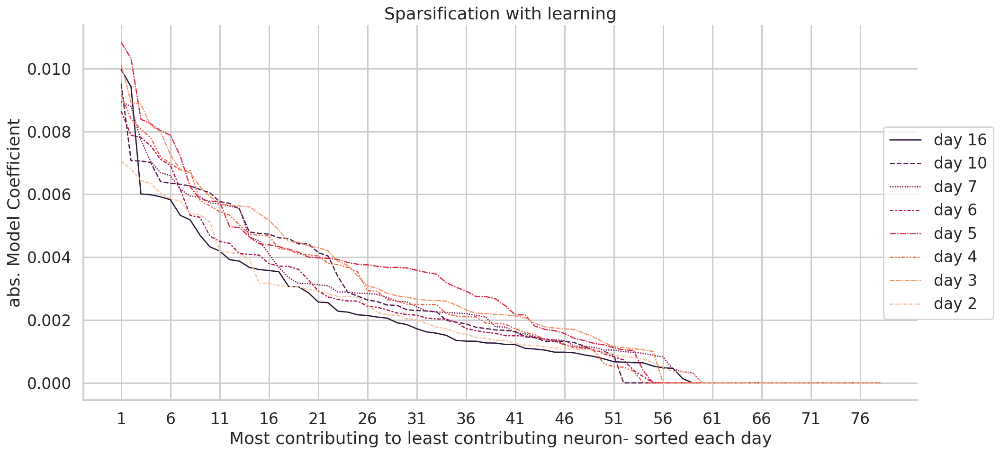

In [41]:
## Checking the sparsification for initial days vs day 16 
# y_data = []
# days = [2, 3, 4, 5, 6, 7, 8, 9, 0, 16]

# for i in days

n_cont_idx_2 = get_contribution(coef_2, direct_indirect_idx_stacked)
n_cont_idx_3 = get_contribution(coef_3, direct_indirect_idx_stacked)
n_cont_idx_4 = get_contribution(coef_4, direct_indirect_idx_stacked)

n_cont_idx_5 = get_contribution(coef_5, direct_indirect_idx_stacked)
n_cont_idx_6 = get_contribution(coef_6, direct_indirect_idx_stacked)
n_cont_idx_7 = get_contribution(coef_7, direct_indirect_idx_stacked)

n_cont_idx_10 = get_contribution(coef_10, direct_indirect_idx_stacked)
n_cont_idx_13 = get_contribution(coef_13, direct_indirect_idx_stacked)
n_cont_idx_16 = get_contribution(coef_16, direct_indirect_idx_stacked)

mean_weight_day2 = np.mean(np.abs(coef_2), axis = 1)
# print(mean_weight_day2)
day2_w = mean_weight_day2[n_cont_idx_2]

n = (len(mean_weight_day2))+1

mean_weight_day3 = np.mean(np.abs(coef_3), axis = 1)
day3_w = mean_weight_day3[n_cont_idx_3]

mean_weight_day4 = np.mean(np.abs(coef_4), axis = 1)
day4_w = mean_weight_day4[n_cont_idx_4]

mean_weight_day5 = np.mean(np.abs(coef_5), axis = 1)
day5_w = mean_weight_day5[n_cont_idx_5]

mean_weight_day6 = np.mean(np.abs(coef_6), axis = 1)
day6_w = mean_weight_day6[n_cont_idx_6]

mean_weight_day7 = np.mean(np.abs(coef_7), axis = 1)
day7_w = mean_weight_day7[n_cont_idx_7]

mean_weight_day10 = np.mean(np.abs(coef_10), axis = 1)
day10_w = mean_weight_day10[n_cont_idx_10]

# mean_weight_day13 = np.mean(np.abs(coef_13), axis = 1)
# day13_w = mean_weight_day13[n_cont_idx_13]

mean_weight_day16 = np.mean(np.abs(coef_16), axis = 1)
day16_w = mean_weight_day16[n_cont_idx_16]

y_data = np.vstack((day16_w, day10_w, day7_w, day6_w, day5_w, day4_w, day3_w, day2_w))

sns.set_context('talk',rc={'lines.linewidth':1.3})
# sns.dark_palette("#69d", reverse=True, as_cmap=True)

plt.figure(figsize = (15,7))
sns.lineplot(data = y_data.T, palette = 'rocket')
plt.title('Sparsification with learning')
plt.xticks(np.arange(0,n-1,5),np.arange(1,n,5))
plt.xlabel('Most contributing to least contributing neuron- sorted each day')
plt.ylabel('abs. Model Coefficient')
plt.legend(['day 16','day 10','day 7','day 6','day 5','day 4','day 3','day 2'],bbox_to_anchor = (1.10,0.75))
plt.savefig('coeff_change_vs_days_direct2.png')

(395, 50, 300, 545, 520, 215, 595, 610, 635, 335, 225, 230, 615, 181, 440, 176, 140, 220, 345, 355, 550, 590, 270, 180, 530, 535, 235, 546, 175, 605, 310, 325, 106, 185, 305, 360, 85, 265, 6, 370, 625, 95, 105, 540, 55, 195, 320, 365, 120, 240, 100, 340, 20, 15, 315, 480, 275, 210, 5, 630, 560, 536, 531, 356, 336, 311, 276, 271, 260, 236, 221, 196, 145, 75, 51, 45, 21, 10)
[ 50  51  85 105 140 180 185 215 225 265 300 355 395 440 520 545 590 595
 610 635   5   6  10  15  20  21  45  55  75  95 100 106 120 145 175 176
 181 195 196 210 220 221 230 235 236 240 260 270 271 275 276 305 310 311
 315 320 325 335 336 340 345 356 360 365 370 480 530 531 535 536 540 546
 550 560 605 615 625 630]
[12.  0. 10. 15. 14.  7. 17. 18. 19. 57.  8. 42. 75. 36. 13. 35.  4. 40.
 60. 11. 72. 16. 47.  5. 66. 68. 43. 71. 34. 74. 52. 56. 31.  6. 51. 62.
  2.  9. 21. 64. 76. 29.  3. 70. 27. 37. 55. 63. 32. 45. 30. 59. 24. 23.
 54. 65. 49. 39. 20. 77. 73. 69. 67. 61. 58. 53. 50. 48. 46. 44. 41. 38.
 33. 28.  1. 2

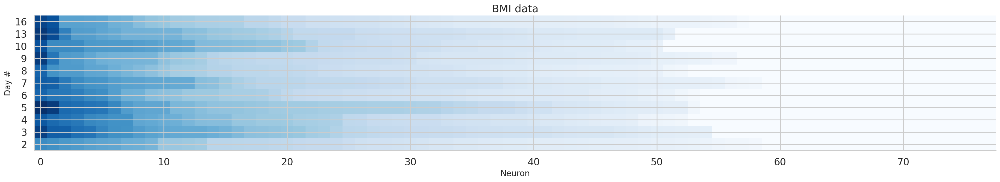

In [42]:
## Sparsification Heat map 

n_cont_idx_2 = get_contribution(coef_2, direct_indirect_idx_stacked)
n_cont_idx_3 = get_contribution(coef_3, direct_indirect_idx_stacked)
n_cont_idx_4 = get_contribution(coef_4, direct_indirect_idx_stacked)

n_cont_idx_5 = get_contribution(coef_5, direct_indirect_idx_stacked)
n_cont_idx_6 = get_contribution(coef_6, direct_indirect_idx_stacked)
n_cont_idx_7 = get_contribution(coef_7, direct_indirect_idx_stacked)
n_cont_idx_8 = get_contribution(coef_8, direct_indirect_idx_stacked)
n_cont_idx_9 = get_contribution(coef_9, direct_indirect_idx_stacked)

n_cont_idx_10 = get_contribution(coef_10, direct_indirect_idx_stacked)
n_cont_idx_13 = get_contribution(coef_13, direct_indirect_idx_stacked)
n_cont_idx_16 = get_contribution(coef_16, direct_indirect_idx_stacked)

mean_weight_day2 = np.mean(np.abs(coef_2), axis = 1)
# print(mean_weight_day2)
day2_w = mean_weight_day2[n_cont_idx_2]

n = (len(mean_weight_day2))+1

mean_weight_day3 = np.mean(np.abs(coef_3), axis = 1)
day3_w = mean_weight_day3[n_cont_idx_3]

mean_weight_day4 = np.mean(np.abs(coef_4), axis = 1)
day4_w = mean_weight_day4[n_cont_idx_4]

mean_weight_day5 = np.mean(np.abs(coef_5), axis = 1)
day5_w = mean_weight_day5[n_cont_idx_5]

mean_weight_day6 = np.mean(np.abs(coef_6), axis = 1)
day6_w = mean_weight_day6[n_cont_idx_6]

mean_weight_day7 = np.mean(np.abs(coef_7), axis = 1)
day7_w = mean_weight_day7[n_cont_idx_7]

mean_weight_day8 = np.mean(np.abs(coef_8), axis = 1)
day8_w = mean_weight_day8[n_cont_idx_8]

mean_weight_day9 = np.mean(np.abs(coef_9), axis = 1)
day9_w = mean_weight_day9[n_cont_idx_9]

mean_weight_day10 = np.mean(np.abs(coef_10), axis = 1)
day10_w = mean_weight_day10[n_cont_idx_10]

mean_weight_day13 = np.mean(np.abs(coef_13), axis = 1)
day13_w = mean_weight_day13[n_cont_idx_13]

mean_weight_day16 = np.mean(np.abs(coef_16), axis = 1)
day16_w = mean_weight_day16[n_cont_idx_16]

heat_map_data = np.vstack((day16_w, day13_w, day10_w,day9_w,day8_w, day7_w, day6_w, day5_w, day4_w, day3_w, day2_w))
print(heat_map_data.shape)
plt.figure()
# plt.sca(ax)
plt.imshow(heat_map_data, cmap = 'Blues')

#make it pretty
plt.ylabel("Day #", fontsize = 14)
plt.yticks(np.arange(11),[16, 13, 10, 9, 8, 7, 6, 5, 4, 3, 2])
plt.xlabel("Neuron", fontsize = 14)
# plt.colorbar(orientation = 'horizontal', shrink = .3, label="Contribution of bin to decision;'Vote' towards a positive decision.")
plt.tight_layout()
plt.title('BMI data')
plt.show()

In [ ]:
## Archive 
## Order the neuron index based on contribution 
""" This code is for all neurons - direct and indirect. Use the get_contribution function which is generalised for use with any number of neurons"""
print(direct_idx_2.shape, indirect_idx.shape)
direct_indirect_idx_stacked = np.hstack((direct_idx_2, indirect_idx))
print(direct_indirect_idx_stacked.shape)

sorted_idx = list(zip( *sorted( zip(mean_weight, direct_indirect_idx_stacked), reverse=True ) ))
print(sorted_idx[1])
print(direct_indirect_idx_stacked)
print(sorted_idx[1])
neuron_contribution_idx = np.zeros(len(sorted_idx[1]))
for i in range(len(sorted_idx[1])):
 neuron_contribution_idx[i] = np.argwhere((sorted_idx[1][i]==direct_indirect_idx_stacked))
print(neuron_contribution_idx)

(20,) (58,)
(78,)
(545, 595, 635, 230, 520, 270, 215, 235, 610, 51, 300, 220, 335, 140, 590, 225, 395, 265, 546, 355, 540, 106, 315, 615, 356, 260, 440, 275, 180, 311, 105, 175, 305, 5, 340, 15, 310, 50, 185, 85, 370, 550, 236, 55, 360, 100, 20, 365, 320, 530, 560, 120, 195, 95, 145, 535, 10, 271, 630, 625, 605, 536, 531, 480, 345, 336, 325, 276, 240, 221, 210, 196, 181, 176, 75, 45, 21, 6)
[ 50  51  85 105 140 180 185 215 225 265 300 355 395 440 520 545 590 595
 610 635   5   6  10  15  20  21  45  55  75  95 100 106 120 145 175 176
 181 195 196 210 220 221 230 235 236 240 260 270 271 275 276 305 310 311
 315 320 325 335 336 340 345 356 360 365 370 480 530 531 535 536 540 546
 550 560 605 615 625 630]
(545, 595, 635, 230, 520, 270, 215, 235, 610, 51, 300, 220, 335, 140, 590, 225, 395, 265, 546, 355, 540, 106, 315, 615, 356, 260, 440, 275, 180, 311, 105, 175, 305, 5, 340, 15, 310, 50, 185, 85, 370, 550, 236, 55, 360, 100, 20, 365, 320, 530, 560, 120, 195, 95, 145, 535, 10, 271, 630, 62

(16, 78)
(17,)
[ 7  8 11 14 17 21 23 27 30 36 41 52 57 58 60 66 70 71 73 77]
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19


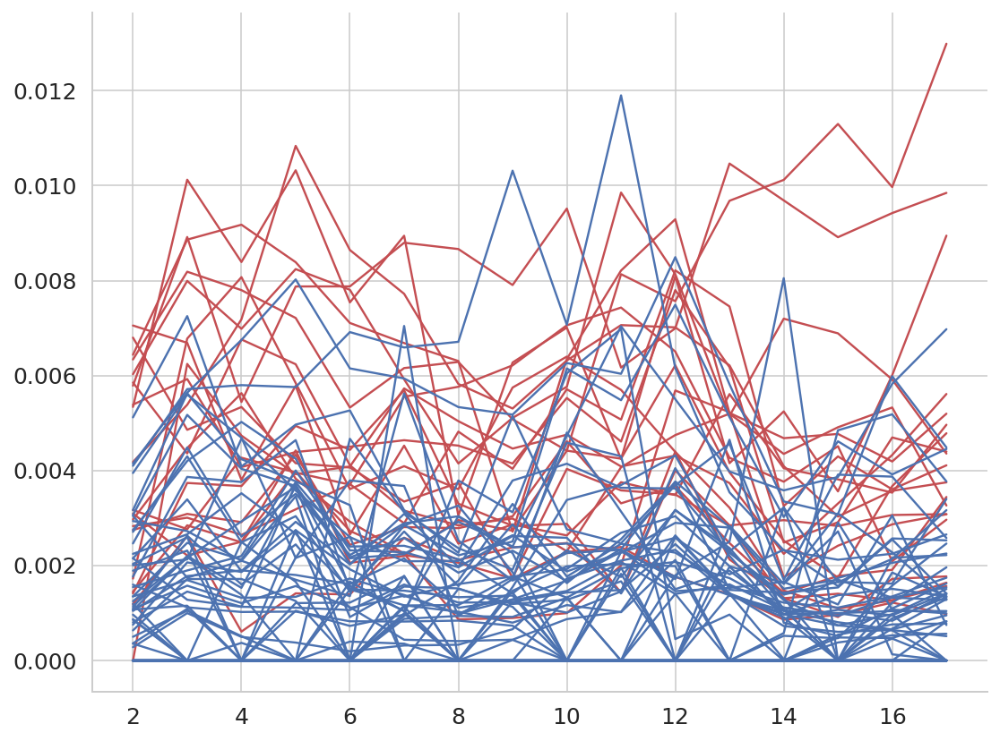

In [ ]:
print((np.array(weights_day)).shape)
print(np.arange(1,18).shape)
h = np.in1d(direct_indirect_idx,direct_idx_2)
h_idx = np.squeeze(np.where(h))
print(h_idx)
for i in range(78):
  if i in np.arange(20):
    plt.plot(np.arange(2,18),np.array(weights_day)[:,i], 'r-')
    print(i)
  else:
    plt.plot(np.arange(2,18),np.array(weights_day)[:,i], 'b-')

In [ ]:
print(direct_idx_2)
print(direct_indirect_idx)
print(np.where(h))

[ 50  51  85 105 140 180 185 215 225 265 300 355 395 440 520 545 590 595
 610 635]
[  5   6  10  15  20  21  45  50  51  55  75  85  95 100 105 106 120 140
 145 175 176 180 181 185 195 196 210 215 220 221 225 230 235 236 240 260
 265 270 271 275 276 300 305 310 311 315 320 325 335 336 340 345 355 356
 360 365 370 395 440 480 520 530 531 535 536 540 545 546 550 560 590 595
 605 610 615 625 630 635]
(array([ 7,  8, 11, 14, 17, 21, 23, 27, 30, 36, 41, 52, 57, 58, 60, 66, 70,
       71, 73, 77]),)


## R2 vs Days plot

In [ ]:
r2_test

array([[0.        , 0.        , 0.        , 0.        , 0.        ],
       [0.        , 0.        , 0.        , 0.        , 0.        ],
       [0.7979798 , 0.80808081, 0.75757576, 0.77777778, 0.77777778],
       [0.76767677, 0.70707071, 0.77777778, 0.6969697 , 0.82828283],
       [0.82828283, 0.77777778, 0.86868687, 0.72727273, 0.78787879],
       [0.78787879, 0.7979798 , 0.84848485, 0.75757576, 0.75757576],
       [0.77777778, 0.78787879, 0.84848485, 0.73737374, 0.76767677],
       [0.7979798 , 0.74747475, 0.75757576, 0.86868687, 0.77777778],
       [0.83838384, 0.76767677, 0.78787879, 0.91919192, 0.82828283],
       [0.77777778, 0.86868687, 0.77777778, 0.71717172, 0.84848485],
       [0.77777778, 0.78787879, 0.83838384, 0.83838384, 0.74747475],
       [0.82828283, 0.82828283, 0.82828283, 0.75757576, 0.80808081],
       [0.86868687, 0.84848485, 0.82828283, 0.74747475, 0.80808081],
       [0.83838384, 0.8989899 , 0.88888889, 0.72727273, 0.86868687],
       [0.8989899 , 0.7979798 , 0.

In [ ]:
### Grouping the prediction accuracy for bar plot 
### DONOT RUN EVERY TIME! CONTAINS INITIALIZATION
r2_group = pd.DataFrame()
r2_group['r2'] = r2_test[1:,0]
r2_group['day'] = np.arange(1,18)
r2_group['label'] = 'direct-indirect'
print(r2_group)
for i in range(1,5):
  r2_group = r2_group.append(pd.DataFrame({'r2': r2_test[1:,i],'day': np.arange(1,18),'label': 'direct-indirect'}), ignore_index=True)
# pd.concat([pd.DataFrame({'r2': r2_test[1:,1],'day': np.arange(1,18),'label': 'direct'})])
print(r2_group)
r2_group.to_csv('r2_group.csv')

          r2  day            label
0   0.797980    2  direct-indirect
1   0.767677    3  direct-indirect
2   0.828283    4  direct-indirect
3   0.787879    5  direct-indirect
4   0.777778    6  direct-indirect
5   0.797980    7  direct-indirect
6   0.838384    8  direct-indirect
7   0.777778    9  direct-indirect
8   0.777778   10  direct-indirect
9   0.828283   11  direct-indirect
10  0.868687   12  direct-indirect
11  0.838384   13  direct-indirect
12  0.898990   14  direct-indirect
13  0.939394   15  direct-indirect
14  0.888889   16  direct-indirect
15  0.919192   17  direct-indirect
          r2  day            label
0   0.797980    2  direct-indirect
1   0.767677    3  direct-indirect
2   0.828283    4  direct-indirect
3   0.787879    5  direct-indirect
4   0.777778    6  direct-indirect
5   0.797980    7  direct-indirect
6   0.838384    8  direct-indirect
7   0.777778    9  direct-indirect
8   0.777778   10  direct-indirect
9   0.828283   11  direct-indirect
10  0.868687   12  d

In [ ]:
print(r2_test)

for i in range(5):
  r2_group = r2_group.append(pd.DataFrame({'r2': r2_test[2:,i],'day': np.arange(2,18),'label': 'direct - 1'}), ignore_index=True)
# pd.concat([pd.DataFrame({'r2': r2_test[1:,1],'day': np.arange(1,18),'label': 'direct'})])
print(r2_group)
r2_group.to_csv('r2_group.csv')

[[0.         0.         0.         0.         0.        ]
 [0.         0.         0.         0.         0.        ]
 [0.68686869 0.67676768 0.70707071 0.64646465 0.68686869]
 [0.75757576 0.61616162 0.70707071 0.55555556 0.6969697 ]
 [0.66666667 0.67676768 0.71717172 0.64646465 0.68686869]
 [0.70707071 0.75757576 0.78787879 0.73737374 0.68686869]
 [0.77777778 0.73737374 0.82828283 0.6969697  0.71717172]
 [0.67676768 0.71717172 0.70707071 0.75757576 0.71717172]
 [0.73737374 0.70707071 0.6969697  0.87878788 0.81818182]
 [0.75757576 0.81818182 0.77777778 0.63636364 0.77777778]
 [0.71717172 0.76767677 0.78787879 0.77777778 0.73737374]
 [0.77777778 0.6969697  0.78787879 0.72727273 0.67676768]
 [0.83838384 0.80808081 0.76767677 0.67676768 0.75757576]
 [0.78787879 0.86868687 0.82828283 0.70707071 0.74747475]
 [0.84848485 0.78787879 0.87878788 0.85858586 0.91919192]
 [0.90909091 0.88888889 0.86868687 0.7979798  0.85858586]
 [0.80808081 0.8989899  0.87878788 0.91919192 0.87878788]
 [0.90909091 0

<Figure size 3000x2100 with 0 Axes>

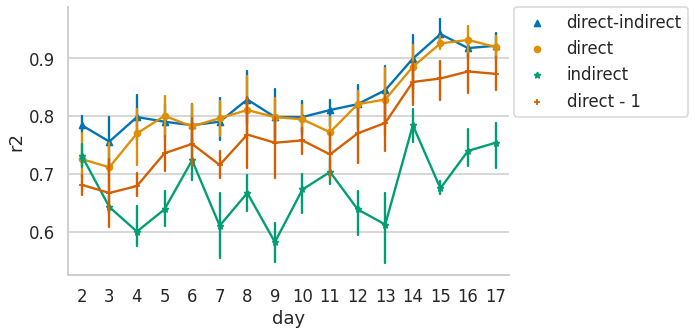

In [ ]:
sns.set_context('talk',rc={'lines.linewidth':1.3})
plt.figure(figsize = (10,7), dpi = 300)
g = sns.catplot(data = r2_group,x='day',y = 'r2', hue = 'label', kind = 'point', markers= ['^','o','*','+'], legend=  False, aspect = 2)
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0)
plt.tight_layout()
plt.show()
# sns.relplot(data = r2_group,x='day',y = 'r2', hue = 'label')

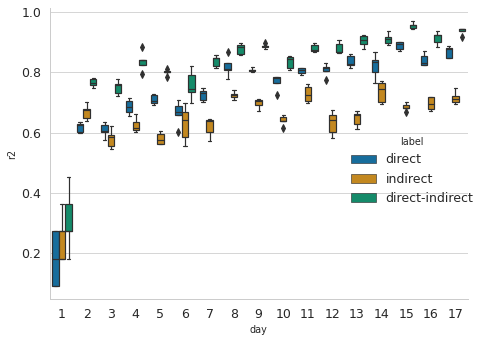

In [ ]:
# fig, ax = plt.subplots(111, figsize = (15,5))
sns.catplot(data = r2_group,x='day',y = 'r2', hue = 'label', kind = 'box')

## Neuron Dropping curve 

Goal: to show sparsification 

Todo:
- Generate No. of neurons vs Prediction accuracy curve for Day 2 vs Day 17 

In [ ]:
neural_recordings = bmi_direct_indirect_stacked[:,:,20:38][filter_trial_idx,:,:]
day = get_trial_by_day(sess_ID[filter_trial_idx], bmi_day )

{1: 31, 2: 707, 3: 1306, 4: 2326, 5: 3051, 6: 3371, 7: 4449, 8: 5503, 9: 6809, 10: 7557, 11: 8652, 12: 9404, 13: 10429, 14: 10867, 15: 11668, 16: 12064, 17: 12756}


In [ ]:
print(neural_recordings.shape)

(12757, 78, 18)


In [ ]:
def plot_coefs(fit_model,n_neurons,n_bins_per_trial, i,ax):
  """Makes a nice plot of the coefficients. Also can generate a plot of how weights of each neuron and timebin change over days"""

  # get the coefficients of your fit
  coefficients = fit_model.coef_[1].reshape(n_neurons, n_bins_per_trial)

  # show them
  plt.sca(ax)
  plt.imshow(coefficients, cmap = 'coolwarm', vmin = -np.max(coefficients), 
                                              vmax = np.max(coefficients))

  #make it pretty
  # plt.ylabel("Neuron #", fontsize = 14)
  # plt.xlabel("Time (ms)", fontsize = 14)
  # plt.colorbar(orientation = 'horizontal', shrink = .3, label="Contribution of bin to decision;'Vote' towards a positive decision.")
  plt.tight_layout()
  plt.title('Day :'+str(i))
  # plt.show()
  
def model_fit(my_linear_model, x_train, X_test, n_neurons, n_bins_per_trial, i, plot_true, ax=None):
  my_linear_model.fit(X_train, outcome_train)
  # R2 model fitting score
  r2_train = my_linear_model.score(X_train,outcome_train)
  # print("R2 was",r2_train)

  r2_test =my_linear_model.score(X_test,outcome_test)
  # print("Test accuracy was",r2_test)

  # print(my_linear_model.coef_[0].shape, my_linear_model.coef_[1].shape)
  if plot_true:
    plot_coefs(my_linear_model,n_neurons, n_bins_per_trial,i,ax)

  coefficients = my_linear_model.coef_[1].reshape(n_neurons, n_bins_per_trial)
  mean_weight = np.mean(np.abs(coefficients), axis = 1)

  return my_linear_model, r2_train, r2_test, coefficients, mean_weight

 **References**

 https://www.ncbi.nlm.nih.gov/pmc/articles/PMC4038767/pdf/fnsys-08-00102.pdf 

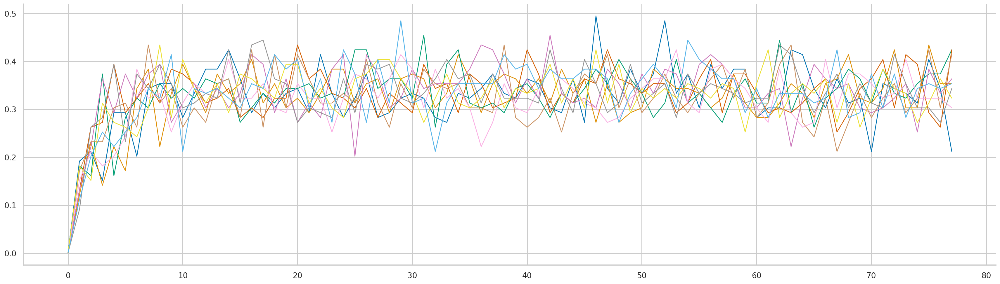

In [ ]:
# def neuron_drop_curve(sample_data, sample_target, r2_neuron_drop_train, r2_neuron_drop_test, random_index = True):
r2_neuron_drop_train = np.zeros((neural_recordings.shape[1],10))
r2_neuron_drop_test = np.zeros_like(r2_neuron_drop_train)

np.random.seed(123)
n_neurons = 78 #sample_data.shape[1]
n_idx = np.arange(0,n_neurons,1)
random_index = True
days_to_check = [2,16]

i = 2
# for i in days_to_check:
sample_data = getdata_day(neural_recordings,i, day )
sample_target = target_direction[day[i-1]:day[i]]

idx = np.arange(0,len(sample_data),1)
random_idx = np.random.choice(idx, 300)
data_trials = sample_data[random_idx] 
sample_target = target[random_idx]
# print(i, sample_data.shape)

if random_index:
  for it in range(10):
    np.random.seed(123+it)
    for iN in range(1,78):
      neuron_idx = np.random.choice(n_idx, iN)
      # print(neuron_idx)
      data = data_trials[:,neuron_idx,:] 
      # print(iN, sample_data.shape)

      my_NDC_model= linear_model.LogisticRegression(penalty='l2', solver = 'lbfgs', max_iter = 10000,C = 1.0)
      data_train, data_test, outcome_train, outcome_test = train_test_split(data, sample_target , test_size=0.33, random_state=np.random.randint(4000))

      # print(data_train.shape)
      # print(outcome_train.shape)
      n_neurons = data_train.shape[1]
      n_bins_per_trial = data_train.shape[2]

      # Concatenating the third dimension 
      X_train = np.reshape(data_train, (np.shape(data_train)[0],-1))
      # print(X_train.shape)
      X_test = np.reshape(data_test, (np.shape(data_test)[0],-1))
      
      # if i == 2: 
      #   my_linear_model_1.coef_ = coef_2
      # if i == 16:
      #   my_linear_model_1.coef_ = coef_16
      
      my_linear_model, r2_neuron_drop_train[iN, it], r2_neuron_drop_test[iN,it], coefficients, mean_weight= model_fit(my_NDC_model, X_train, X_test, n_neurons, n_bins_per_trial, i, False)

# if i == 2: 
r2_ndc_day2 = r2_neuron_drop_test 


plt.figure()
plt.plot(n_idx,r2_neuron_drop_test)
plt.show()

In [ ]:
## Day 16 
i = 16
# for i in days_to_check:
sample_data = getdata_day(neural_recordings,i, day )
sample_target = target_direction[day[i-1]:day[i]]

idx = np.arange(0,len(sample_data),1)
random_idx = np.random.choice(idx, 300)
data_trials = sample_data[random_idx] 
sample_target = target[random_idx]
# print(i, sample_data.shape)

if random_index:
  for it in range(10):
    np.random.seed(123+it)
    for iN in range(1,78):
      neuron_idx = np.random.choice(n_idx, iN)
      # print(neuron_idx)
      data = data_trials[:,neuron_idx,:] 
      # print(iN, sample_data.shape)

      my_NDC_model= linear_model.LogisticRegression(penalty='l2', solver = 'lbfgs', max_iter = 10000,C = 1.0)
      data_train, data_test, outcome_train, outcome_test = train_test_split(data, sample_target , test_size=0.33, random_state=np.random.randint(4000))

      # print(data_train.shape)
      # print(outcome_train.shape)
      n_neurons = data_train.shape[1]
      n_bins_per_trial = data_train.shape[2]

      # Concatenating the third dimension 
      X_train = np.reshape(data_train, (np.shape(data_train)[0],-1))
      # print(X_train.shape)
      X_test = np.reshape(data_test, (np.shape(data_test)[0],-1))
      
      # if i == 2: 
      #   my_linear_model_1.coef_ = coef_2
      # if i == 16:
      #   my_linear_model_1.coef_ = coef_16
      
      my_linear_model, r2_neuron_drop_train[iN, it], r2_neuron_drop_test[iN,it], coefficients, mean_weight= model_fit(my_NDC_model, X_train, X_test, n_neurons, n_bins_per_trial, i, False)
# if i == 16:
  r2_ndc_day16 = r2_neuron_drop_test

/usr/local/lib/python3.6/dist-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


In [ ]:
## Initialization - DO NOT RUN EVERYTIME 
r2_ndc = pd.DataFrame()
r2_ndc['r2'] = r2_ndc_day2[:,0]
r2_ndc['neurons'] = np.arange(1,79)
r2_ndc['day'] = '2'

for i in range(1,10):
  r2_ndc = r2_ndc.append(pd.DataFrame({'r2': r2_ndc_day2[:,i],'neurons': np.arange(1,79),'day': '2'}), ignore_index=True)

# r2_ndc.to_csv('r2_ndc_50iterations.csv')
print(r2_ndc)
r2_ndc.to_csv('r2_ndc_10iterations.csv')

           r2  neurons day
0    0.000000        1   2
1    0.191919        2   2
2    0.212121        3   2
3    0.151515        4   2
4    0.292929        5   2
..        ...      ...  ..
775  0.282828       74   2
776  0.343434       75   2
777  0.353535       76   2
778  0.343434       77   2
779  0.353535       78   2

[780 rows x 3 columns]


In [ ]:
for i in range(10):
  r2_ndc = r2_ndc.append(pd.DataFrame({'r2': r2_ndc_day16[:,i],'neurons': np.arange(1,79),'day': '16'}), ignore_index=True)

r2_ndc.to_csv('r2_ndc_10iterations.csv')

In [ ]:
r2_ndc

,r2,neurons,day
0,0.000000,1,2
1,0.191919,2,2
2,0.212121,3,2
3,0.151515,4,2
4,0.292929,5,2
...,...,...,...
1555,0.434343,74,16
1556,0.474747,75,16
1557,0.484848,76,16
1558,0.474747,77,16


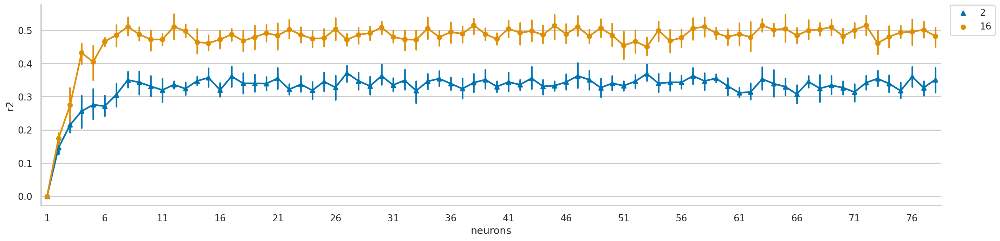

In [ ]:
sns.set_context('talk',rc={'lines.linewidth':1.3}, font_scale = 0.8)
plt.rcParams['figure.figsize']=(24,7)
# plt.figure(dpi = 300)
g = sns.catplot(data = r2_ndc,x='neurons',y = 'r2', hue = 'day', kind = 'point', markers= ['^','o','*','+'], legend=  False, aspect = 4)
plt.xticks(np.arange(0,78,5), np.arange(1,79,5))
# g.set(xticks=(range(78))) # <--- set the ticks first
# g.set(xticks= [])
# plt.xticks(np.arange(78),[0, 10, 20, 30, 40 ,50, 60 ,70, 80],rotation=20)
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0)
plt.tight_layout()
plt.show()

### Archive for Neuron Dropping curve


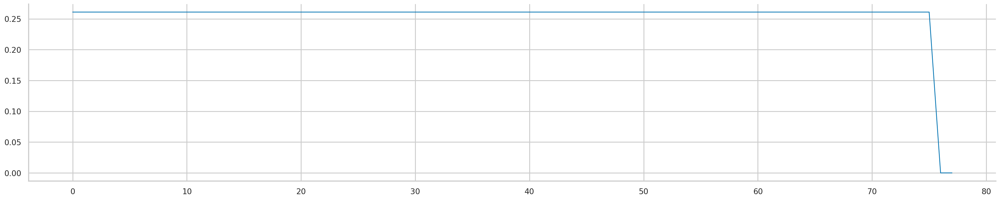

In [ ]:
## Code for Neuron Dropping Curve Method 2

# my_linear_model_1.coef_ = coef_2

n_idx = list(np.arange(len(neuron_contribution_idx)))
neuron_pool = neuron_contribution_idx
np.random.seed(123)
picked_neurons = []

coef_new = coef_16
r2_test = np.zeros(78)
i = 2
sample_data = getdata_day(neural_recordings,i, day )
sample_target = target_direction[day[i-1]:day[i]]

data_train, data_test, outcome_train, outcome_test = train_test_split(sample_data, sample_target , test_size=0.33, random_state=np.random.randint(4000))

# Concatenating the third dimension 
X_train = np.reshape(data_train, (np.shape(data_train)[0],-1))
# print(X_train.shape)
X_test = np.reshape(data_test, (np.shape(data_test)[0],-1))

for iN in range(len(neuron_contribution_idx)-1):
  this_pick = np.random.choice(n_idx,1)
  # print(this_pick)
  # neuron_idx = np.random.choice(n_idx, iN)

  picked_neurons.append(this_pick)
  n_idx.remove(this_pick)
  # print(n_idx) 

  neuron_pool = neuron_contribution_idx[np.array(n_idx)]
  # print(neuron_pool.shape)

  # Set coefficient to Zero
  coef_new[picked_neurons,:] = 0
  
  this_coef = np.reshape(coef_new, 1404)
  # print(this_coef.shape)
  my_linear_model.coef_[1] = this_coef

  r2_test[iN] = my_linear_model.score(X_train,outcome_train)
  # print(r2_test)

plt.plot(r2_test)

In [ ]:
neuron_pool

array([66.])

In [ ]:
my_linear_model.coef_[1] = coef_2
my_linear_model.score(X_test,outcome_test)

In [ ]:
# neuron_contribution_idx[np.array(n_idx)]
# n_idx = np.array(n_idx)[:76]
# print(neuron_pool.max)
# print(n_idx.shape)
# print(neuron_contribution_idx[n_idx].shape)
coef_2.shape

(78, 18)

Text(0.5, 1.0, 'Neuron Dropping Curve')

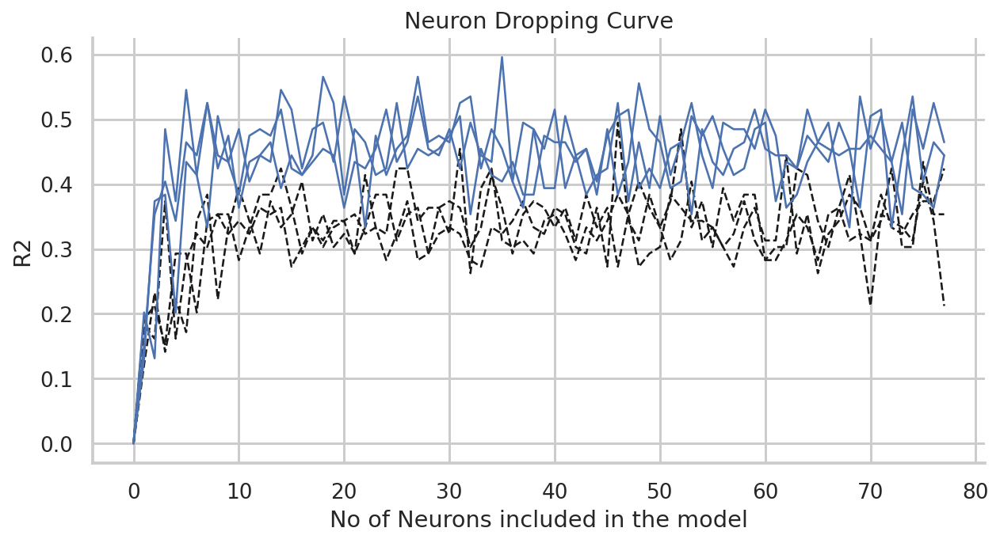

In [ ]:
# r2_ndc_day2 = r2_neuron_drop_test 
# r2_ndc_day16 = r2_neuron_drop_test 

plt.rcParams['figure.figsize']=(9,5)
plt.plot(n_idx,r2_ndc_day2,'--k')
plt.plot(n_idx,r2_ndc_day16,'-b')
# plt.errorbar(n_idx,r2_ndc_day2.mean(1)+r2_ndc_day2.std(1))
# plt.plot(r2_ndc_day2,'--b')
plt.xlabel('No of Neurons included in the model')
plt.ylabel('R2')
plt.title('Neuron Dropping Curve')

In [ ]:
### Grouping the prediction accuracy for bar plot for NDC
### DONOT RUN EVERY TIME! CONTAINS INITIALIZATION
r2_ndc = pd.DataFrame()
r2_ndc['r2'] = r2_ndc_day2[:,0]
r2_ndc['neurons'] = np.arange(1,79)
r2_ndc['day'] = '2'
print(r2_ndc)
for i in range(1,3):
  r2_ndc = r2_ndc.append(pd.DataFrame({'r2': r2_ndc_day2[:,i],'neurons': np.arange(1,79),'day': '2'}), ignore_index=True)
# pd.concat([pd.DataFrame({'r2': r2_test[1:,1],'day': np.arange(1,18),'label': 'direct'})])
print(r2_ndc)
r2_ndc.to_csv('r2_ndc.csv')

          r2  neurons day
0   0.000000        1   2
1   0.191919        2   2
2   0.212121        3   2
3   0.151515        4   2
4   0.292929        5   2
5   0.292929        6   2
6   0.202020        7   2
7   0.343434        8   2
8   0.353535        9   2
9   0.353535       10   2
10  0.282828       11   2
11  0.333333       12   2
12  0.383838       13   2
13  0.383838       14   2
14  0.424242       15   2
15  0.363636       16   2
16  0.292929       17   2
17  0.333333       18   2
18  0.303030       19   2
19  0.333333       20   2
20  0.343434       21   2
21  0.292929       22   2
22  0.414141       23   2
23  0.333333       24   2
24  0.282828       25   2
25  0.323232       26   2
26  0.373737       27   2
27  0.282828       28   2
28  0.292929       29   2
29  0.323232       30   2
30  0.333333       31   2
31  0.323232       32   2
32  0.282828       33   2
33  0.272727       34   2
34  0.333333       35   2
35  0.323232       36   2
36  0.343434       37   2
37  0.373737

In [ ]:
for i in range(3):
  r2_ndc = r2_ndc.append(pd.DataFrame({'r2': r2_ndc_day16[:,i],'neurons': np.arange(1,79),'day': '16'}), ignore_index=True)

r2_ndc.to_csv('r2_ndc.csv')
print(r2_ndc)

           r2  neurons day
0    0.000000        1   2
1    0.191919        2   2
2    0.212121        3   2
3    0.151515        4   2
4    0.292929        5   2
5    0.292929        6   2
6    0.202020        7   2
7    0.343434        8   2
8    0.353535        9   2
9    0.353535       10   2
10   0.282828       11   2
11   0.333333       12   2
12   0.383838       13   2
13   0.383838       14   2
14   0.424242       15   2
15   0.363636       16   2
16   0.292929       17   2
17   0.333333       18   2
18   0.303030       19   2
19   0.333333       20   2
20   0.343434       21   2
21   0.292929       22   2
22   0.414141       23   2
23   0.333333       24   2
24   0.282828       25   2
25   0.323232       26   2
26   0.373737       27   2
27   0.282828       28   2
28   0.292929       29   2
29   0.323232       30   2
30   0.333333       31   2
31   0.323232       32   2
32   0.282828       33   2
33   0.272727       34   2
34   0.333333       35   2
35   0.323232       36   2
3

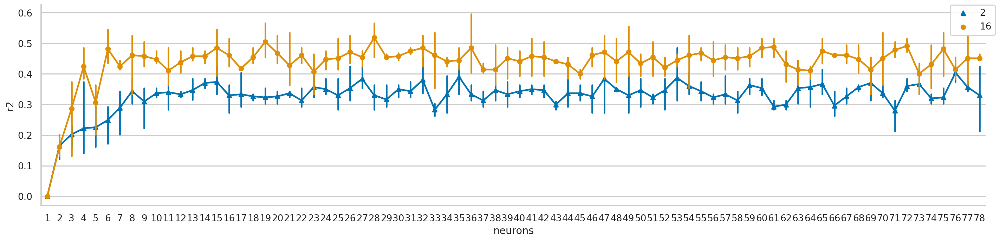

In [ ]:
sns.set_context('talk',rc={'lines.linewidth':1.3}, font_scale = 0.8)
plt.rcParams['figure.figsize']=(24,7)
# plt.figure(dpi = 300)
g = sns.catplot(data = r2_ndc,x='neurons',y = 'r2', hue = 'day', kind = 'point', markers= ['^','o','*','+'], legend=  False, aspect = 4)
# g.set_xticklabels([0, 10, 20, 30, 40 ,50, 60 ,70, 80])
# g.set(xticks=(range(78))) # <--- set the ticks first
# g.set(xticks= [])
# plt.xticks(np.arange(78),[0, 10, 20, 30, 40 ,50, 60 ,70, 80],rotation=20)
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0)
plt.tight_layout()
plt.show()

In [ ]:
r2_test

array([[0.        , 0.        , 0.        , 0.        , 0.        ],
       [0.        , 0.        , 0.        , 0.        , 0.        ],
       [0.7979798 , 0.80808081, 0.75757576, 0.77777778, 0.77777778],
       [0.76767677, 0.70707071, 0.77777778, 0.6969697 , 0.82828283],
       [0.82828283, 0.77777778, 0.86868687, 0.72727273, 0.78787879],
       [0.78787879, 0.7979798 , 0.84848485, 0.75757576, 0.75757576],
       [0.77777778, 0.78787879, 0.84848485, 0.73737374, 0.76767677],
       [0.7979798 , 0.74747475, 0.75757576, 0.86868687, 0.77777778],
       [0.83838384, 0.76767677, 0.78787879, 0.91919192, 0.82828283],
       [0.77777778, 0.86868687, 0.77777778, 0.71717172, 0.84848485],
       [0.77777778, 0.78787879, 0.83838384, 0.83838384, 0.74747475],
       [0.82828283, 0.82828283, 0.82828283, 0.75757576, 0.80808081],
       [0.86868687, 0.84848485, 0.82828283, 0.74747475, 0.80808081],
       [0.83838384, 0.8989899 , 0.88888889, 0.72727273, 0.86868687],
       [0.8989899 , 0.7979798 , 0.

## Archive

In [ ]:
# r2 = pd.DataFrame({'r2_t1': r2_test[:,0],'r2_t2': r2_test[:,1],'r2_t3':r2_test[:,2],'r2_t4':r2_test[:,3],'r2_t5':r2_test[:,4]})

# r2_indirect = pd.DataFrame({'r2_t1': r2_test[:,0],'r2_t2': r2_test[:,1],'r2_t3':r2_test[:,2],'r2_t4':r2_test[:,3],'r2_t5':r2_test[:,4], 'day': np.arange(0,18)})
# r2_indirect['label'] = 'indirect'
# # r2['day'] = np.arange(0,18)
# print(r2_indirect)
# r2_indirect.to_csv('r2_indirect.csv')

r2_direct = pd.DataFrame({'r2_t1': r2_test[:,0],'r2_t2': r2_test[:,1],'r2_t3':r2_test[:,2],'r2_t4':r2_test[:,3],'r2_t5':r2_test[:,4], 'day': np.arange(0,18)})
r2_direct['label'] = 'direct'
# r2['day'] = np.arange(0,18)
print(r2_direct)
r2_direct.to_csv('r2_direct.csv')

       r2_t1     r2_t2     r2_t3     r2_t4     r2_t5  day   label
0   0.000000  0.000000  0.000000  0.000000  0.000000    0  direct
1   0.454545  0.272727  0.363636  0.272727  0.272727    1  direct
2   0.683036  0.718750  0.665179  0.718750  0.651786    2  direct
3   0.707071  0.712121  0.732323  0.696970  0.732323    3  direct
4   0.836795  0.798220  0.804154  0.801187  0.789318    4  direct
5   0.808333  0.812500  0.783333  0.770833  0.825000    5  direct
6   0.688679  0.679245  0.632075  0.716981  0.669811    6  direct
7   0.814607  0.803371  0.814607  0.789326  0.817416    7  direct
8   0.890805  0.847701  0.876437  0.887931  0.862069    8  direct
9   0.874710  0.870070  0.865429  0.883991  0.870070    9  direct
10  0.813765  0.850202  0.829960  0.829960  0.785425   10  direct
11  0.870166  0.886740  0.856354  0.878453  0.848066   11  direct
12  0.863454  0.827309  0.815261  0.883534  0.859438   12  direct
13  0.932153  0.896755  0.893805  0.911504  0.876106   13  direct
14  0.8758

In [ ]:
# r2 = pd.DataFrame()
# r2 = r2_direct
# print(r2)
frames = [r2_direct, r2_indirect]
r2 = pd.concat(frames)
print(r2)

# print(r2_indirect)

       r2_t1     r2_t2     r2_t3     r2_t4     r2_t5  day     label
0   0.000000  0.000000  0.000000  0.000000  0.000000    0    direct
1   0.454545  0.272727  0.363636  0.272727  0.272727    1    direct
2   0.683036  0.718750  0.665179  0.718750  0.651786    2    direct
3   0.707071  0.712121  0.732323  0.696970  0.732323    3    direct
4   0.836795  0.798220  0.804154  0.801187  0.789318    4    direct
5   0.808333  0.812500  0.783333  0.770833  0.825000    5    direct
6   0.688679  0.679245  0.632075  0.716981  0.669811    6    direct
7   0.814607  0.803371  0.814607  0.789326  0.817416    7    direct
8   0.890805  0.847701  0.876437  0.887931  0.862069    8    direct
9   0.874710  0.870070  0.865429  0.883991  0.870070    9    direct
10  0.813765  0.850202  0.829960  0.829960  0.785425   10    direct
11  0.870166  0.886740  0.856354  0.878453  0.848066   11    direct
12  0.863454  0.827309  0.815261  0.883534  0.859438   12    direct
13  0.932153  0.896755  0.893805  0.911504  0.87

In [ ]:
r2['mean'] = r2[['r2_t1','r2_t2','r2_t3','r2_t4','r2_t5']].mean(axis = 1)
r2['std'] = r2[['r2_t1','r2_t2','r2_t3','r2_t4','r2_t5']].std(axis = 1)
print(r2)

r2.to_csv('r2.csv')

       r2_t1     r2_t2     r2_t3     r2_t4  ...  day     label      mean       std
0   0.000000  0.000000  0.000000  0.000000  ...    0    direct  0.000000  0.000000
1   0.454545  0.272727  0.363636  0.272727  ...    1    direct  0.327273  0.081312
2   0.683036  0.718750  0.665179  0.718750  ...    2    direct  0.687500  0.030606
3   0.707071  0.712121  0.732323  0.696970  ...    3    direct  0.716162  0.015730
4   0.836795  0.798220  0.804154  0.801187  ...    4    direct  0.805935  0.018123
5   0.808333  0.812500  0.783333  0.770833  ...    5    direct  0.800000  0.022244
6   0.688679  0.679245  0.632075  0.716981  ...    6    direct  0.677358  0.030859
7   0.814607  0.803371  0.814607  0.789326  ...    7    direct  0.807865  0.011684
8   0.890805  0.847701  0.876437  0.887931  ...    8    direct  0.872989  0.018106
9   0.874710  0.870070  0.865429  0.883991  ...    9    direct  0.872854  0.007037
10  0.813765  0.850202  0.829960  0.829960  ...   10    direct  0.821862  0.024122
11  

In [ ]:
r2['day']

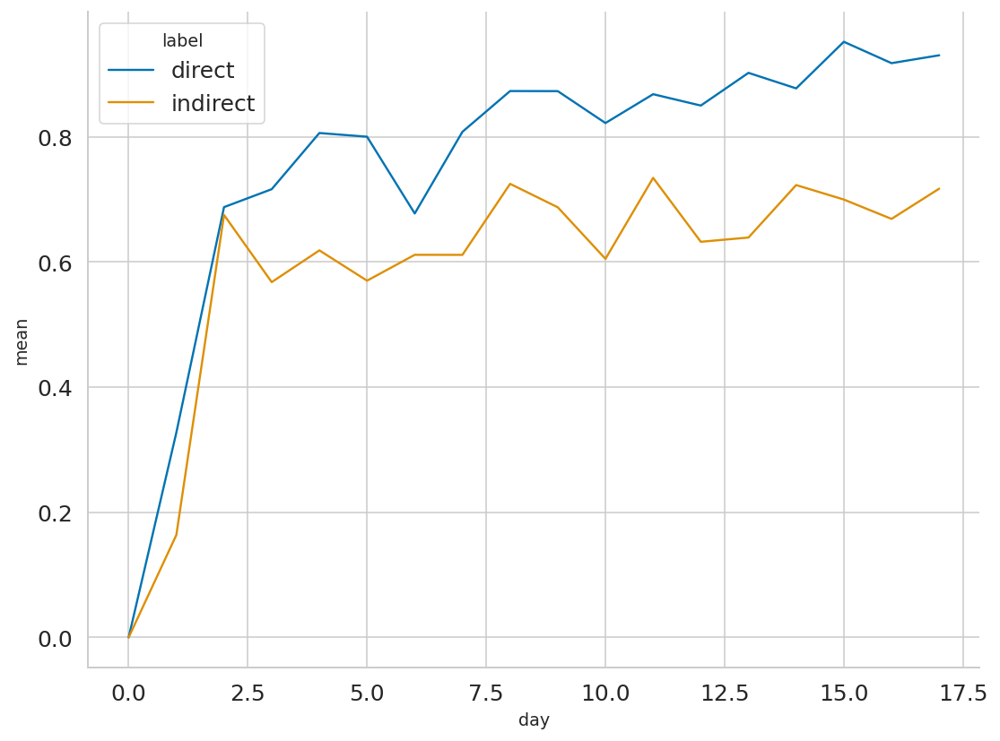

In [ ]:
sns.lineplot(data = r2, x= 'day',y ='mean',hue = 'label')

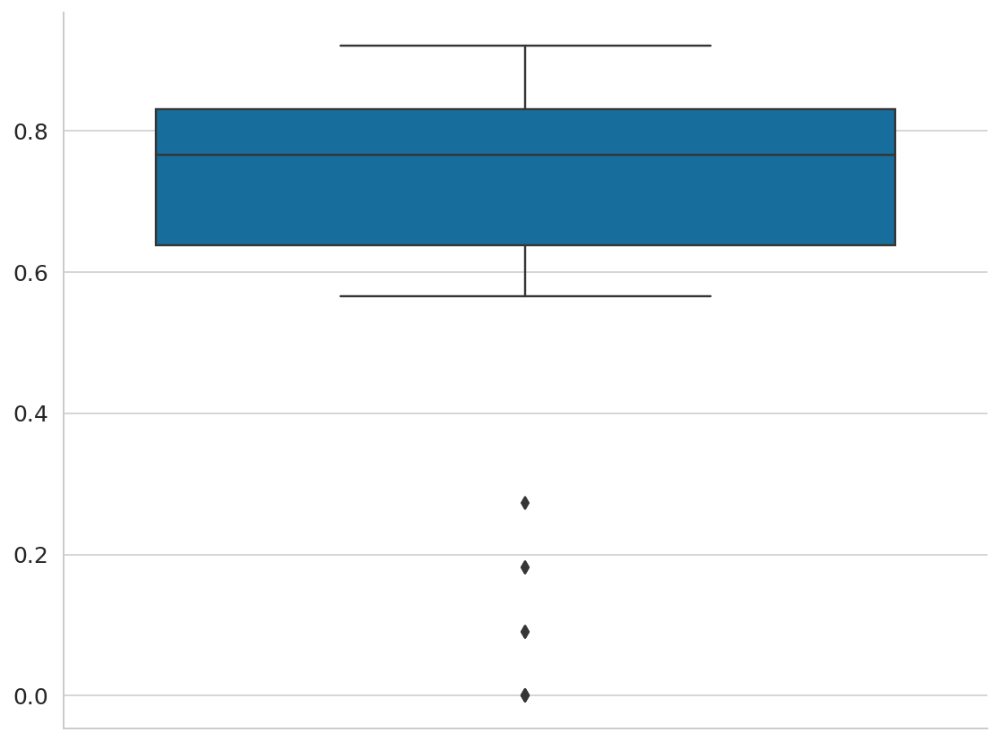

In [ ]:
# np.mean(r2_test, 1), np.std(r2_test,1)
sns.boxplot(y = r2_test )

In [ ]:
# r2_direct = r2
# r2_indirect = r2
# r2_direct_indirect = r2

In [ ]:
plt.plot(np.arange(18), r2_direct[:,1],'-b')
plt.plot(np.arange(18), r2_direct[:,1], 'b*')
plt.plot(np.arange(18), r2_indirect[:,1],'-g')
plt.plot(np.arange(18), r2_indirect[:,1],'g*')
plt.plot(np.arange(18), r2_direct_indirect[:,1],'-k')
plt.plot(np.arange(18), r2_direct_indirect[:,1],'k*')
plt.xlim(0,17)
plt.xlabel('Days')
plt.ylabel('Prediction Accuracy - R2')


In [ ]:
print(data_train.shape)
print(outcome_train.shape)

(8547, 78, 22)
(8547,)


In [ ]:
X = np.reshape(data_train, (np.shape(data_train)[0],-1))
print(X.shape)

(8547, 1716)


In [ ]:
from sklearn import linear_model

# Initializing a linear model 
my_linear_model = linear_model.LogisticRegression(penalty='l2', solver = 'lbfgs', max_iter = 10000,C = 0.001)

# Model fitting
my_linear_model.fit(X, outcome_train)

# R2 model fitting score
print("R2 was",my_linear_model.score(X,outcome_train))

R2 was 1.0


In [ ]:
new_X = np.reshape(data_test, (np.shape(data_test)[0],-1))
print("Test accuracy was",my_linear_model.score(new_X,outcome_test))

Test accuracy was 0.8800475059382423


In [ ]:
d_ind_bool = np.in1d(direct_indirect_idx,direct_idx_2)
print(direct_idx_2)
print(direct_indirect_idx)
print(d_ind_bool)
print(np.where(d_ind_bool== True))

[ 50  51  85 105 140 180 185 215 225 265 300 355 395 440 520 545 590 595
 610 635]
[  5   6  10  15  20  21  45  50  51  55  75  85  95 100 105 106 120 140
 145 175 176 180 181 185 195 196 210 215 220 221 225 230 235 236 240 260
 265 270 271 275 276 300 305 310 311 315 320 325 335 336 340 345 355 356
 360 365 370 395 440 480 520 530 531 535 536 540 545 546 550 560 590 595
 605 610 615 625 630 635]
[False False False False False False False  True  True False False  True
 False False  True False False  True False False False  True False  True
 False False False  True False False  True False False False False False
  True False False False False  True False False False False False False
 False False False False  True False False False False  True  True False
  True False False False False False  True False False False  True  True
 False  True False False False  True]
(array([ 7,  8, 11, 14, 17, 21, 23, 27, 30, 36, 41, 52, 57, 58, 60, 66, 70,
       71, 73, 77]),)


In [ ]:
my_linear_model.coef_[0].shape

(1716,)

In [ ]:
scores = []
all_X = np.reshape(neural_recordings, (np.shape(neural_recordings)[0],-1))

def get_test_train_splits(data, decisions, n_folds=5):
  """
  Returns a tuple of matched train sets and validation sets, rotating through the data.
  
  Note that there are scikit-learn functions that do this, too."""
  
  fold_size = len(data)//n_folds
  
  training_sets = [np.roll(data,fold_size*i, axis=0)[fold_size:] for i in range(n_folds)]
  val_sets = [np.roll(data,fold_size*i, axis=0)[:fold_size] for i in range(n_folds)]
  
  training_Y = [np.roll(decisions,fold_size*i, axis=0)[fold_size:] for i in range(n_folds)]
  val_Y = [np.roll(decisions,fold_size*i, axis=0)[:fold_size] for i in range(n_folds)]
  

  return (training_sets, training_Y), (val_sets, val_Y)

(training_sets, training_Ys), (val_sets, val_Ys) = get_test_train_splits(X, outcome_train)

print(np.shape(training_sets),np.shape(training_Ys), np.shape(val_sets),np.shape(val_Ys))

(5, 6838, 1716) (5, 6838) (5, 1709, 1716) (5, 1709)


(6838, 2184)
(6838,)
   Validation accuracy of 0.957284961966062
   True test set accuracy of 0.9572548088340062


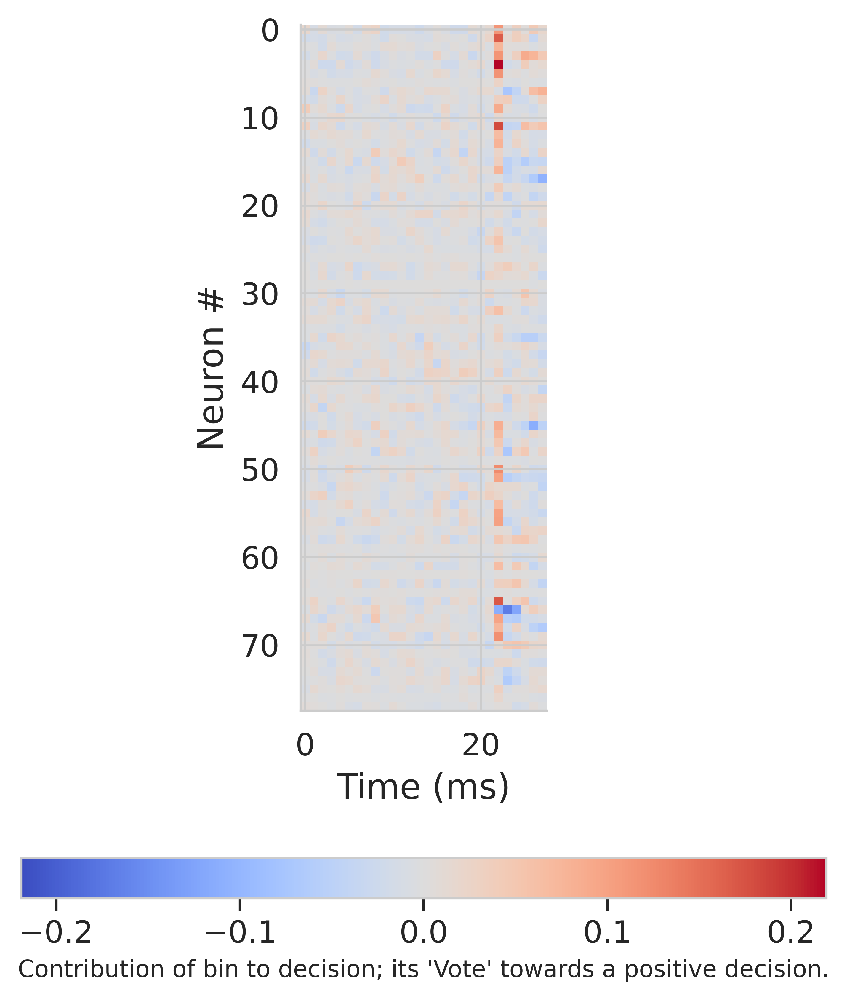

(6838, 2184)
(6838,)
   Validation accuracy of 0.9555295494441194
   True test set accuracy of 0.9574922821182617


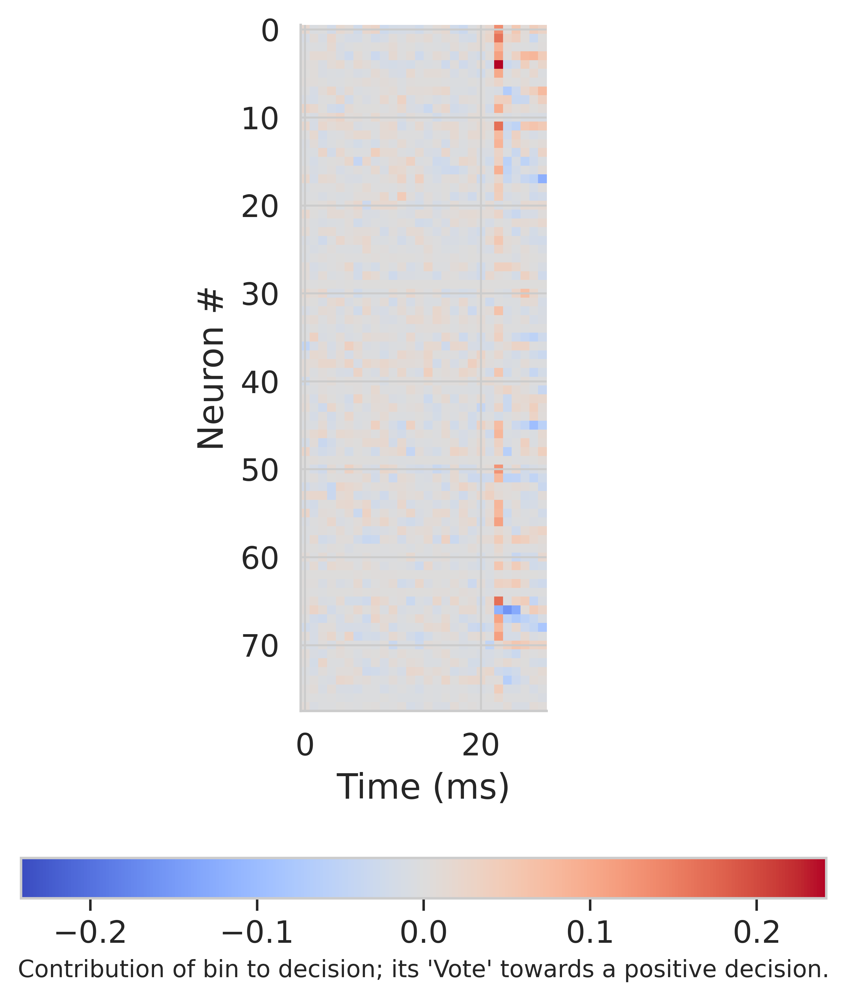

(6838, 2184)
(6838,)
   Validation accuracy of 0.9654768870684611
   True test set accuracy of 0.9560674424127286


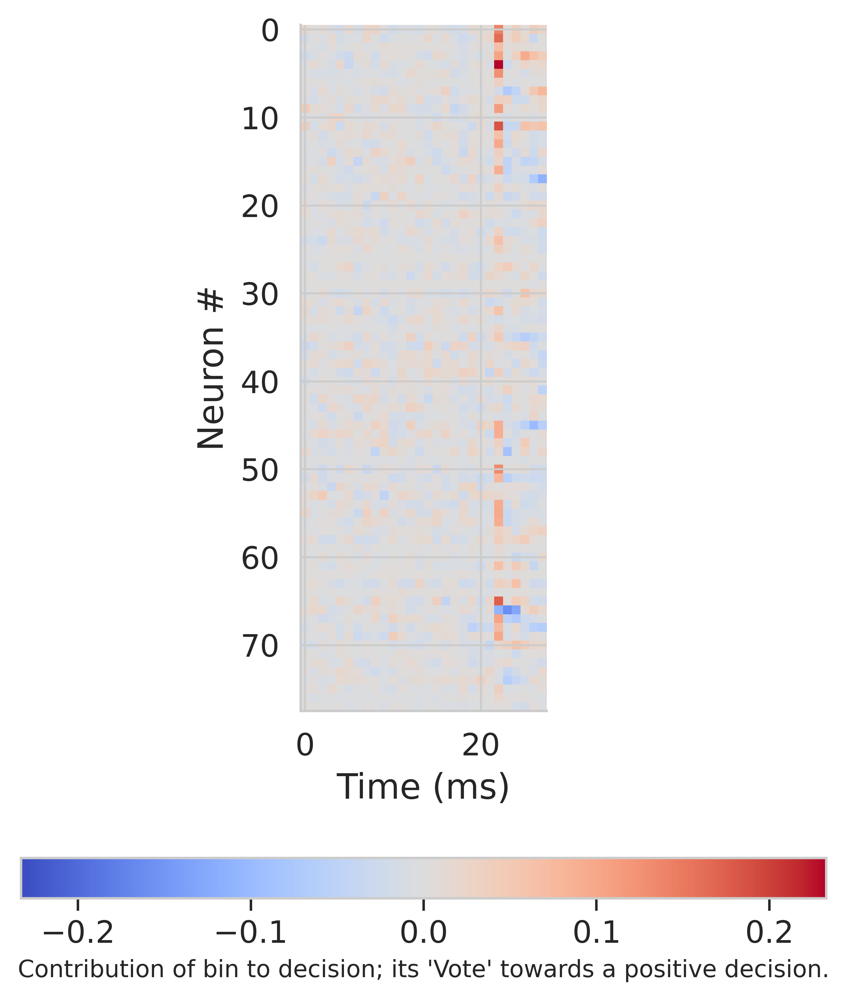

(6838, 2184)
(6838,)
   Validation accuracy of 0.9578700994733762
   True test set accuracy of 0.9596295416765613


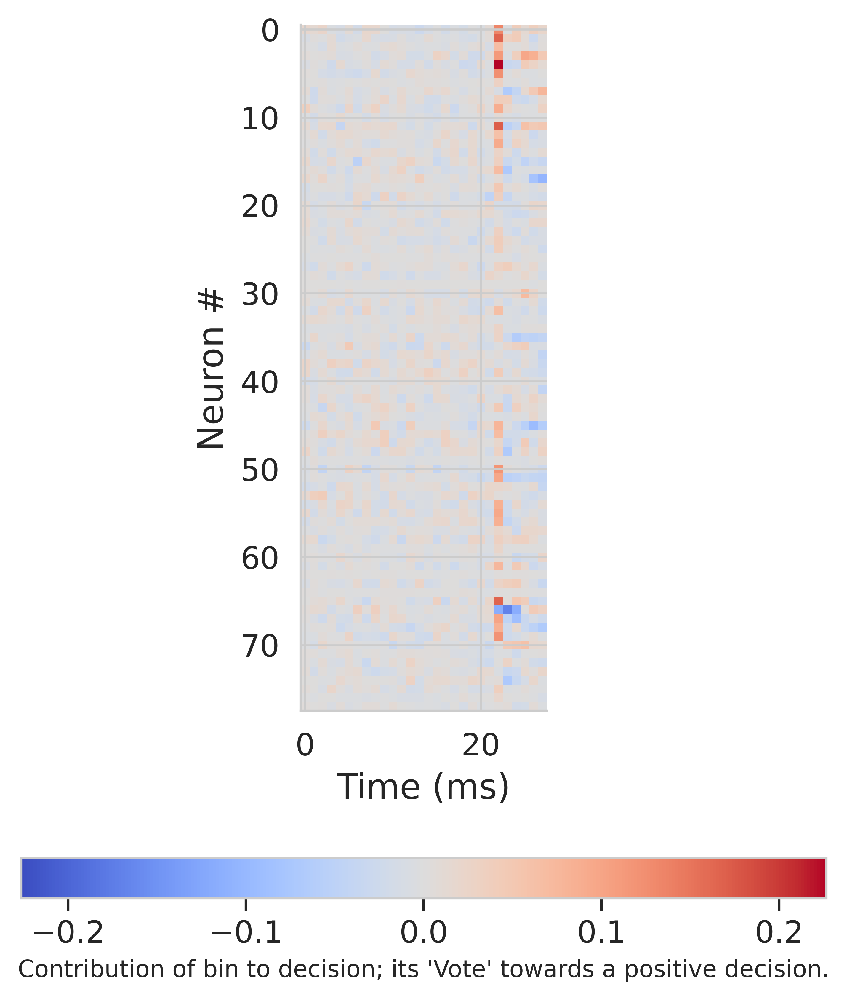

(6838, 2184)
(6838,)
   Validation accuracy of 0.9590403744880047
   True test set accuracy of 0.9570173355497507


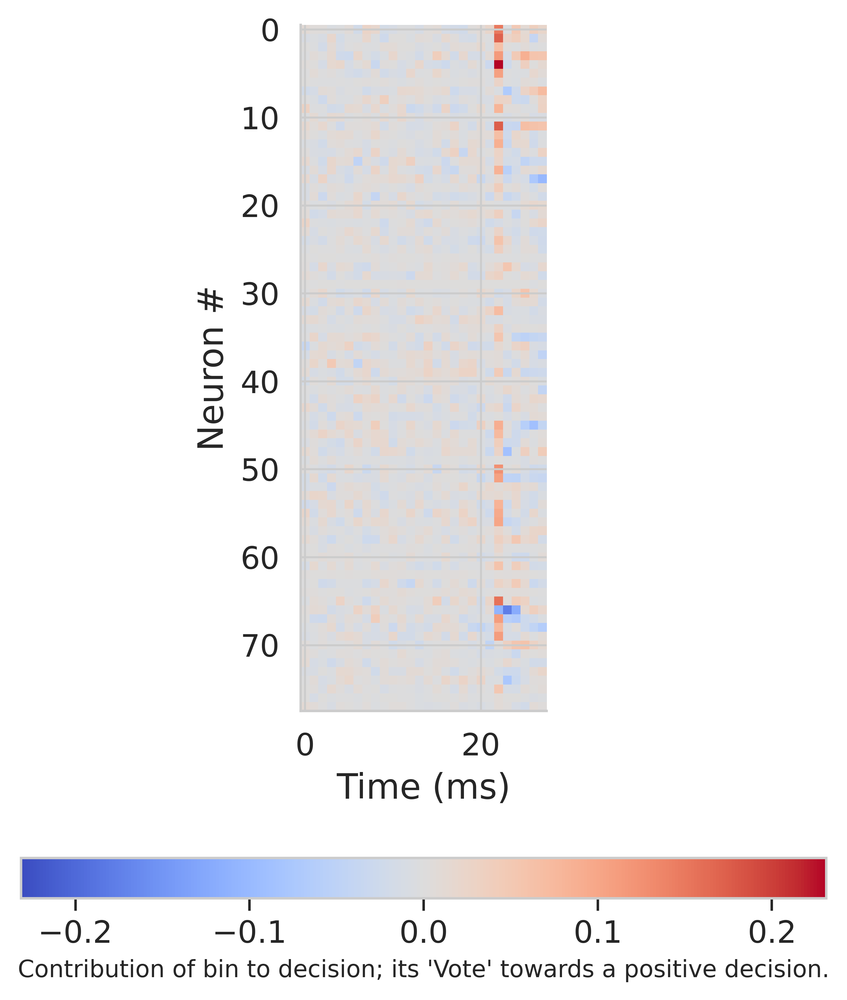

Mean validation accuracy: 0.9590403744880047


In [ ]:
# Iterate through the k=5 folds
for fold in range(5):
  
  training_X = training_sets[fold]
  print(np.shape(training_X))
  training_Y = training_Ys[fold]
  print(np.shape(training_Y))

  validation_X = val_sets[fold]
  validation_Y = val_Ys[fold]
  
  # Redefine the logistic regression model. (important to do this inside the loop)
  this_model = linear_model.LogisticRegression(penalty='l2', solver = 'lbfgs',
                                          max_iter = 10000,C = 0.01)
  
  # Now fit on the training data
  this_model.fit(training_X, training_Y)
  
  # score on the validation data
  this_accuracy = this_model.score(validation_X, validation_Y)
  
  scores.append(this_accuracy)
  
  # score on the new dataset (new_X, new_decisions from above)
  accuracy_on_test_data = this_model.score(new_X, outcome_test)
  
  print("   Validation accuracy of {}".format( this_accuracy ))
  print("   True test set accuracy of {}".format( accuracy_on_test_data ))
  plot_coefs(this_model, n_neurons, n_bins_per_trial)
  
print("Mean validation accuracy: {}".format(np.mean(scores)))

# Connectivity


In [98]:
#@ title Functions (RUN ME)

def correlation_for_all_neurons(X):
  """Computes the connectivity matrix for the all neurons using correlations

    Args:
        X: the matrix of activities

    Returns:
        estimated_connectivity (np.ndarray): estimated connectivity for the selected neuron, of shape (n_neurons,)
  """
  n_neurons = len(X)
  S = np.concatenate([X[:, 1:], X[:, :-1]], axis=0)
  R = np.corrcoef(S)[:n_neurons, n_neurons:]
  return R
  
def plot_connectivity_matrix(A, ax=None):
  """Plot the (weighted) connectivity matrix A as a heatmap
  
    Args:
      A (ndarray): connectivity matrix (n_neurons by n_neurons)
      ax: axis on which to display connectivity matrix
  """
  if ax is None:
    ax = plt.gca()
  lim = np.abs(A).max()
  # im = ax.imshow(A, vmin=-lim, vmax=lim, cmap="coolwarm")
  im = ax.imshow(A, vmin=-1, vmax=1, cmap="coolwarm")
  ax.tick_params(labelsize=10)
  ax.xaxis.label.set_size(15)
  ax.yaxis.label.set_size(15)
  cbar = ax.figure.colorbar(im, ax=ax, ticks=[0], shrink=.7)
  cbar.ax.set_ylabel("Connectivity Strength", rotation=90, 
                     labelpad= 20, va="bottom")
  ax.set(xlabel="Connectivity from", ylabel="Connectivity to")

def see_neurons(A, ax):
  """
  Visualizes the connectivity matrix.

  Args:
      A (np.ndarray): the connectivity matrix of shape (n_neurons, n_neurons)
      ax (plt.axis): the matplotlib axis to display on

  Returns:
      Nothing, but visualizes A.
  """
  A = A.T  # make up for opposite connectivity
  n = len(A)
  n_idx = np.arange(n)
  ax.set_aspect('equal')
  thetas = np.linspace(0, np.pi * 2, n, endpoint=False)
  thetas1 = np.linspace(0, np.pi * 2, n, endpoint=False)
  x, y = np.cos(thetas), np.sin(thetas),
  x1,y1 = np.cos(thetas1), np.sin(thetas1),
  ax.scatter(x, y, c='k', s=50)
  for i,txt in enumerate(n_idx):
    ax.annotate(txt, (x1[i], y1[i]))
  # g= ax.scatter(x, y, c=neuron_contribution_idx, cmap='Blues_r', s=50)
  # cbar = ax.figure.colorbar(g, ax=ax, ticks=[0], shrink=.7)
  A = A / A.max()
  # print(A.max())
  for i in range(n):
    for j in range(n):
      if A[i, j] > 0:
        # if is_direct[i]:
          # ax.arrow(x[i], y[i], x[j] - x[i], y[j] - y[i], color='b', alpha=A[i, j], head_width=.05,width = A[i,j] / 75, shape='right', length_includes_head=True)
        # else:
        ax.arrow(x[i], y[i], x[j] - x[i], y[j] - y[i], color='k', alpha=A[i, j], head_width=.05,width = A[i,j] / 75, shape='right', length_includes_head=True)     
      # print(A[i,j])
  ax.axis('off')


In [44]:
neuron_contribution_idx = get_contribution(coef_16, direct_indirect_idx_stacked)
is_direct = np.zeros_like(neuron_contribution_idx)
is_direct = neuron_contribution_idx<20
print(neuron_contribution_idx)
print(is_direct)

(545, 595, 635, 230, 520, 270, 215, 235, 610, 51, 300, 220, 335, 140, 590, 225, 395, 265, 546, 355, 540, 106, 315, 615, 356, 260, 440, 275, 180, 311, 105, 175, 305, 5, 340, 15, 310, 50, 185, 85, 370, 550, 236, 55, 360, 100, 20, 365, 320, 530, 560, 120, 195, 95, 145, 535, 10, 271, 630, 625, 605, 536, 531, 480, 345, 336, 325, 276, 240, 221, 210, 196, 181, 176, 75, 45, 21, 6)
[ 50  51  85 105 140 180 185 215 225 265 300 355 395 440 520 545 590 595
 610 635   5   6  10  15  20  21  45  55  75  95 100 106 120 145 175 176
 181 195 196 210 220 221 230 235 236 240 260 270 271 275 276 305 310 311
 315 320 325 335 336 340 345 356 360 365 370 480 530 531 535 536 540 546
 550 560 605 615 625 630]
[15. 17. 19. 42. 14. 47.  7. 43. 18.  1. 10. 40. 57.  4. 16.  8. 12.  9.
 71. 11. 70. 31. 54. 75. 61. 46. 13. 49.  5. 53.  3. 34. 51. 20. 59. 23.
 52.  0.  6.  2. 64. 72. 44. 27. 62. 30. 24. 63. 55. 66. 73. 32. 37. 29.
 33. 68. 22. 48. 77. 76. 74. 69. 67. 65. 60. 58. 56. 50. 45. 41. 39. 38.
 36. 35. 28. 2

In [ ]:
bmi_direct_indirect.shape

(13403, 78, 40)

## Day to Day connectivity change

In [58]:
bmi_direct2.shape

(13403, 20, 40)

In [75]:
def get_psth(data, label):
  n_neurons = np.shape(data)[1]
  n_trial = np.shape(data)[0]
  n_bins = np.shape(data)[2]

  psth = np.sum(data,axis = 0)

  fig = plt.figure(111)
  plt.plot(psth.T)
  plt.axvline(x=3,linewidth=2.5, color='r')
  plt.xlabel('Time Bin')
  plt.ylabel('Count')
  plt.text(1,np.min(psth)-5,'No. of neurons: '+str(n_neurons))
  plt.title('PSTH '+ label)
  f_psth = 'PSTH_'+ label+ '.png'
  plt.savefig(f_psth)
  plt.show()

/usr/local/lib/python3.6/dist-packages/numpy/lib/function_base.py:2534: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/usr/local/lib/python3.6/dist-packages/numpy/lib/function_base.py:2535: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


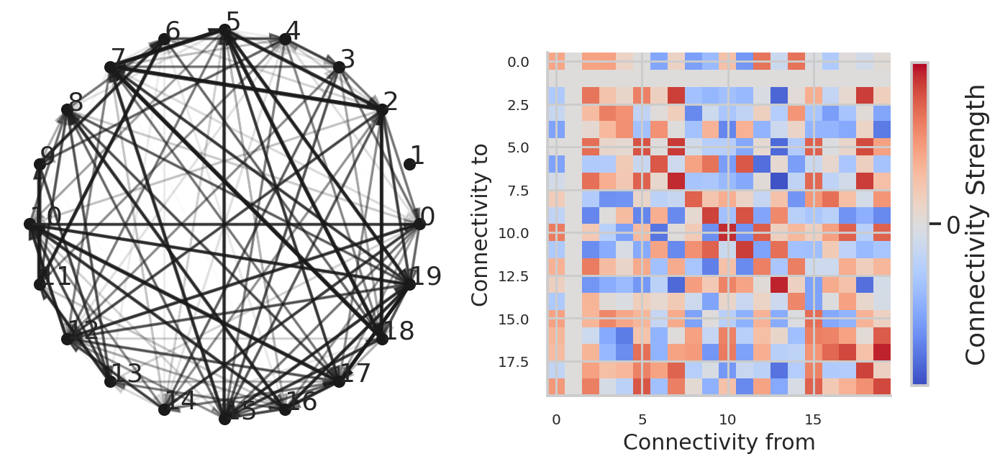

In [99]:
data_per_day = bmi_direct2[66:1014,:,:][:,:,17:38]

X_old = np.mean(data_per_day,0)
X = np.nan_to_num(X_old, copy = True)
ans = correlation_for_all_neurons(X)
A = np.nan_to_num(ans)
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
see_neurons(A,axs[0])
plot_connectivity_matrix(A, axs[1])

A_day2 = A
# get_psth(data_per_day,'day2')

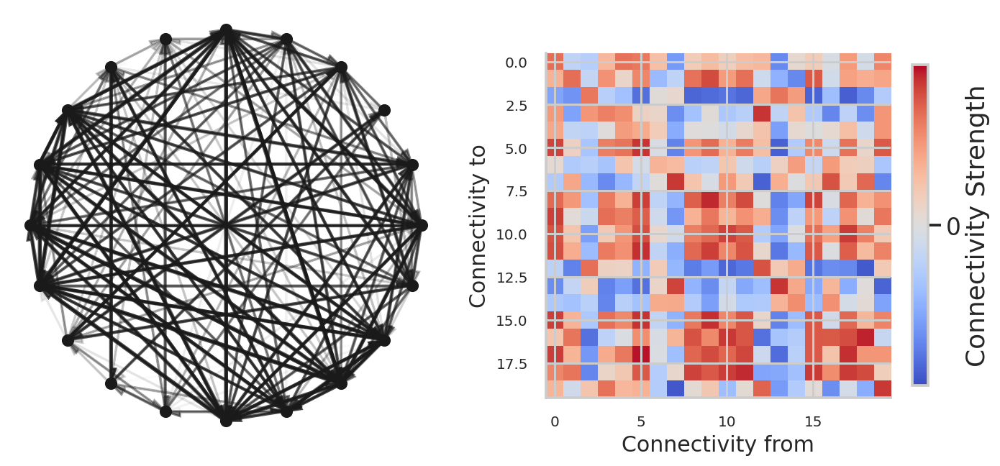

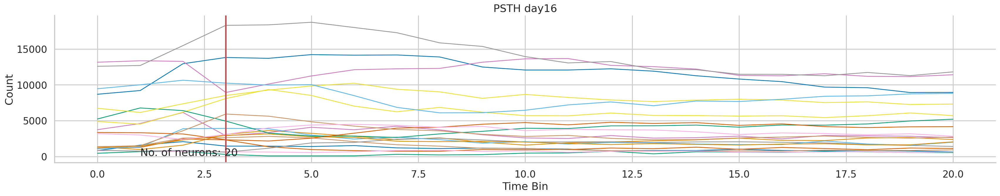

In [73]:
data_per_day = bmi_direct2[12293:12690,:,:][:,:,17:38]

X_old = np.mean(data_per_day,0)
X = np.nan_to_num(X_old, copy = True)
ans = correlation_for_all_neurons(X)
A = np.nan_to_num(ans)
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
see_neurons(A,axs[0])
plot_connectivity_matrix(A, axs[1])

A_day16 = A
get_psth(data_per_day,'day16')

1: 66, 2: 1015, 3: 1706, 4: 2736, 5: 3484, 6: 3804, 7: 4898, 8: 5954, 9: 7270, 10: 8086, 11: 9202, 12: 9963, 13: 10991, 14: 11430, 15: 12293, 16: 12690, 17: 13402

/usr/local/lib/python3.6/dist-packages/numpy/lib/function_base.py:2534: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/usr/local/lib/python3.6/dist-packages/numpy/lib/function_base.py:2535: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


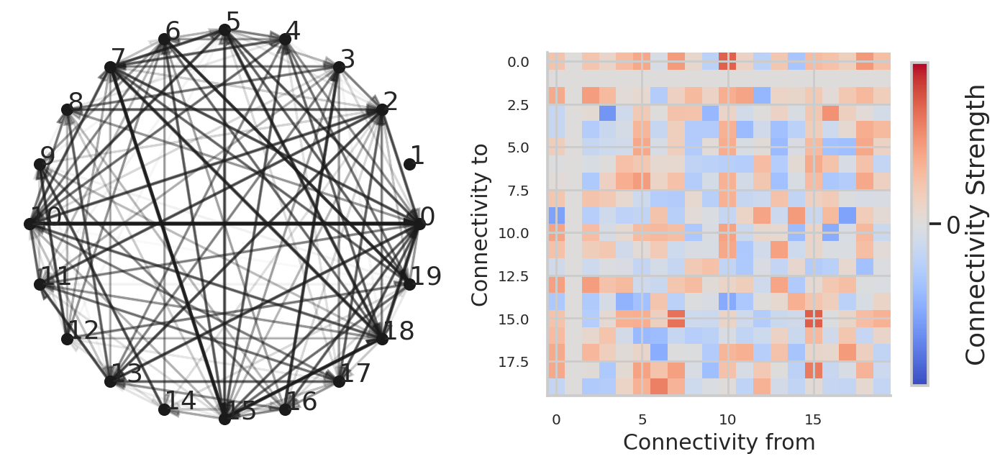

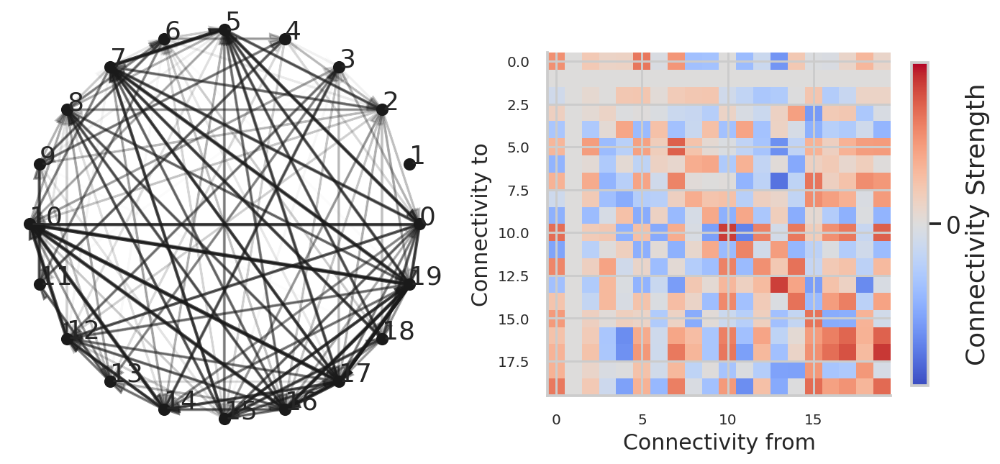

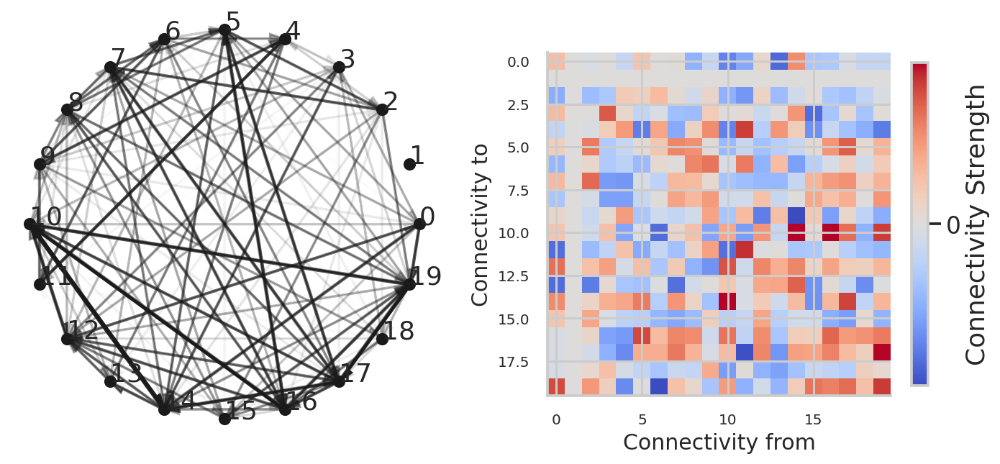

In [100]:
# 2_early vs late 

data_per_day = bmi_direct2[66:76,:,:][:,:,17:38]

X_old = np.mean(data_per_day,0)
X = np.nan_to_num(X_old, copy = True)
ans = correlation_for_all_neurons(X)
A = np.nan_to_num(ans)
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
see_neurons(A,axs[0])
plot_connectivity_matrix(A, axs[1])

A_day2_early = A
# get_psth(data_per_day,'day2_early')

data_per_day = bmi_direct2[914:1014,:,:][:,:,17:38]

X_old = np.mean(data_per_day,0)
X = np.nan_to_num(X_old, copy = True)
ans = correlation_for_all_neurons(X)
A = np.nan_to_num(ans)
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
see_neurons(A,axs[0])
plot_connectivity_matrix(A, axs[1])

A_day2_late = A
# get_psth(data_per_day,'day2_late')

A_diff = A_day2_late-A_day2_early
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
see_neurons(A_diff,axs[0])
plot_connectivity_matrix(A_diff, axs[1])

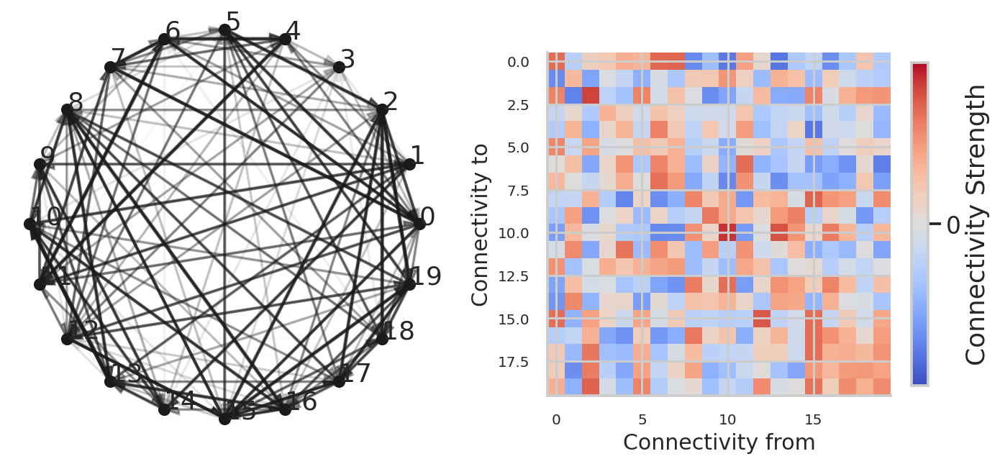

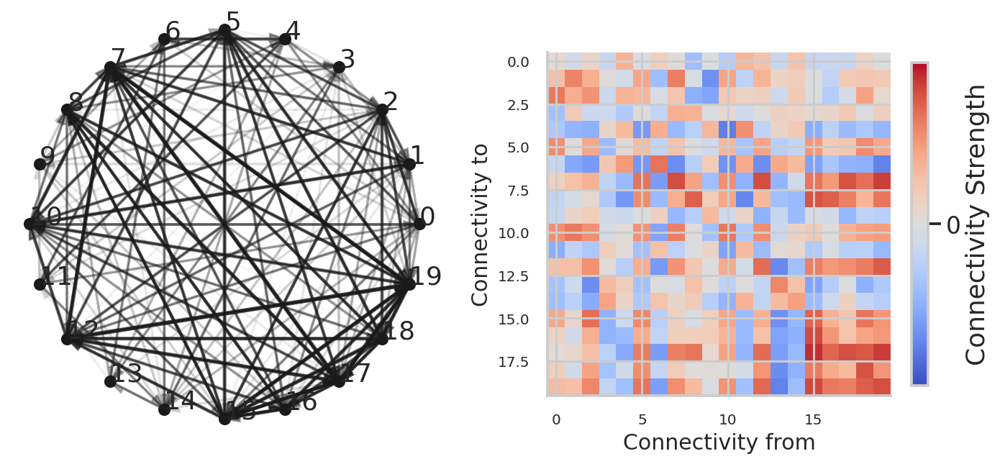

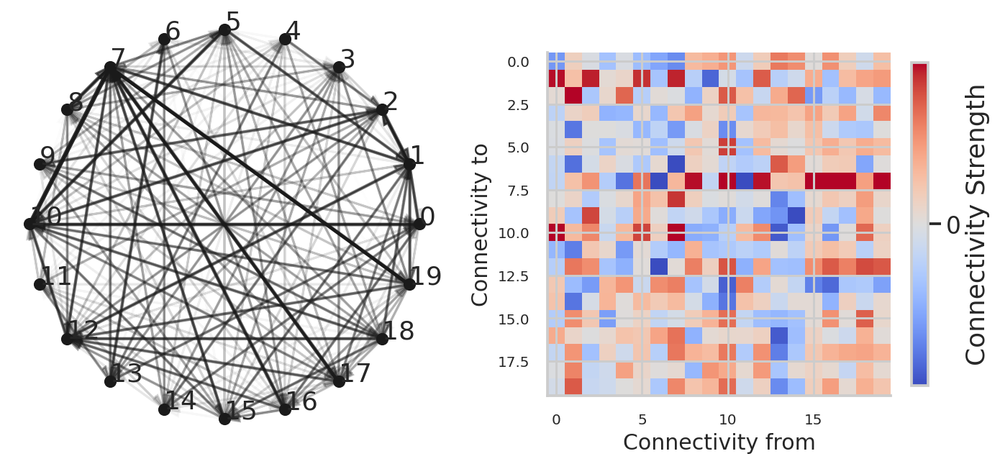

In [101]:
## Day 3 early vs Day 3 late 

data_per_day = bmi_direct2[1015:1115,:,:][:,:,17:38]

X_old = np.mean(data_per_day,0)
X = np.nan_to_num(X_old, copy = True)
ans = correlation_for_all_neurons(X)
A = np.nan_to_num(ans)
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
see_neurons(A,axs[0])
plot_connectivity_matrix(A, axs[1])

A_day3_early = A
# get_psth(data_per_day,'day3_early')

data_per_day = bmi_direct2[1606:1706,:,:][:,:,17:38]

X_old = np.mean(data_per_day,0)
X = np.nan_to_num(X_old, copy = True)
ans = correlation_for_all_neurons(X)
A = np.nan_to_num(ans)
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
see_neurons(A,axs[0])
plot_connectivity_matrix(A, axs[1])

A_day3_late = A
# get_psth(data_per_day,'day3_late')

A_diff = A_day3_late-A_day3_early
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
see_neurons(A_diff,axs[0])
plot_connectivity_matrix(A_diff, axs[1])

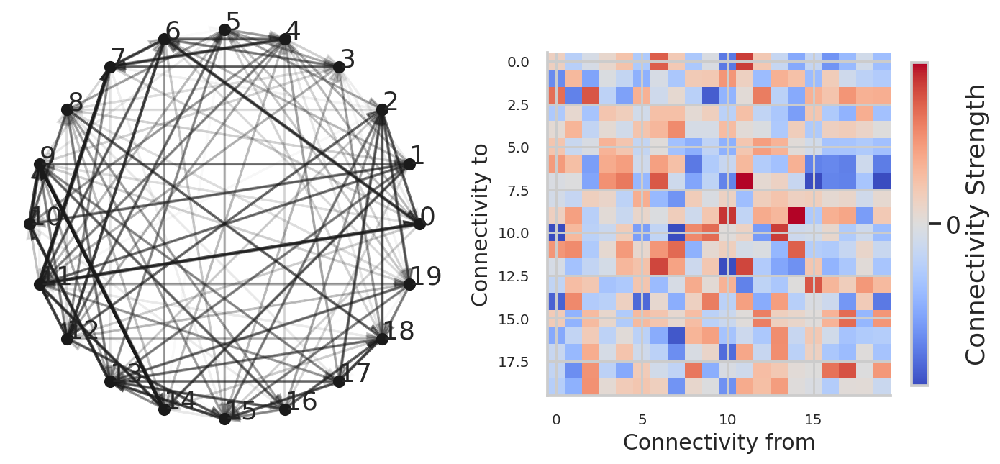

In [102]:
A_diff = A_day3_early-A_day2_late
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
see_neurons(A_diff,axs[0])
plot_connectivity_matrix(A_diff, axs[1])

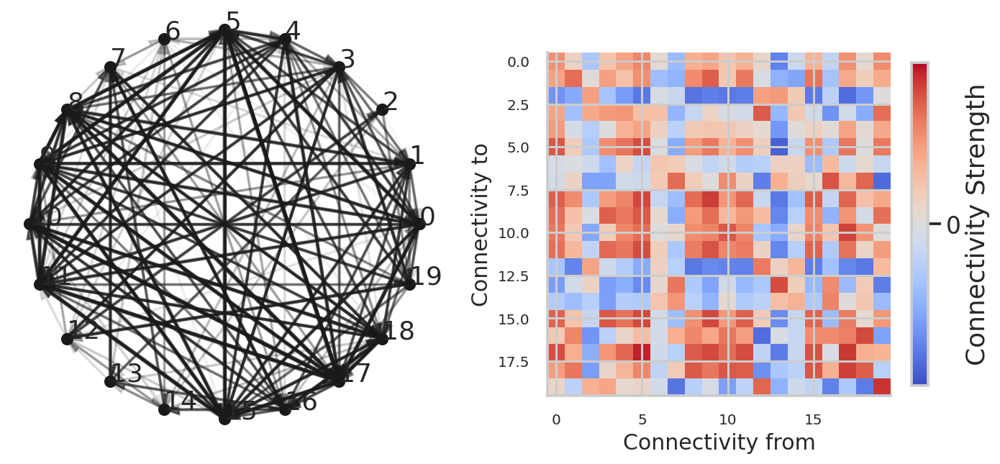

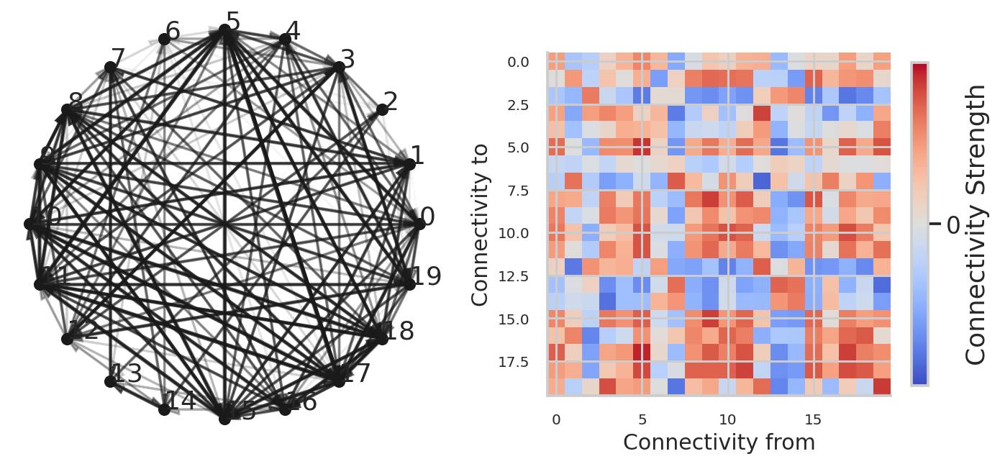

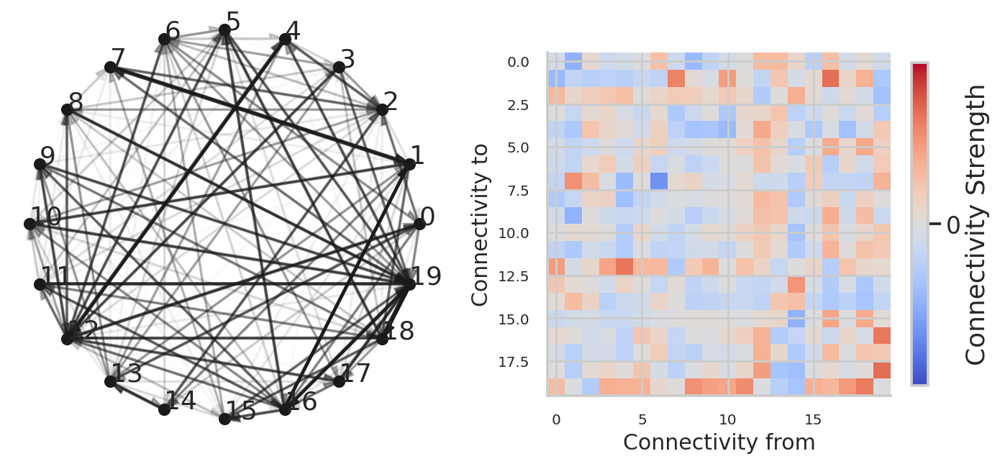

In [103]:
data_per_day = bmi_direct2[12293:12393,:,:][:,:,17:38]

X_old = np.mean(data_per_day,0)
X = np.nan_to_num(X_old, copy = True)
ans = correlation_for_all_neurons(X)
A = np.nan_to_num(ans)
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
see_neurons(A,axs[0])
plot_connectivity_matrix(A, axs[1])

A_day16_early = A

data_per_day = bmi_direct2[12590:12690,:,:][:,:,17:38]

X_old = np.mean(data_per_day,0)
X = np.nan_to_num(X_old, copy = True)
ans = correlation_for_all_neurons(X)
A = np.nan_to_num(ans)
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
see_neurons(A,axs[0])
plot_connectivity_matrix(A, axs[1])

A_day16_late = A
A_diff = A_day16_late-A_day16_early
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
see_neurons(A_diff,axs[0])
plot_connectivity_matrix(A_diff, axs[1])

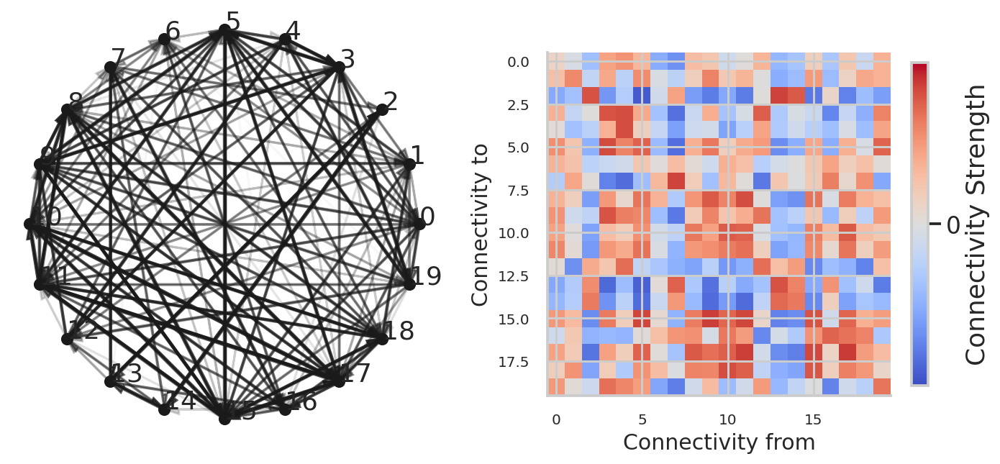

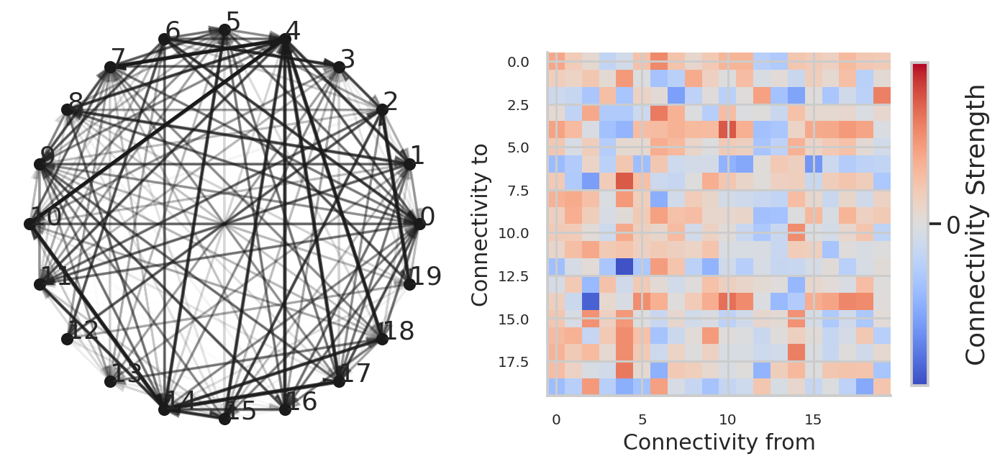

In [105]:
data_per_day = bmi_direct2[12193:12293,:,:][:,:,17:38]

X_old = np.mean(data_per_day,0)
X = np.nan_to_num(X_old, copy = True)
ans = correlation_for_all_neurons(X)
A = np.nan_to_num(ans)
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
see_neurons(A,axs[0])
plot_connectivity_matrix(A, axs[1])

A_day15_late = A

A_diff = A_day16_early-A_day15_late
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
see_neurons(A_diff,axs[0])
plot_connectivity_matrix(A_diff, axs[1])

## Color Coding based on linear model weights 

In [48]:
def see_neurons(A, ax, neuron_contribution_idx):
  """
  Visualizes the connectivity matrix.

  Args:
      A (np.ndarray): the connectivity matrix of shape (n_neurons, n_neurons)
      ax (plt.axis): the matplotlib axis to display on

  Returns:
      Nothing, but visualizes A.
  """
  A = A.T  # make up for opposite connectivity
  n = len(A)
  ax.set_aspect('equal')
  thetas = np.linspace(0, np.pi * 2, n, endpoint=False)
  x, y = np.cos(thetas), np.sin(thetas),
  # ax.scatter(x, y, c='k', s=50)
  g= ax.scatter(x, y, c=neuron_contribution_idx, cmap='Blues_r', s=50)
  cbar = ax.figure.colorbar(g, ax=ax, ticks=[0], shrink=.7)
  A = A / A.max()
  # print(A.max())
  for i in range(n):
    for j in range(n):
      if A[i, j] > 0:
        # if is_direct[i]:
          # ax.arrow(x[i], y[i], x[j] - x[i], y[j] - y[i], color='b', alpha=A[i, j], head_width=.05,width = A[i,j] / 75, shape='right', length_includes_head=True)
        # else:
        ax.arrow(x[i], y[i], x[j] - x[i], y[j] - y[i], color='k', alpha=A[i, j], head_width=.05,width = A[i,j] / 75, shape='right', length_includes_head=True)     
      # print(A[i,j])
  ax.axis('off')


(545, 595, 635, 230, 520, 270, 215, 235, 610, 51, 300, 220, 335, 140, 590, 225, 395, 265, 546, 355, 540, 106, 315, 615, 356, 260, 440, 275, 180, 311, 105, 175, 305, 5, 340, 15, 310, 50, 185, 85, 370, 550, 236, 55, 360, 100, 20, 365, 320, 530, 560, 120, 195, 95, 145, 535, 10, 271, 630, 625, 605, 536, 531, 480, 345, 336, 325, 276, 240, 221, 210, 196, 181, 176, 75, 45, 21, 6)
[ 50  51  85 105 140 180 185 215 225 265 300 355 395 440 520 545 590 595
 610 635   5   6  10  15  20  21  45  55  75  95 100 106 120 145 175 176
 181 195 196 210 220 221 230 235 236 240 260 270 271 275 276 305 310 311
 315 320 325 335 336 340 345 356 360 365 370 480 530 531 535 536 540 546
 550 560 605 615 625 630]
[15. 17. 19. 42. 14. 47.  7. 43. 18.  1. 10. 40. 57.  4. 16.  8. 12.  9.
 71. 11. 70. 31. 54. 75. 61. 46. 13. 49.  5. 53.  3. 34. 51. 20. 59. 23.
 52.  0.  6.  2. 64. 72. 44. 27. 62. 30. 24. 63. 55. 66. 73. 32. 37. 29.
 33. 68. 22. 48. 77. 76. 74. 69. 67. 65. 60. 58. 56. 50. 45. 41. 39. 38.
 36. 35. 28. 2

/usr/local/lib/python3.6/dist-packages/numpy/lib/function_base.py:2534: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/usr/local/lib/python3.6/dist-packages/numpy/lib/function_base.py:2535: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


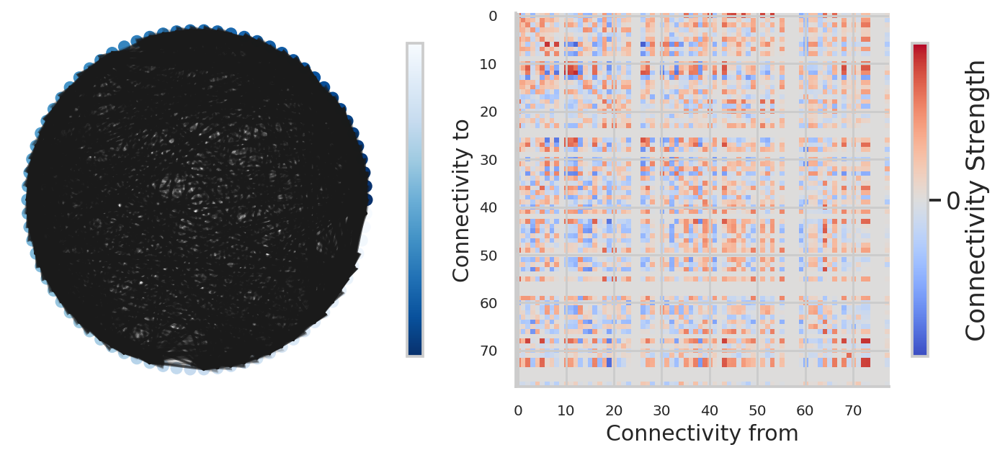

In [ ]:
# Day 2 - Direct Indirect stacked but reordered based on neuron contribution
neuron_contribution_idx = get_contribution(coef_16, direct_indirect_idx_stacked)
data_per_day = bmi_direct_indirect_stacked[66:1014,:,:][:,neuron_contribution_idx,:]

X_old = np.mean(data_per_day,0)
X = np.nan_to_num(X_old, copy = True)
ans = correlation_for_all_neurons(X)
A = np.nan_to_num(ans)
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
see_neurons(A,axs[0], np.arange(1,len(neuron_contribution_idx)+1,1))
plot_connectivity_matrix(A, axs[1])

A_day2 = A

In [ ]:
A.max()

0.9293409878583354

/usr/local/lib/python3.6/dist-packages/numpy/lib/function_base.py:2534: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/usr/local/lib/python3.6/dist-packages/numpy/lib/function_base.py:2535: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


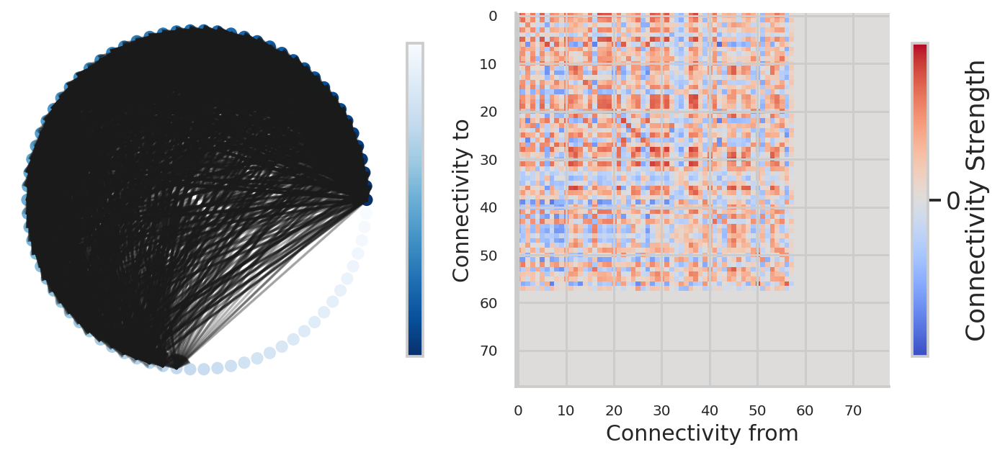

In [ ]:

# neuron_contribution_idx = get_contribution(coef_16, direct_indirect_idx_stacked)
data_per_day = bmi_direct_indirect_stacked[12293:12690,:,:][:,neuron_contribution_idx,:]

X_old = np.mean(data_per_day,0)
X = np.nan_to_num(X_old, copy = True)
ans = correlation_for_all_neurons(X)
A = np.nan_to_num(ans)
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
see_neurons(A,axs[0], np.arange(1,len(neuron_contribution_idx)+1,1))
plot_connectivity_matrix(A, axs[1])

A_day16 = A

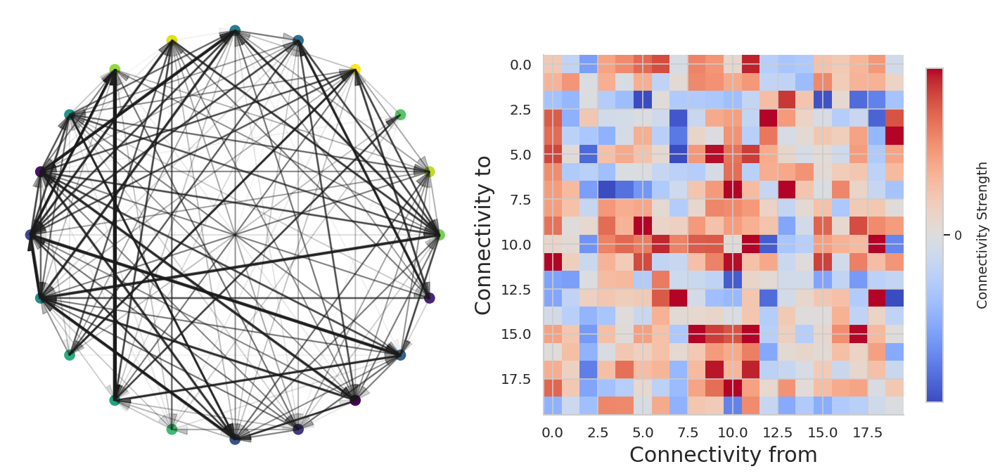

In [ ]:
A_diff = A_day16 - A_day2

fig, axs = plt.subplots(1, 2, figsize=(10, 5))
see_neurons(A_diff,axs[0], neuron_contribution_idx)
plot_connectivity_matrix(A_diff, axs[1])

/usr/local/lib/python3.6/dist-packages/numpy/lib/function_base.py:2534: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/usr/local/lib/python3.6/dist-packages/numpy/lib/function_base.py:2535: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


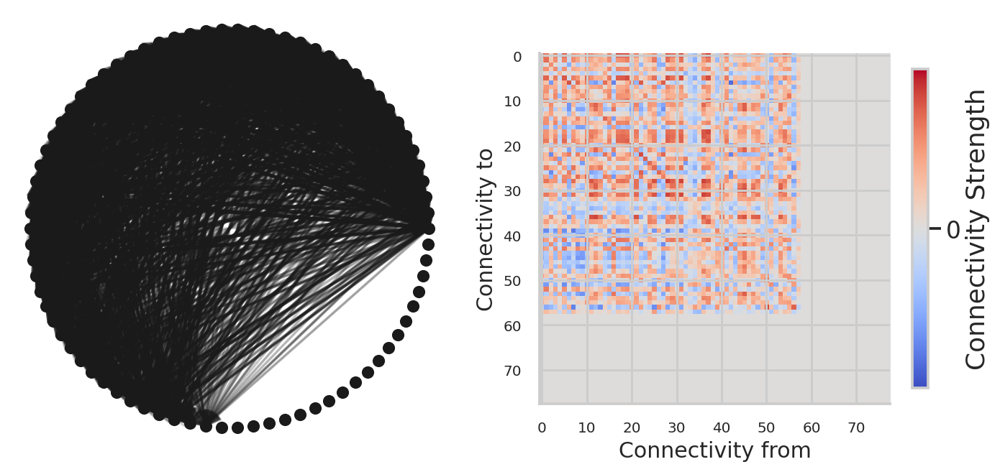

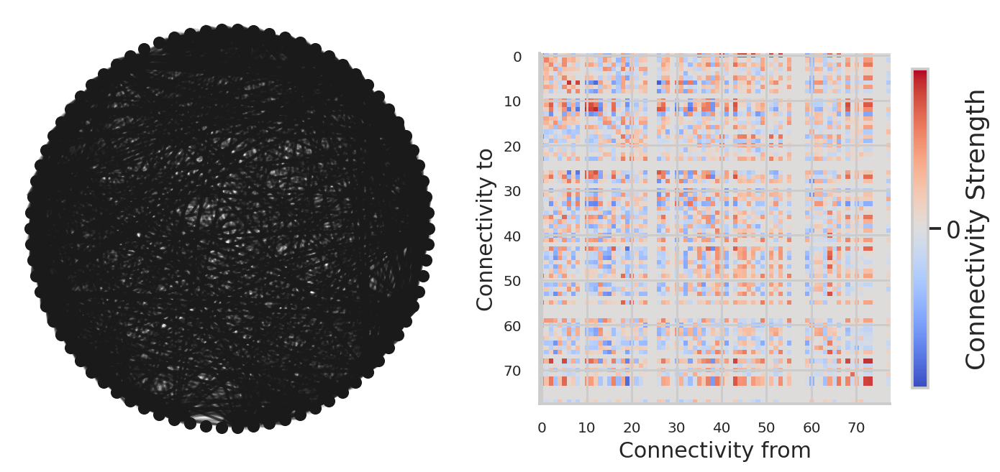

In [ ]:
# Reordering based on each neuron's contribution 

# data_per_day = bmi_direct_indirect_stacked[12293:12690,:,:][:,id.astype(int),:]
data_day16 = data_per_day = bmi_direct_indirect_stacked[12293:12690,:,:][:,neuron_contribution_idx.astype(int),:]
data_day2 = bmi_direct_indirect_stacked[66:1014,:,:][:,neuron_contribution_idx.astype(int),:]

def generate_connectivity_plot(data_per_day):
  X_old = np.mean(data_per_day,0)
  X = np.nan_to_num(X_old, copy = True)
  ans = correlation_for_all_neurons(X)
  A = np.nan_to_num(ans)
  fig, axs = plt.subplots(1, 2, figsize=(10, 5))
  see_neurons(A,axs[0])
  plot_connectivity_matrix(A, axs[1])
  return(A)

A_day16 = generate_connectivity_plot(data_day16)
A_day2 = generate_connectivity_plot(data_day2)

/usr/local/lib/python3.6/dist-packages/numpy/lib/function_base.py:2534: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/usr/local/lib/python3.6/dist-packages/numpy/lib/function_base.py:2535: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


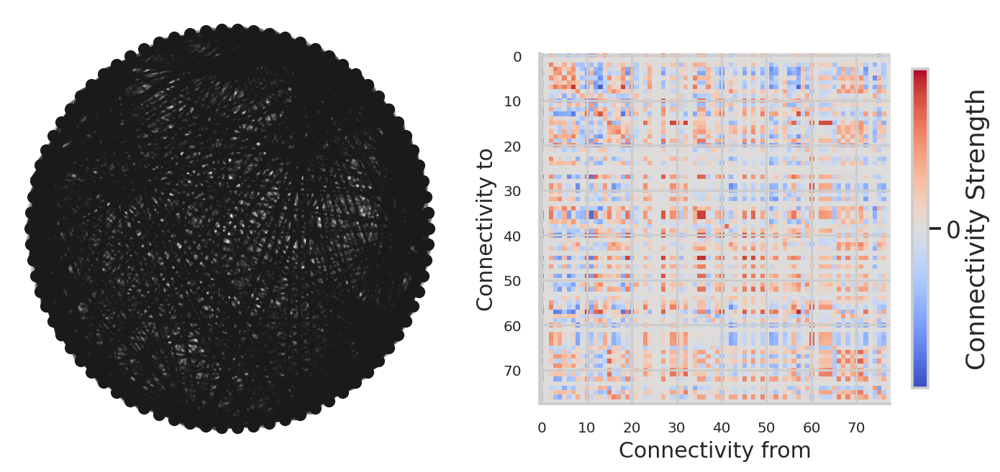

In [ ]:
A_day2 = generate_connectivity_plot(data_day2)

/usr/local/lib/python3.6/dist-packages/numpy/lib/function_base.py:2534: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/usr/local/lib/python3.6/dist-packages/numpy/lib/function_base.py:2535: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


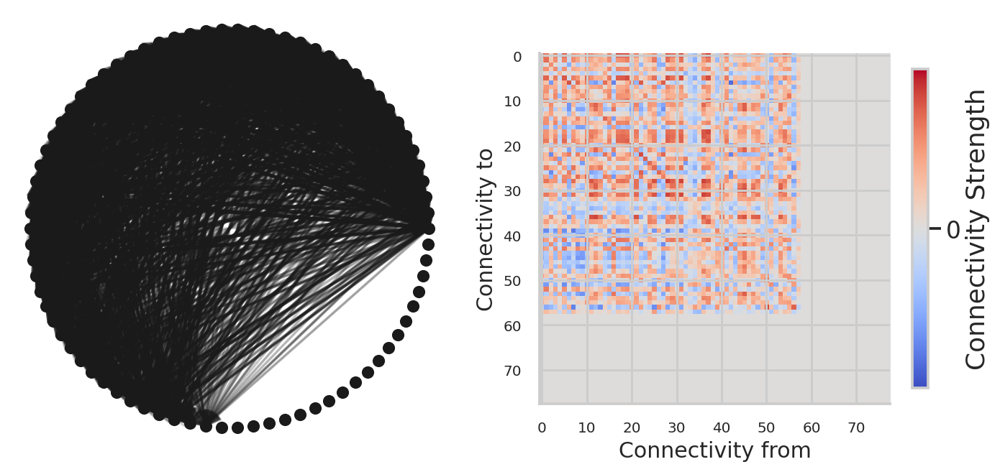

In [ ]:
data_day16 = data_per_day = bmi_direct_indirect_stacked[12293:12690,:,:][:,id.astype(int),:]
data_day2 = bmi_direct_indirect_stacked[66:1014,:,:][:,id.astype(int),:]
A_day16 = generate_connectivity_plot(data_day16)


/usr/local/lib/python3.6/dist-packages/numpy/lib/function_base.py:2534: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/usr/local/lib/python3.6/dist-packages/numpy/lib/function_base.py:2535: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


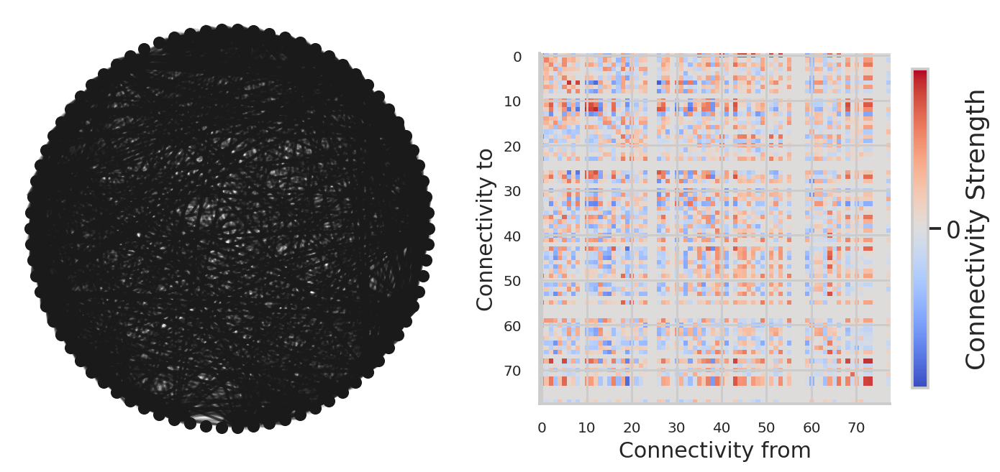

In [ ]:
A_day2 = generate_connectivity_plot(data_day2)

In [ ]:
from scipy import stats 

stats.kruskal(A_day2,A_day16)

KruskalResult(statistic=796294.6470583729, pvalue=0.0)

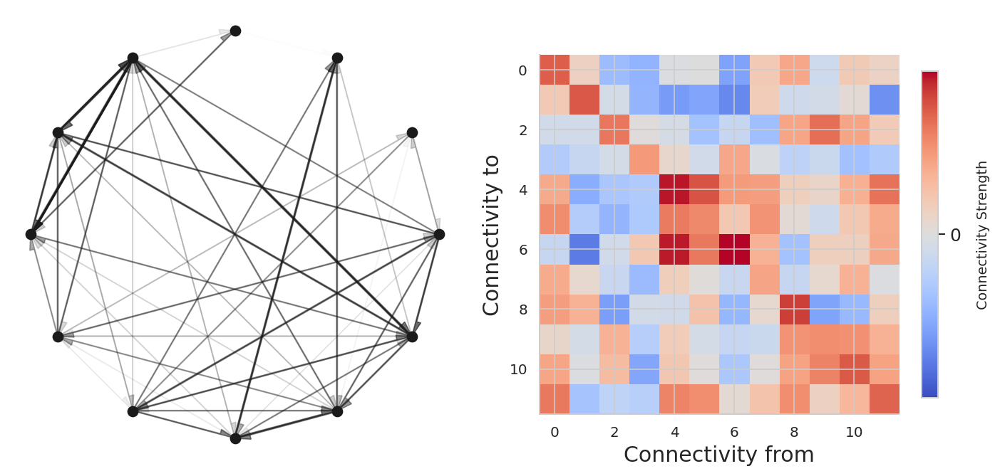

In [ ]:
data_per_day = bmi_direct1[66:1015,:,:]
X_old = np.mean(data_per_day,0)
X = np.nan_to_num(X_old, copy = True)
ans = correlation_for_all_neurons(X)
A = np.nan_to_num(ans)
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
see_neurons(A,axs[0])
plot_connectivity_matrix(A, axs[1])

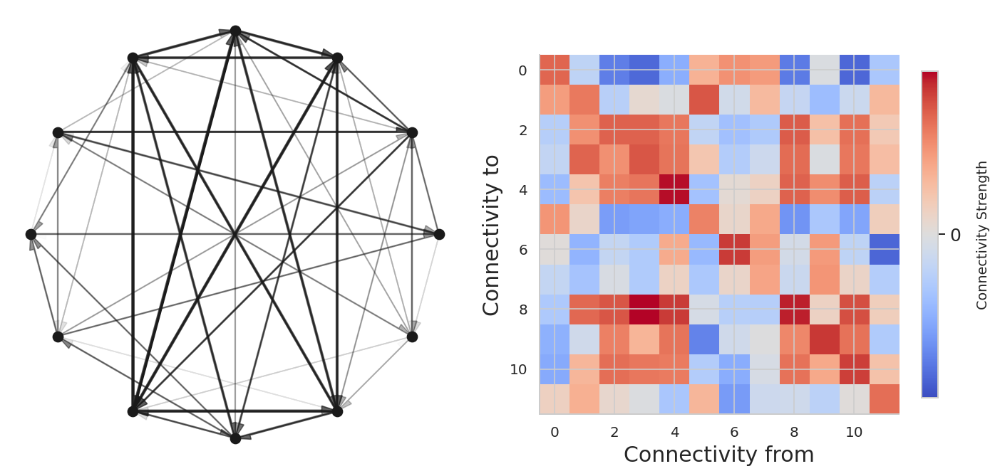

In [ ]:
data_per_day = bmi_direct1[12293:12690,:,:]
X_old = np.mean(data_per_day,0)
X = np.nan_to_num(X_old, copy = True)
ans = correlation_for_all_neurons(X)
A = np.nan_to_num(ans)
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
see_neurons(A,axs[0])
plot_connectivity_matrix(A, axs[1])